# ACTIVSg grid buildout Part2

#### grid buildouts for stochastic dispatch
* conda env: buildouts
* tamu 200 buildout entire pipeline
* functionality of adding of new generators
* start with all_cf_df.csv (created in part1) in run_dir from Part1



#### other helpful notebooks:

* generator/load analysis:
* /user/isatkaus/notebooks/projects/ecp/powerscenarios/notebooks/eagle_dev/tamu200_generator_connections.ipynb
* to generate scenarios using buildout grid use:
* buildout_scenarios_v2.ipynb

In [1]:
import os
from reV import TESTDATADIR
from reV.config.project_points import ProjectPoints
from reV.generation.generation import Gen

import numpy as np
import matplotlib.pyplot as plt
import json


import rex
from rex import Resource

import h5py
import glob

In [2]:
import pandas as pd
import numpy as np
import time
import os
import random

#### not using pywwtk anymore, using eaw wtk data instead
# # set PYWTK_CACHE_DIR to locate WIND Toolkit data
# # will download from AWS as needed
# os.environ["PYWTK_CACHE_DIR"] = os.path.join(os.environ["HOME"], "pywtk-data")

from powerscenarios.parser import Parser
from powerscenarios.grid import Grid

# show multiple cell outputs
from IPython.core.interactiveshell import InteractiveShell

InteractiveShell.ast_node_interactivity = "all"

pd.set_option("display.max_rows", 8)
pd.set_option("display.max_columns", 30)

# plotting (optional)
import cufflinks as cl

cl.go_offline()

In [3]:
# voronoi
from shapely.ops import cascaded_union, unary_union
from geovoronoi.plotting import subplot_for_map, plot_voronoi_polys_with_points_in_area
from geovoronoi import voronoi_regions_from_coords, points_to_coords

In [4]:
### packages for viz

import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt
import shapely

# same as above but using shapely.Point
from shapely.geometry import Point, LineString, Polygon

#### next extension-loading cells are optional
* autoreload: re-imports packages if package was changed (no need to restart kernel)
* nb_black/jupyter_black: autoformats code 

In [8]:
%load_ext autoreload

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [5]:
%load_ext nb_black

<IPython.core.display.Javascript object>

In [6]:
### for newer versions of notebook (v 7? or jupyter lab looking one)
# import black
# import jupyter_black

# # jupyter_black.load()

# jupyter_black.load(
#     lab=False,
#     line_length=79,
#     verbosity="DEBUG",
#     # target_version=black.TargetVersion.PY310,
# )

<IPython.core.display.Javascript object>

In [7]:
# %load_ext nb_black
# %load_ext jupyter_black

<IPython.core.display.Javascript object>


* Select grid
<a id='select_grid'></a>

[Capacity factors](#capacity_factors)

# load TAMU grid data

* choose TAMU grid
* grid files can be downloaded from:
* https://electricgrids.engr.tamu.edu/electric-grid-test-cases/

In [8]:
grid_name = "ACTIVSg200"  # TAMU 200 bus case
# grid_name = "ACTIVSg2000"  # TAMU 2000 bus case
# grid_name = 'ACTIVSg10k' # TAMU 10000 bus case

# path to .aux file (TAMU grids) obtained from e.g.
# https://electricgrids.engr.tamu.edu/electric-grid-test-cases/activsg200/
# data_dir = "../../data/grid-data/"
data_dir = "/projects/hpcapps/isatkaus/grid-buildouts-data/grid-data/"
# aux_file_name = data_dir + grid_name + "/" + grid_name + ".aux"
aux_file_name = os.path.join(data_dir, grid_name, grid_name + ".aux")

# parse original .aux file and return dataframes for buses, generators, and wind generators
# here, we need .aux files because those are the only ones with Latitute/Longitude information
parser = Parser()
bus_df, gen_df, wind_gen_df = parser.parse_tamu_aux(aux_file_name)

# see what you got
print("bus_df:")
bus_df
print("gen_df:")
gen_df
print("wind_gen_df:")
wind_gen_df

grid = Grid(grid_name, bus_df, gen_df, wind_gen_df)
grid
print(grid.info())


# branches
# m_filename = data_dir + "/grid-data/" + grid_name + "/case_" + grid_name + ".m"
m_filename = os.path.join(data_dir + grid_name + "/case_" + grid_name + ".m")

# read branch table from scenarios_m_file
table_name = "mpc.branch"
column_names = [
    "fbus",
    "tbus",
    "r",
    "x",
    "b",
    "rateA",
    "rateB",
    "rateC",
    "ratio",
    "angle",
    "status",
    "angmin",
    "angmax",
    "Pf",
    "Qf",
    "Pt",
    "Qt",
    "mu_Sf",
    "mu_St",
    "mu_angmin",
    "mu_angmax",
]

# this table is entirely numeric
numeric_columns = column_names

branch_df = parser.read_m_table(
    m_filename,
    table_name=table_name,
    column_names=column_names,
    numeric_columns=numeric_columns,
)


# rename a few columns to match branch drawing script
branch_df.index.rename("UID", inplace=True)
branch_df.rename(columns={"fbus": "FromBus", "tbus": "ToBus"}, inplace=True)
print("\nbranch_df")
branch_df


# ############usts data
# usts_data_dir = "/Users/isatkaus/projects/ecp/powerscenarios/data/grid-data/USATestSystem/formatted/"

# filename = os.path.join(usts_data_dir, "branch.csv")
# branch_df = pd.read_csv(filename, index_col=0)
# print("\nbranch_df")
# branch_df

bus_df:


,BusNum,BusName,Latitude,Longitude,Zone
0,1,CREVECOEUR0,40.642116,-89.599560,2
1,2,CREVECOEUR1,40.642116,-89.599560,2
2,3,ILLIOPOLIS0,39.866030,-89.251291,4
3,4,ILLIOPOLIS1,39.866030,-89.251291,4
...,...,...,...,...,...
196,197,GIBSONCITY12,40.470500,-88.398700,6
197,198,MAPLETON0,40.556403,-89.762073,2
198,199,GIFFORD0,40.306027,-87.958606,6
199,200,PETERSBURG0,40.169931,-89.986537,4


gen_df:


,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone
0,49,1,4.530000,1.360000,1.0,Coal,49_Coal_1,RANTOUL21,40.312222,-88.159444,6
1,50,1,4.530000,1.360000,1.0,Coal,50_Coal_1,RANTOUL22,40.312222,-88.159444,6
2,51,1,4.530000,1.360000,1.0,Coal,51_Coal_1,RANTOUL23,40.312222,-88.159444,6
3,52,1,4.530000,1.360000,1.0,Coal,52_Coal_1,RANTOUL24,40.312222,-88.159444,6
...,...,...,...,...,...,...,...,...,...,...,...
45,183,1,26.600000,7.980000,1.0,Coal,183_Coal_1,SPRINGFIELD22,39.806868,-89.641653,4
46,189,1,569.150019,170.749998,1.0,Nuclear,189_Nuclear_1,CLINTON12,40.171900,-88.833900,7
47,196,1,67.500001,20.250000,1.0,NaturalGas,196_NaturalGas_1,GIBSONCITY11,40.470500,-88.398700,6
48,197,1,67.500001,20.250000,1.0,NaturalGas,197_NaturalGas_1,GIBSONCITY12,40.470500,-88.398700,6


wind_gen_df:


,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone
0,65,1,150.399995,45.120001,1.0,Wind,65_Wind_1,PAXTON11,40.46405,-88.021517,6
1,104,1,99.000001,29.699999,1.0,Wind,104_Wind_1,ELLSWORTH12,40.47920,-88.798900,7
2,105,1,198.000002,59.400004,1.0,Wind,105_Wind_1,ELLSWORTH13,40.47920,-88.798900,7
3,114,1,1.700000,0.510000,1.0,Wind,114_Wind_1,NORMAL22,40.53700,-89.019000,7
4,115,1,150.000000,44.999999,1.0,Wind,115_Wind_1,NORMAL23,40.53700,-89.019000,7
5,147,1,100.500000,30.149999,1.0,Wind,147_Wind_1,HOPEDALE21,40.36920,-89.402200,7


Grid(name=ACTIVSg200, buses=200, generators=49, wind_generators=6, wind_sites=0)


ACTIVSg200 grid info: 

 number of buses: 200
 number of generators: 49
 number of wind generators: 6
 number of solar generators: 0
 total generator capacity: 3602.84 MW
 wind capacity/penetration: 699.60 MW / 19.42%
 solar capacity/penetration: 0.00 MW / 0.00%

branch_df


,FromBus,ToBus,r,x,b,rateA,rateB,rateC,ratio,angle,status,angmin,angmax,Pf,Qf,Pt,Qt,mu_Sf,mu_St,mu_angmin,mu_angmax
UID,,,,,,,,,,,,,,,,,,,,,
0,2,1,0.000673,0.003339,0.00000,100.0,0,0,0,0,1,0,0,-7.39,-2.10,7.39,2.11,0.0,0.0,0.0,0.0
1,1,119,0.018542,0.119758,0.02285,221.1,0,0,0,0,1,0,0,12.25,-0.57,-12.22,-1.63,0.0,0.0,0.0,0.0
2,124,1,0.005615,0.036268,0.00692,221.1,0,0,0,0,1,0,0,40.13,7.94,-40.04,-8.08,0.0,0.0,0.0,0.0
3,193,1,0.004258,0.027501,0.00525,221.1,0,0,0,0,1,0,0,-20.39,-6.96,20.41,6.54,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241,188,187,0.001394,0.044762,0.00000,400.0,0,0,1,0,1,0,0,-113.10,8.78,113.27,-3.48,0.0,0.0,0.0,0.0
242,189,187,0.000300,0.007815,0.00000,740.0,0,0,1,0,1,0,0,384.37,-24.15,-383.96,34.87,0.0,0.0,0.0,0.0
243,196,195,0.002850,0.060038,0.00000,87.7,0,0,1,0,1,0,0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0
244,197,195,0.002850,0.191484,0.00000,87.7,0,0,1,0,1,0,0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0


<IPython.core.display.Javascript object>

# remove old wind gens from original grid data
* save original data for later comparison
* remove existing wind gens from original grid - start from scratch
* will modify bus_df, gen_df, branch_df: add new buses, gens, branches
* will create new wind_gen_df

In [8]:
old_bus_df = bus_df.copy()
old_gen_df = gen_df.copy()
old_wind_gen_df = wind_gen_df.copy()
old_branch_df = branch_df.copy()

In [9]:
#################################################
#### remove old wind gen buses
#### re-number

old_bus_df
df = old_bus_df.copy()
df = df.set_index("BusNum", drop=True)

wind_gen_buses = old_gen_df.loc[gen_df["GenFuelType"] == "Wind"]["BusNum"]
wind_gen_buses.values

df.drop(wind_gen_buses.values, inplace=True)

### add new numbering starting with 1
df["NewBusNum"] = range(1, len(df) + 1)

### create map: old to new bus numbers (index=old, values=new)
bus_map_s = df["NewBusNum"]
print("\n bus number map series(old to new), bus_map")
bus_map_s

### set new index
df.set_index("NewBusNum", inplace=True)

bus_df = df.reset_index()
bus_df.rename(columns={"NewBusNum": "BusNum"}, inplace=True)
print("\n new bus_df:")
# df
bus_df

#################################################
#### remove old wind gen bus branches
#### map old BusNum in FromBus/ToBus columns to new bus numbers
old_branch_df
df = old_branch_df.copy()
### branches to remove
remove_idxs = df.loc[
    (df["FromBus"].isin(wind_gen_buses)) | (df["ToBus"].isin(wind_gen_buses))
].index
df.drop(remove_idxs, inplace=True)
print("\n removed branches: empty df?")
df.loc[df["FromBus"].isin(wind_gen_buses)]

### remap BusNum
df["FromBus"] = df["FromBus"].map(bus_map_s)
df["ToBus"] = df["ToBus"].map(bus_map_s)

### reset UID index
df.reset_index(inplace=True, drop=True)
df.index.name = "UID"

print("\n new branch_df:")
branch_df = df
branch_df

#################################################
#### remove old wind gen fron gen df
#### map old BusNum in FromBus/ToBus columns to new bus numbers
old_gen_df
df = old_gen_df.copy()
### gens to remove

remove_idxs = df.loc[df["BusNum"].isin(wind_gen_buses)].index
remove_idxs

df.drop(remove_idxs, inplace=True)
print("\n removed branches: empty df?")
df.loc[df["BusNum"].isin(wind_gen_buses)]

### remap BusNum
df["BusNum"] = df["BusNum"].map(bus_map_s)

### reset UID index
df.reset_index(inplace=True, drop=True)
# df.index.name = "UID"

print("\n new gen_df:")
gen_df = df
gen_df

,BusNum,BusName,Latitude,Longitude,Zone
0,1,CREVECOEUR0,40.642116,-89.599560,2
1,2,CREVECOEUR1,40.642116,-89.599560,2
2,3,ILLIOPOLIS0,39.866030,-89.251291,4
3,4,ILLIOPOLIS1,39.866030,-89.251291,4
...,...,...,...,...,...
196,197,GIBSONCITY12,40.470500,-88.398700,6
197,198,MAPLETON0,40.556403,-89.762073,2
198,199,GIFFORD0,40.306027,-87.958606,6
199,200,PETERSBURG0,40.169931,-89.986537,4


array([ 65, 104, 105, 114, 115, 147])


 bus number map series(old to new), bus_map


BusNum
1        1
2        2
3        3
4        4
      ... 
197    191
198    192
199    193
200    194
Name: NewBusNum, Length: 194, dtype: int64


 new bus_df:


,BusNum,BusName,Latitude,Longitude,Zone
0,1,CREVECOEUR0,40.642116,-89.599560,2
1,2,CREVECOEUR1,40.642116,-89.599560,2
2,3,ILLIOPOLIS0,39.866030,-89.251291,4
3,4,ILLIOPOLIS1,39.866030,-89.251291,4
...,...,...,...,...,...
190,191,GIBSONCITY12,40.470500,-88.398700,6
191,192,MAPLETON0,40.556403,-89.762073,2
192,193,GIFFORD0,40.306027,-87.958606,6
193,194,PETERSBURG0,40.169931,-89.986537,4


,FromBus,ToBus,r,x,b,rateA,rateB,rateC,ratio,angle,status,angmin,angmax,Pf,Qf,Pt,Qt,mu_Sf,mu_St,mu_angmin,mu_angmax
UID,,,,,,,,,,,,,,,,,,,,,
0,2,1,0.000673,0.003339,0.00000,100.0,0,0,0,0,1,0,0,-7.39,-2.10,7.39,2.11,0.0,0.0,0.0,0.0
1,1,119,0.018542,0.119758,0.02285,221.1,0,0,0,0,1,0,0,12.25,-0.57,-12.22,-1.63,0.0,0.0,0.0,0.0
2,124,1,0.005615,0.036268,0.00692,221.1,0,0,0,0,1,0,0,40.13,7.94,-40.04,-8.08,0.0,0.0,0.0,0.0
3,193,1,0.004258,0.027501,0.00525,221.1,0,0,0,0,1,0,0,-20.39,-6.96,20.41,6.54,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241,188,187,0.001394,0.044762,0.00000,400.0,0,0,1,0,1,0,0,-113.10,8.78,113.27,-3.48,0.0,0.0,0.0,0.0
242,189,187,0.000300,0.007815,0.00000,740.0,0,0,1,0,1,0,0,384.37,-24.15,-383.96,34.87,0.0,0.0,0.0,0.0
243,196,195,0.002850,0.060038,0.00000,87.7,0,0,1,0,1,0,0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0
244,197,195,0.002850,0.191484,0.00000,87.7,0,0,1,0,1,0,0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0



 removed branches: empty df?


,FromBus,ToBus,r,x,b,rateA,rateB,rateC,ratio,angle,status,angmin,angmax,Pf,Qf,Pt,Qt,mu_Sf,mu_St,mu_angmin,mu_angmax
UID,,,,,,,,,,,,,,,,,,,,,



 new branch_df:


,FromBus,ToBus,r,x,b,rateA,rateB,rateC,ratio,angle,status,angmin,angmax,Pf,Qf,Pt,Qt,mu_Sf,mu_St,mu_angmin,mu_angmax
UID,,,,,,,,,,,,,,,,,,,,,
0,2,1,0.000673,0.003339,0.00000,100.0,0,0,0,0,1,0,0,-7.39,-2.10,7.39,2.11,0.0,0.0,0.0,0.0
1,1,114,0.018542,0.119758,0.02285,221.1,0,0,0,0,1,0,0,12.25,-0.57,-12.22,-1.63,0.0,0.0,0.0,0.0
2,119,1,0.005615,0.036268,0.00692,221.1,0,0,0,0,1,0,0,40.13,7.94,-40.04,-8.08,0.0,0.0,0.0,0.0
3,187,1,0.004258,0.027501,0.00525,221.1,0,0,0,0,1,0,0,-20.39,-6.96,20.41,6.54,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235,182,181,0.001394,0.044762,0.00000,400.0,0,0,1,0,1,0,0,-113.10,8.78,113.27,-3.48,0.0,0.0,0.0,0.0
236,183,181,0.000300,0.007815,0.00000,740.0,0,0,1,0,1,0,0,384.37,-24.15,-383.96,34.87,0.0,0.0,0.0,0.0
237,190,189,0.002850,0.060038,0.00000,87.7,0,0,1,0,1,0,0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0
238,191,189,0.002850,0.191484,0.00000,87.7,0,0,1,0,1,0,0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0


,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone
0,49,1,4.530000,1.360000,1.0,Coal,49_Coal_1,RANTOUL21,40.312222,-88.159444,6
1,50,1,4.530000,1.360000,1.0,Coal,50_Coal_1,RANTOUL22,40.312222,-88.159444,6
2,51,1,4.530000,1.360000,1.0,Coal,51_Coal_1,RANTOUL23,40.312222,-88.159444,6
3,52,1,4.530000,1.360000,1.0,Coal,52_Coal_1,RANTOUL24,40.312222,-88.159444,6
...,...,...,...,...,...,...,...,...,...,...,...
45,183,1,26.600000,7.980000,1.0,Coal,183_Coal_1,SPRINGFIELD22,39.806868,-89.641653,4
46,189,1,569.150019,170.749998,1.0,Nuclear,189_Nuclear_1,CLINTON12,40.171900,-88.833900,7
47,196,1,67.500001,20.250000,1.0,NaturalGas,196_NaturalGas_1,GIBSONCITY11,40.470500,-88.398700,6
48,197,1,67.500001,20.250000,1.0,NaturalGas,197_NaturalGas_1,GIBSONCITY12,40.470500,-88.398700,6


Index([5, 21, 22, 23, 24, 30], dtype='int64')


 removed branches: empty df?


,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone



 new gen_df:


,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone
0,49,1,4.530000,1.360000,1.0,Coal,49_Coal_1,RANTOUL21,40.312222,-88.159444,6
1,50,1,4.530000,1.360000,1.0,Coal,50_Coal_1,RANTOUL22,40.312222,-88.159444,6
2,51,1,4.530000,1.360000,1.0,Coal,51_Coal_1,RANTOUL23,40.312222,-88.159444,6
3,52,1,4.530000,1.360000,1.0,Coal,52_Coal_1,RANTOUL24,40.312222,-88.159444,6
...,...,...,...,...,...,...,...,...,...,...,...
39,177,1,26.600000,7.980000,1.0,Coal,183_Coal_1,SPRINGFIELD22,39.806868,-89.641653,4
40,183,1,569.150019,170.749998,1.0,Nuclear,189_Nuclear_1,CLINTON12,40.171900,-88.833900,7
41,190,1,67.500001,20.250000,1.0,NaturalGas,196_NaturalGas_1,GIBSONCITY11,40.470500,-88.398700,6
42,191,1,67.500001,20.250000,1.0,NaturalGas,197_NaturalGas_1,GIBSONCITY12,40.470500,-88.398700,6


In [10]:
# distance between lat,lon points (optional, but nice to have)
import math


def distance(lat1, lon1, lat2, lon2):
    lat1 = math.radians(abs(lat1))
    lon1 = math.radians(abs(lon1))
    lat2 = math.radians(abs(lat2))
    lon2 = math.radians(abs(lon2))

    R = 6373.0
    # radius of the Earth
    # change in coordinates
    dlon = lon2 - lon1
    dlat = lat2 - lat1

    # Haversine formula
    a = (
        math.sin(dlat / 2) ** 2
        + math.cos(lat1) * math.cos(lat2) * math.sin(dlon / 2) ** 2
    )
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    distance = R * c

    return distance


# calculate line distances
# add to/from lat/lon to the branch df
# def distance(lat1, lon1, lat2, lon2):

for line_uid in branch_df.index:
    from_latitude = bus_df.set_index("BusNum").loc[
        branch_df.loc[line_uid, "FromBus"], "Latitude"
    ]
    from_longitude = bus_df.set_index("BusNum").loc[
        branch_df.loc[line_uid, "FromBus"], "Longitude"
    ]
    to_latitude = bus_df.set_index("BusNum").loc[
        branch_df.loc[line_uid, "ToBus"], "Latitude"
    ]
    to_longitude = bus_df.set_index("BusNum").loc[
        branch_df.loc[line_uid, "ToBus"], "Longitude"
    ]

    branch_df.loc[line_uid, "distance"] = distance(
        from_latitude, from_longitude, to_latitude, to_longitude
    )

    branch_df.loc[line_uid, "from_latitude"] = from_latitude
    branch_df.loc[line_uid, "from_longitude"] = from_longitude
    branch_df.loc[line_uid, "to_latitude"] = to_latitude
    branch_df.loc[line_uid, "to_longitude"] = to_longitude

### add columns denoting transformer or not (i.e. distance=0)
branch_df["trafo"] = branch_df["distance"] == 0

##  gdfs for plotting

,Latitude,Longitude,geometry
BusNum,,,
1,40.642116,-89.599560,POINT (-89.59956 40.64212)
2,40.642116,-89.599560,POINT (-89.59956 40.64212)
3,39.866030,-89.251291,POINT (-89.25129 39.86603)
4,39.866030,-89.251291,POINT (-89.25129 39.86603)
...,...,...,...
191,40.470500,-88.398700,POINT (-88.39870 40.47050)
192,40.556403,-89.762073,POINT (-89.76207 40.55640)
193,40.306027,-87.958606,POINT (-87.95861 40.30603)
194,40.169931,-89.986537,POINT (-89.98654 40.16993)


,subgraph
BusNum,
1,2
2,2
3,2
4,2
...,...
191,3
192,1
193,1
194,1


,Latitude,Longitude,geometry,size
BusNum,,,,
1,40.642116,-89.599560,POINT (-89.59956 40.64212),20
2,40.642116,-89.599560,POINT (-89.59956 40.64212),20
3,39.866030,-89.251291,POINT (-89.25129 39.86603),20
4,39.866030,-89.251291,POINT (-89.25129 39.86603),20
...,...,...,...,...
191,40.470500,-88.398700,POINT (-88.39870 40.47050),30
192,40.556403,-89.762073,POINT (-89.76207 40.55640),10
193,40.306027,-87.958606,POINT (-87.95861 40.30603),10
194,40.169931,-89.986537,POINT (-89.98654 40.16993),10



number of unique latlons: 111 out of 2000


,Latitude,Longitude,geometry,size
BusNum,,,,
1,40.642116,-89.599560,POINT (-89.59956 40.64212),20
3,39.866030,-89.251291,POINT (-89.25129 39.86603),20
5,40.378337,-88.105151,POINT (-88.10515 40.37834),20
7,40.712882,-89.576722,POINT (-89.57672 40.71288),20
...,...,...,...,...
189,40.470500,-88.398700,POINT (-88.39870 40.47050),30
192,40.556403,-89.762073,POINT (-89.76207 40.55640),10
193,40.306027,-87.958606,POINT (-87.95861 40.30603),10
194,40.169931,-89.986537,POINT (-89.98654 40.16993),10


<AxesSubplot: >

,FromBus,ToBus,from_latitude,from_longitude,to_latitude,to_longitude,FromPoint,ToPoint,geometry
UID,,,,,,,,,
0,2,1,40.642116,-89.599560,40.642116,-89.599560,POINT (-89.59956 40.642116),POINT (-89.59956 40.642116),"LINESTRING (-89.59956 40.642116, -89.59956 40...."
1,1,114,40.642116,-89.599560,40.870710,-89.353494,POINT (-89.59956 40.642116),POINT (-89.353494 40.87071),"LINESTRING (-89.59956 40.642116, -89.353494 40..."
2,119,1,40.595800,-89.663100,40.642116,-89.599560,POINT (-89.6631 40.5958),POINT (-89.59956 40.642116),"LINESTRING (-89.6631 40.5958, -89.59956 40.642..."
3,187,1,40.676541,-89.633346,40.642116,-89.599560,POINT (-89.633346 40.676541),POINT (-89.59956 40.642116),"LINESTRING (-89.633346 40.676541, -89.59956 40..."
...,...,...,...,...,...,...,...,...,...
235,182,181,40.171900,-88.833900,40.171900,-88.833900,POINT (-88.8339 40.1719),POINT (-88.8339 40.1719),"LINESTRING (-88.8339 40.1719, -88.8339 40.1719)"
236,183,181,40.171900,-88.833900,40.171900,-88.833900,POINT (-88.8339 40.1719),POINT (-88.8339 40.1719),"LINESTRING (-88.8339 40.1719, -88.8339 40.1719)"
237,190,189,40.470500,-88.398700,40.470500,-88.398700,POINT (-88.3987 40.4705),POINT (-88.3987 40.4705),"LINESTRING (-88.3987 40.4705, -88.3987 40.4705)"
238,191,189,40.470500,-88.398700,40.470500,-88.398700,POINT (-88.3987 40.4705),POINT (-88.3987 40.4705),"LINESTRING (-88.3987 40.4705, -88.3987 40.4705)"


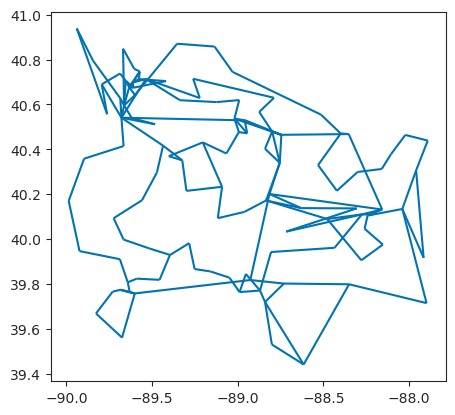

In [11]:
#####################################
##########bus_df
####################################

b_df = bus_df[["BusNum", "Latitude", "Longitude"]].set_index("BusNum").copy()
# “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
bus_gdf = gpd.GeoDataFrame(
    b_df,
    geometry=gpd.points_from_xy(b_df["Longitude"], b_df["Latitude"]),
    crs="epsg:4326",
)
bus_gdf
# bus_gdf = bus_gdf.to_crs(epsg=3857)


###### OPTIONAL: make bus "sizes" reflect the number of buses at the same latlon
df = bus_gdf.copy()
df["subgraph"] = 1


df = (
    df[["Latitude", "Longitude", "subgraph"]]
    .groupby(["Latitude", "Longitude"])
    .transform("count")
)
df

bus_gdf["size"] = df["subgraph"] * 10
bus_gdf

####  unique latlons
bus_unique_gdf = bus_gdf.drop_duplicates(["Latitude", "Longitude"])
print("\nnumber of unique latlons: {} out of 2000".format(len(bus_unique_gdf)))
bus_unique_gdf


####

###########################################
############ branch_df
##############################################

br_df = branch_df[
    [
        "FromBus",
        "ToBus",
        "from_latitude",
        "from_longitude",
        "to_latitude",
        "to_longitude",
    ]
].copy()

############## make from/to Points

br_df["FromPoint"] = [
    Point(x, y) for x, y in zip(br_df["from_longitude"], br_df["from_latitude"])
]
br_df["ToPoint"] = [
    Point(x, y) for x, y in zip(br_df["to_longitude"], br_df["to_latitude"])
]


############ lines
br_df["geometry"] = [
    LineString([x1, x2]) for x1, x2 in zip(br_df["FromPoint"], br_df["ToPoint"])
]


# “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
br_gdf = gpd.GeoDataFrame(br_df, geometry="geometry", crs="epsg:4326")

br_gdf.plot()

br_df


bus_gdf = bus_gdf.to_crs(epsg=3857)
br_gdf = br_gdf.to_crs(epsg=3857)

## existing wind penetration 
* using TE WTK

In [12]:
### for the true wind penetration we should get the actuals
# ##retrieve wind sites matching current wind penetration

# # retrieve wind sites (wind_sites are initially set to empty df )
# grid
# grid.retrieve_wind_sites(method="simple proximity")
# grid
# grid.wind_sites.head()


# grid.make_tables(
#     actuals_start=pd.Timestamp("2007-01-01 00:00:00", tz="utc"),
#     actuals_end=pd.Timestamp("2007-12-31 23:55:00", tz="utc"),
#     scenarios_start=pd.Timestamp("2008-01-01 00:00:00", tz="utc"),
#     scenarios_end=pd.Timestamp("2013-12-31 23:55:00", tz="utc"),
# )


tables_dir = "/projects/hpcapps/isatkaus/grid-buildouts-data/tables-data/"

# read instead of retrieve_wind_sites
filename = "{}_wind_sites_df.h5".format(grid_name)
grid.wind_sites = pd.read_hdf(os.path.join(tables_dir, filename))
print("\n wind sites")
grid.wind_sites.head()

# read instead of make_tables
filename = "{}_actuals_df.h5".format(grid_name)
grid.actuals = pd.read_hdf(os.path.join(tables_dir, filename))
filename = "{}_scenarios_df.h5".format(grid_name)
grid.scenarios = pd.read_hdf(os.path.join(tables_dir, filename))


# for actuals, make year you want
grid.actuals.index = grid.actuals.index.map(lambda t: t.replace(year=2020))
# see what you got
print("\nactuals_df:")
grid.actuals.head()
print("\nscenarios_df:")
grid.scenarios.head()

print(grid.info())


 wind sites


,SiteID,Capacity,Point,Latitude,Longitude,BusNum,GenUID
0,54007,16.0,POINT (-88.02514600000001 40.458515),40.458515,-88.025146,65,65_Wind_1
1,54196,16.0,POINT (-88.02273599999999 40.476978),40.476978,-88.022736,65,65_Wind_1
2,54008,16.0,POINT (-88.000885 40.456665),40.456665,-88.000885,65,65_Wind_1
3,53833,16.0,POINT (-88.02758799999999 40.440052),40.440052,-88.027588,65,65_Wind_1
4,54197,16.0,POINT (-87.998474 40.475128),40.475128,-87.998474,65,65_Wind_1



actuals_df:


,65_Wind_1,104_Wind_1,105_Wind_1,114_Wind_1,115_Wind_1,147_Wind_1,TotalPower
IssueTime,,,,,,,
2020-01-01 00:00:00+00:00,142.094736,99.000001,198.000002,1.7,150.0,100.5,691.294739
2020-01-01 00:05:00+00:00,140.804726,99.000001,198.000002,1.7,150.0,100.5,690.004728
2020-01-01 00:10:00+00:00,142.361249,99.000001,198.000002,1.7,150.0,100.5,691.561251
2020-01-01 00:15:00+00:00,145.972502,99.000001,198.000002,1.7,150.0,100.5,695.172504
2020-01-01 00:20:00+00:00,150.399995,99.000001,198.000002,1.7,150.0,100.5,699.599997



scenarios_df:


,65_Wind_1,104_Wind_1,105_Wind_1,114_Wind_1,115_Wind_1,147_Wind_1,TotalPower,Deviation
IssueTime,,,,,,,,
2008-01-01 00:00:00+00:00,1.459344,0.668133,0.583035,-0.024500,0.877288,1.845110,96.746560,5.408411
2008-01-01 00:05:00+00:00,1.601367,-0.445220,1.269019,0.091567,1.525665,3.528319,102.154971,7.570718
2008-01-01 00:10:00+00:00,1.097983,-0.016742,1.678258,0.294259,3.257260,5.579959,109.725689,11.890977
2008-01-01 00:15:00+00:00,1.172363,2.034480,3.025435,0.001593,4.814818,3.355411,121.616666,14.404100
2008-01-01 00:20:00+00:00,1.237113,2.234493,2.933309,0.000000,5.278723,6.783124,136.020766,18.466761



ACTIVSg200 grid info: 

 number of buses: 200
 number of generators: 49
 number of wind generators: 6
 number of solar generators: 0
 total generator capacity: 3602.84 MW
 wind capacity/penetration: 699.60 MW / 19.42%
 solar capacity/penetration: 0.00 MW / 0.00%


In [13]:
### total available wind energy (2007) when using TE
TE_wind_energy = grid.actuals["TotalPower"].sum() / 12
TE_wind_energy

2682398.2395944702

# run dir
* slect run_dir that you used in part1 (reV run output)
* run_dir for tamu200 has all years (2007-2013), entire box of tamu200 of wind
* part1 notebook created data in run_dir:
* only need to rerun part1 if changing grid or renewable technology (another wind turbine, solar panel, etc)
* current run: two ATB-mid30 turbines per WTK cell

In [14]:
#################
### run_dir from part1
run_dir = (
    "/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8"
)

In [15]:
!cat {run_dir}/readme.txt


experiment date: 2023-11-03 12:26:55
tamu200 grid, all years 
two ATB-mid30 turbines per WTK cell 
nrel-pysam version 4.1.0
nrel-reV verion: 0.8.2
python version: 3.11.0 | packaged by conda-forge | (main, Oct 25 2022, 06:24:40) [GCC 10.4.0]
using 5-min resource files (all files with * for the height)


In [16]:
!ls {run_dir}

all_cf_df.csv
config_gen.json
logs
meta_df.csv
pp.csv
pps_df.csv
readme.txt
wind_gen_2atb_turbine.json
wind-gen-tamu200-v8_generation_j000_2007.h5
wind-gen-tamu200-v8_generation_j001_2007.h5
wind-gen-tamu200-v8_generation_j002_2007.h5
wind-gen-tamu200-v8_generation_j003_2007.h5
wind-gen-tamu200-v8_generation_j004_2007.h5
wind-gen-tamu200-v8_generation_j005_2007.h5
wind-gen-tamu200-v8_generation_j006_2007.h5
wind-gen-tamu200-v8_generation_j007_2007.h5
wind-gen-tamu200-v8_generation_j008_2007.h5
wind-gen-tamu200-v8_generation_j009_2007.h5
wind-gen-tamu200-v8_generation_j010_2007.h5
wind-gen-tamu200-v8_generation_j011_2007.h5
wind-gen-tamu200-v8_generation_j012_2007.h5
wind-gen-tamu200-v8_generation_j013_2007.h5
wind-gen-tamu200-v8_generation_j014_2007.h5
wind-gen-tamu200-v8_generation_j015_2007.h5
wind-gen-tamu200-v8_generation_j016_2007.h5
wind-gen-tamu200-v8_generation_j017_2007.h5
wind-gen-tamu200-v8_generation_j018_2007.h5
wind-gen-tamu200-v8_generation_j019_2007.h5
wind-gen-tamu200-

##  work dir
* optionally change to where you want to write buildout results
* custon buildouts will be saved in work-dir/"some-buildout-configuration"
* work_dir will have common for all buildouts files. 
* "some-buildout-configuration" subdir we'll make later

In [17]:
work_dir = os.path.join(run_dir, "buildouts/work_dir")

if not os.path.exists(work_dir):
    os.makedirs(work_dir)

## start with all_cf_df.csv
* have all capacity factors
* have all inclusion % recorded already (not originally applied to generation_mwh column, so will do it here)

In [18]:
### all capacity coefs that have all inclusion % recorded already
filename = "all_cf_df.csv"
cf_df = pd.read_csv(os.path.join(run_dir, filename), index_col=0)

#### all project points
filename = "pps_df.csv"
pps_df = pd.read_csv(os.path.join(run_dir, filename), index_col=0)
print("\n pps_df:")
pps_df

print("\n min capacity factor:")
cf_df["cf_mean"].min()
print("\n min min inclusion factor:")
cf_df["inclusion"].min()

#### apply inclusion factor to generation_mwh
cf_df["incl_generation_mwh"] = cf_df["generation_mwh"] * cf_df["inclusion"]


print("\n cf_df:")
cf_df


 pps_df:


,latitude,longitude
gid,,
1578401,41.145520,-90.285706
1578402,41.164040,-90.283936
1578403,41.182556,-90.282166
1578404,41.201090,-90.280426
...,...,...
1723329,39.306717,-87.596405
1723330,39.325130,-87.593900
1723331,39.343555,-87.591400
1724517,39.157475,-87.592680



 min capacity factor:


0.33571953


 min min inclusion factor:


0.0


 cf_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh
gid,,,,,,,
1616332,0.380393,40.916645,-89.543490,36654.650,POINT (-9967935.437789379 5000054.591238469),0.160681,5889.688563
1616333,0.386721,40.935160,-89.541504,37264.470,POINT (-9967714.619707666 5002782.712128767),0.111570,4157.606157
1616334,0.395369,40.953660,-89.539520,38097.740,POINT (-9967493.801625954 5005508.786431535),0.274793,10469.007066
1616335,0.409028,40.972168,-89.537540,39413.910,POINT (-9967272.98354424 5008237.311931991),0.422925,16669.123992
...,...,...,...,...,...,...,...
1690944,0.434196,40.722565,-88.064180,41839.120,POINT (-9803259.504051795 4971505.74424035),0.359168,15027.283176
1690945,0.434934,40.741035,-88.061740,41910.270,POINT (-9802987.727951225 4974219.166330771),0.411157,17231.701921
1690946,0.434824,40.759506,-88.059326,41899.620,POINT (-9802719.349051913 4976933.342012658),0.361570,15149.655992
1690947,0.433640,40.777973,-88.056885,41785.543,POINT (-9802447.572951345 4979647.711204768),0.450593,18828.268387


In [19]:
###############
#### for gdp viz

# make gdf with project points
cf_df["geometry"] = [Point(x, y) for x, y in zip(cf_df["longitude"], cf_df["latitude"])]
# cf_df
# “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
cf_gdf = gpd.GeoDataFrame(cf_df, geometry="geometry", crs="epsg:4326")
cf_gdf = cf_gdf.to_crs("epsg:3857")

## cf cutoff
* histogram of capacity factors based on one year

In [20]:
cf_df["cf_mean"].iplot(kind="hist", title="histogram of capacity factors", bins=100)

/projects/hpcapps/isatkaus/conda-envs/buildouts/lib/python3.11/site-packages/geopandas/plotting.py:730: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

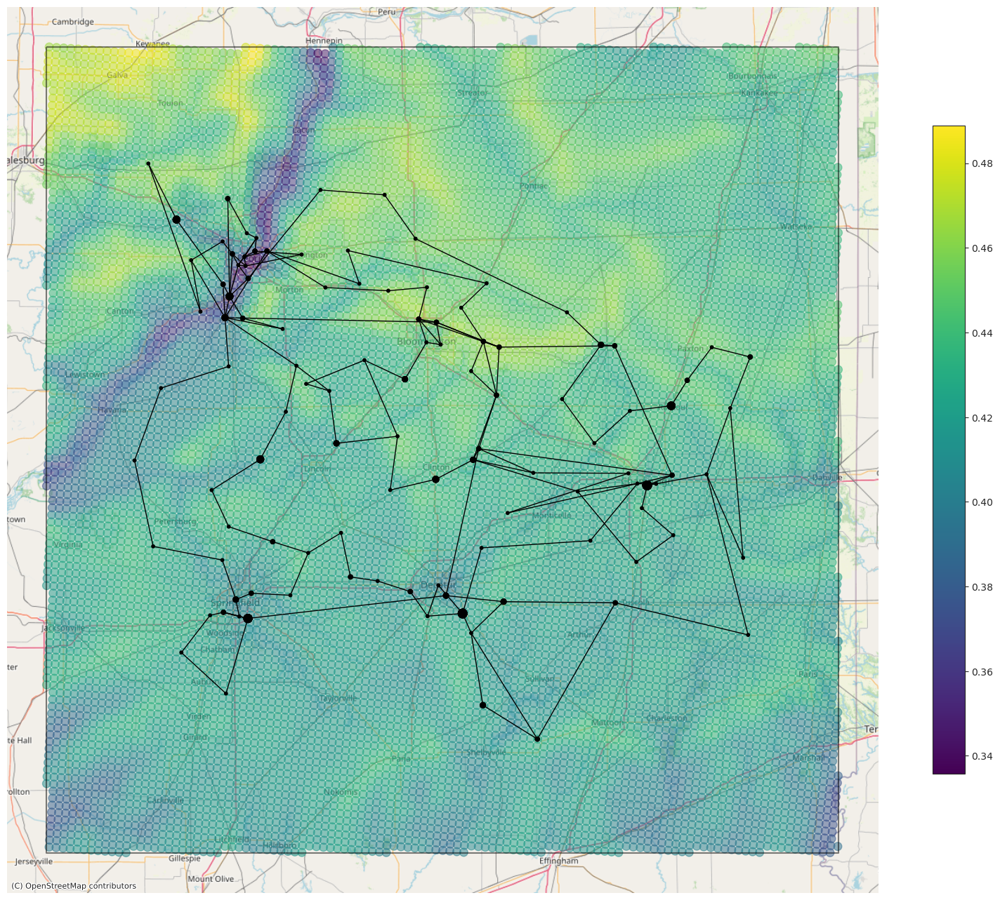

In [21]:
# # make gdf with project points
# cf_df["geometry"] = [Point(x, y) for x, y in zip(cf_df["longitude"], cf_df["latitude"])]
# # cf_df
# # “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
# cf_gdf = gpd.GeoDataFrame(cf_df, geometry="geometry", crs="epsg:4326")

cf_gdf = cf_gdf.to_crs("epsg:3857")
# plt.figure(figsize=(20, 20))
ax = cf_gdf.plot(
    figsize=(20, 20),
    markersize=70,
    column="cf_mean",
    legend=True,
    legend_kwds={
        "shrink": 0.6,
    },
    alpha=0.5,
    cmap="viridis",
)


# Web Mercator
# rts_box_gdf = rts_box_gdf.to_crs(epsg=3857)
bus_gdf = bus_gdf.to_crs(epsg=3857)
br_gdf = br_gdf.to_crs(epsg=3857)
# bus_gdf.plot(ax=ax, color="black",  markersize = 5)
bus_gdf.plot(ax=ax, color="black", markersize="size")

br_gdf.plot(ax=ax, color="black", linewidth=1)


####### based on project points, draw a box (OPTIONAL)
top = pps_df["latitude"].max()
bottom = pps_df["latitude"].min()
left = pps_df["longitude"].min()
right = pps_df["longitude"].max()

lat_point_list = [top, top, bottom, bottom]
lon_point_list = [left, right, right, left]

polygon_geom = Polygon(zip(lon_point_list, lat_point_list))
# “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
tamu_box_gdf = gpd.GeoDataFrame(index=[0], crs="epsg:4326", geometry=[polygon_geom])
# print(polygon.geometry)

tamu_box_gdf = tamu_box_gdf.to_crs("epsg:3857")
tamu_box_gdf.boundary.plot(ax=ax, alpha=0.5, edgecolor="k")


# ####### add map tile stamen tile service is retiring
# ctx.add_basemap(ax)

# By default, contextily uses the Stamen Terrain style. We can specify a different style using "source" kwarg
# full list in ctx.sources module or
# https://github.com/geopandas/contextily


ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
# ctx.add_basemap(ax,source=ctx.providers.OpenTopoMap)
# ctx.add_basemap(ax,source=ctx.providers.Stamen.Terrain)
# ctx.add_basemap(ax,source=ctx.providers.Stamen.Toner)

# ### save figure
# save_dir = os.path.join(run_dir, "figures")
# filename = "cf_all_{}.png".format(year)
# plt.savefig(
#     os.path.join(save_dir, filename),
#     bbox_inches="tight",
# )

### save figure in work dir (since this is the same for all buildout options)
ax.set_axis_off()
filename = os.path.join(work_dir, "cfs_all.png")
plt.savefig(filename, bbox_inches="tight", pad_inches=0)

## high df
* select your capacity factor cutoff: i.e., drom low-capacity-factor sites


In [22]:
# select all sites in the box, selection by distance will be done later
selected_df = cf_df.copy()

# # capacity factor cutoff (old)
# cf_cutoff = 400
# capacity factor cutoff (new)
cf_cutoff = 0.40

high_df = selected_df.loc[selected_df["cf_mean"] >= cf_cutoff]
low_df = selected_df.loc[selected_df["cf_mean"] < cf_cutoff]

# color_map = ["blue" if x < cf_cutoff else "red" for x in selected_df["cf_mean"]]
# len(color_map)


# print('RTS total load (MWh):{:,}'.format(36581383.0))
total_generation = high_df["incl_generation_mwh"].sum()
print(
    "total included generation of selected high capacity sites (MWh):{:,}".format(
        round(total_generation)
    )
)

# total_generation /36581383.0
print("\nhigh_df:")
high_df
print("\nlow_df:")
low_df

###############
#### for gdp viz

# make gdf with project points
high_df["geometry"] = [
    Point(x, y) for x, y in zip(high_df["longitude"], high_df["latitude"])
]
# cf_df
# “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
high_gdf = gpd.GeoDataFrame(high_df, geometry="geometry", crs="epsg:4326")
high_gdf = high_gdf.to_crs("epsg:3857")

total included generation of selected high capacity sites (MWh):186,032,723

high_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh
gid,,,,,,,
1616335,0.409028,40.972168,-89.537540,39413.910,POINT (-89.53754 40.972168),0.422925,16669.123992
1616336,0.421676,40.990677,-89.535550,40632.660,POINT (-89.53555 40.990677),0.489669,19896.571116
1616337,0.432024,41.009180,-89.533570,41629.860,POINT (-89.53357 41.00918),0.332645,13847.949298
1616338,0.439403,41.027695,-89.531586,42340.848,POINT (-89.531586 41.027695),0.571146,24182.816348
...,...,...,...,...,...,...,...
1690944,0.434196,40.722565,-88.064180,41839.120,POINT (-88.06418 40.722565),0.359168,15027.283176
1690945,0.434934,40.741035,-88.061740,41910.270,POINT (-88.06174 40.741035),0.411157,17231.701921
1690946,0.434824,40.759506,-88.059326,41899.620,POINT (-88.059326 40.759506),0.361570,15149.655992
1690947,0.433640,40.777973,-88.056885,41785.543,POINT (-88.056885 40.777973),0.450593,18828.268387



low_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh
gid,,,,,,,
1616332,0.380393,40.916645,-89.543490,36654.650,POINT (-89.54349 40.916645),0.160681,5889.688563
1616333,0.386721,40.935160,-89.541504,37264.470,POINT (-89.541504 40.93516),0.111570,4157.606157
1616334,0.395369,40.953660,-89.539520,38097.740,POINT (-89.53952 40.95366),0.274793,10469.007066
1617552,0.377227,40.674620,-89.544740,36349.590,POINT (-89.54474 40.67462),0.000000,0.000000
...,...,...,...,...,...,...,...
1690861,0.393954,39.191235,-88.260345,37961.375,POINT (-88.260345 39.191235),0.203557,7727.315464
1690862,0.393324,39.209656,-88.258060,37900.680,POINT (-88.25806 39.209656),0.051653,1957.679752
1690863,0.397172,39.228090,-88.255740,38271.500,POINT (-88.25574 39.22809),0.498024,19060.114625
1690864,0.399670,39.246513,-88.253420,38512.246,POINT (-88.25342 39.246513),0.179752,6922.655789


/projects/hpcapps/isatkaus/conda-envs/buildouts/lib/python3.11/site-packages/geopandas/plotting.py:730: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

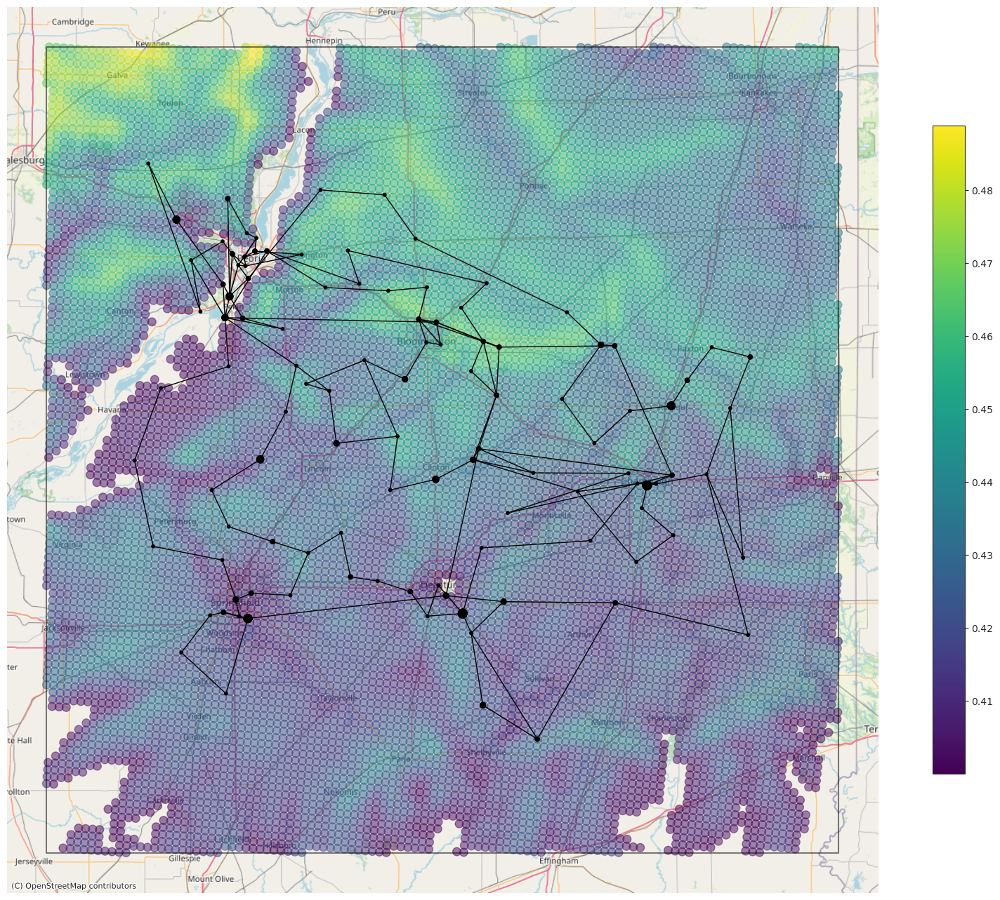

In [23]:
# # make gdf with project points
# cf_df["geometry"] = [Point(x, y) for x, y in zip(cf_df["longitude"], cf_df["latitude"])]
# # cf_df
# # “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
# cf_gdf = gpd.GeoDataFrame(cf_df, geometry="geometry", crs="epsg:4326")

high_gdf = high_gdf.to_crs("epsg:3857")
# plt.figure(figsize=(20, 20))
ax = high_gdf.plot(
    figsize=(20, 20),
    markersize=70,
    column="cf_mean",
    legend=True,
    legend_kwds={
        "shrink": 0.6,
    },
    alpha=0.5,
    cmap="viridis",
)


# Web Mercator
# rts_box_gdf = rts_box_gdf.to_crs(epsg=3857)
bus_gdf = bus_gdf.to_crs(epsg=3857)
br_gdf = br_gdf.to_crs(epsg=3857)
# bus_gdf.plot(ax=ax, color="black",  markersize = 5)
bus_gdf.plot(ax=ax, color="black", markersize="size")

br_gdf.plot(ax=ax, color="black", linewidth=1)


####### based on project points, draw a box (OPTIONAL)
top = pps_df["latitude"].max()
bottom = pps_df["latitude"].min()
left = pps_df["longitude"].min()
right = pps_df["longitude"].max()

lat_point_list = [top, top, bottom, bottom]
lon_point_list = [left, right, right, left]

polygon_geom = Polygon(zip(lon_point_list, lat_point_list))
# “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
tamu_box_gdf = gpd.GeoDataFrame(index=[0], crs="epsg:4326", geometry=[polygon_geom])
# print(polygon.geometry)

tamu_box_gdf = tamu_box_gdf.to_crs("epsg:3857")
tamu_box_gdf.boundary.plot(ax=ax, alpha=0.5, edgecolor="k")


####### add map tile
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# ### save figure
# save_dir = os.path.join(run_dir, "figures")
# filename = "cf_all_{}.png".format(year)
# plt.savefig(
#     os.path.join(save_dir, filename),
#     bbox_inches="tight",
# )

### save figure in work dir (since this is the same for all buildout options)
ax.set_axis_off()
filename = os.path.join(work_dir, "cfs_after_cutoff.png")
plt.savefig(filename, bbox_inches="tight", pad_inches=0)

[Select grid](#select_grid)

* Capacity factors
<a id='capacity_factors'></a>

[Exclusions](#exclusions)

### save/load

In [24]:
### save high_df and low_df
work_dir
filename = "cf_df.csv"
high_df.to_csv(os.path.join(work_dir, filename))
filename = "high_cf_df.csv"
high_df.to_csv(os.path.join(work_dir, filename))
filename = "low_cf_df.csv"
low_df.to_csv(os.path.join(work_dir, filename))

'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/buildouts/work_dir'

In [25]:
# ### load files
# filename = "high_cf_df.csv"
# high_df = pd.read_csv(os.path.join(run_dir, filename), index_col=0)


# # make gdf with project points
# high_df["geometry"] = [
#     Point(x, y) for x, y in zip(high_df["longitude"], high_df["latitude"])
# ]
# # cf_df
# # “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
# high_gdf = gpd.GeoDataFrame(high_df, geometry="geometry", crs="epsg:4326")
# high_gdf = high_gdf.to_crs("epsg:3857")

# high_gdf

# inclusion cutoff, capacity adjustement
* select minimum inclusion percentage to decide if site is "buidable" 
* select by inclusion from high_gdf
* recording exclusions was done in part1 notebook, now just need to select 
* 0 = nothing can be build

In [26]:
high_gdf

,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh
gid,,,,,,,
1616335,0.409028,40.972168,-89.537540,39413.910,POINT (-9967273.360 5008237.317),0.422925,16669.123992
1616336,0.421676,40.990677,-89.535550,40632.660,POINT (-9967051.834 5010966.621),0.489669,19896.571116
1616337,0.432024,41.009180,-89.533570,41629.860,POINT (-9966831.421 5013695.806),0.332645,13847.949298
1616338,0.439403,41.027695,-89.531586,42340.848,POINT (-9966610.563 5016427.529),0.571146,24182.816348
...,...,...,...,...,...,...,...
1690944,0.434196,40.722565,-88.064180,41839.120,POINT (-9803259.675 4971505.789),0.359168,15027.283176
1690945,0.434934,40.741035,-88.061740,41910.270,POINT (-9802988.055 4974219.099),0.411157,17231.701921
1690946,0.434824,40.759506,-88.059326,41899.620,POINT (-9802719.330 4976933.309),0.361570,15149.655992
1690947,0.433640,40.777973,-88.056885,41785.543,POINT (-9802447.599 4979647.685),0.450593,18828.268387


In [27]:
### sites with less that 20% buildable area will be dropped
inclusion_cutoff = 0.2
n_before = len(high_gdf)

# #### drop gids with 0.0 inclusion (i.e. 100 % excluded gids)
# high_gdf.drop(high_gdf.loc[high_gdf["inclusion"] = 0.0].index, inplace=True)

##### drop gids with inclusion below a cutoff
high_gdf.drop(
    high_gdf.loc[high_gdf["inclusion"] <= inclusion_cutoff].index, inplace=True
)


### add site capacity (2*5.5MW turbines per gid)
high_gdf["incl_capacity_mw"] = 11 * high_gdf["inclusion"]


n_after = len(high_gdf)
print("\nremoved {} gids out of {}".format(n_before - n_after, n_before))
print("\nhigh capacity factors above {} cell inclusion level:".format(inclusion_cutoff))

high_gdf


removed 1707 gids out of 11877

high capacity factors above 0.2 cell inclusion level:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1616335,0.409028,40.972168,-89.537540,39413.910,POINT (-9967273.360 5008237.317),0.422925,16669.123992,4.652174
1616336,0.421676,40.990677,-89.535550,40632.660,POINT (-9967051.834 5010966.621),0.489669,19896.571116,5.386364
1616337,0.432024,41.009180,-89.533570,41629.860,POINT (-9966831.421 5013695.806),0.332645,13847.949298,3.659091
1616338,0.439403,41.027695,-89.531586,42340.848,POINT (-9966610.563 5016427.529),0.571146,24182.816348,6.282609
...,...,...,...,...,...,...,...,...
1690944,0.434196,40.722565,-88.064180,41839.120,POINT (-9803259.675 4971505.789),0.359168,15027.283176,3.950851
1690945,0.434934,40.741035,-88.061740,41910.270,POINT (-9802988.055 4974219.099),0.411157,17231.701921,4.522727
1690946,0.434824,40.759506,-88.059326,41899.620,POINT (-9802719.330 4976933.309),0.361570,15149.655992,3.977273
1690947,0.433640,40.777973,-88.056885,41785.543,POINT (-9802447.599 4979647.685),0.450593,18828.268387,4.956522


/projects/hpcapps/isatkaus/conda-envs/buildouts/lib/python3.11/site-packages/geopandas/plotting.py:730: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

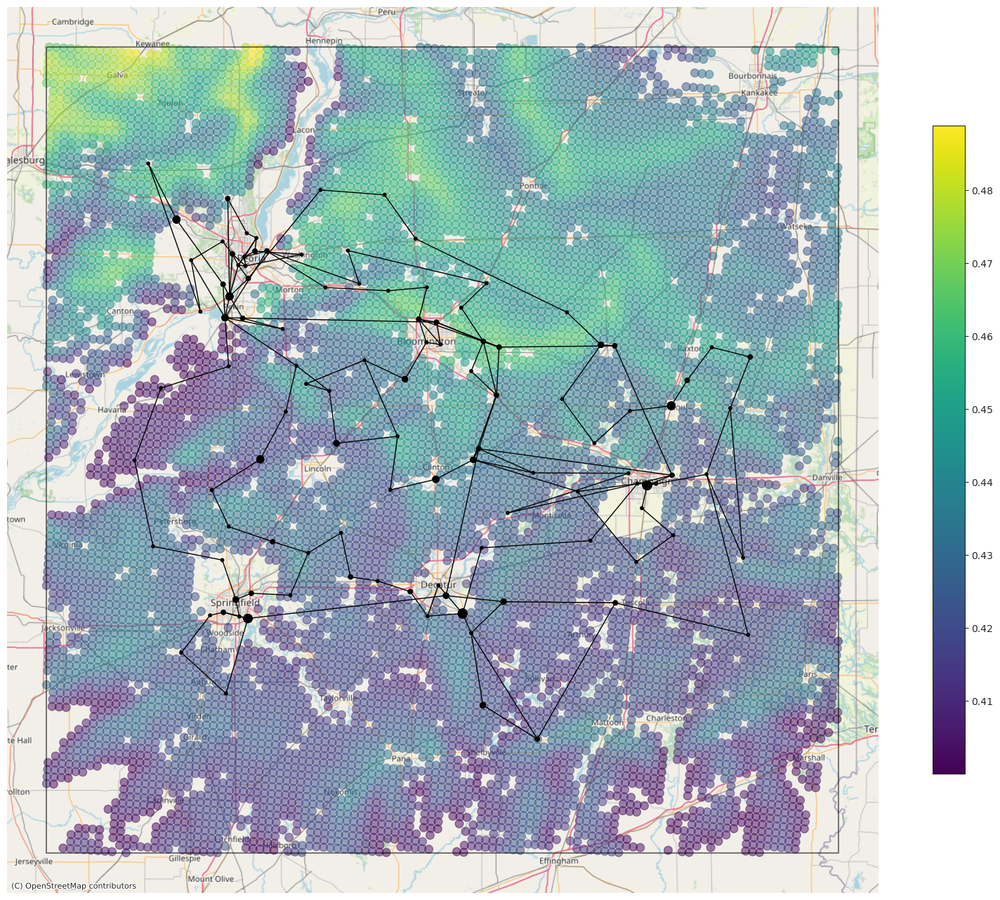

In [28]:
# # make gdf with project points
# cf_df["geometry"] = [Point(x, y) for x, y in zip(cf_df["longitude"], cf_df["latitude"])]
# # cf_df
# # “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
# cf_gdf = gpd.GeoDataFrame(cf_df, geometry="geometry", crs="epsg:4326")

high_gdf = high_gdf.to_crs("epsg:3857")
# plt.figure(figsize=(20, 20))
ax = high_gdf.plot(
    figsize=(20, 20),
    markersize=70,
    column="cf_mean",
    legend=True,
    legend_kwds={
        "shrink": 0.6,
    },
    alpha=0.5,
    cmap="viridis",
)


# Web Mercator
# rts_box_gdf = rts_box_gdf.to_crs(epsg=3857)
bus_gdf = bus_gdf.to_crs(epsg=3857)
br_gdf = br_gdf.to_crs(epsg=3857)
# bus_gdf.plot(ax=ax, color="black",  markersize = 5)
bus_gdf.plot(ax=ax, color="black", markersize="size")

br_gdf.plot(ax=ax, color="black", linewidth=1)


####### based on project points, draw a box (OPTIONAL)
top = pps_df["latitude"].max()
bottom = pps_df["latitude"].min()
left = pps_df["longitude"].min()
right = pps_df["longitude"].max()

lat_point_list = [top, top, bottom, bottom]
lon_point_list = [left, right, right, left]

polygon_geom = Polygon(zip(lon_point_list, lat_point_list))
polygon_geom = Polygon([(left, top), (right, top), (right, bottom), (left, bottom)])

# “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
tamu_box_gdf = gpd.GeoDataFrame(index=[0], crs="epsg:4326", geometry=[polygon_geom])
# print(polygon.geometry)

tamu_box_gdf = tamu_box_gdf.to_crs("epsg:3857")
tamu_box_gdf.boundary.plot(ax=ax, alpha=0.5, edgecolor="k")


####### add map tile
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)


### save figure in work dir (since this is the same for all buildout options)
ax.set_axis_off()
filename = os.path.join(work_dir, "cfs_after_cutoff_and_exclusions.png")
plt.savefig(filename, bbox_inches="tight", pad_inches=0)

[Capacity factors](#capacity_factors)

* Exclusions
<a id='exclusions'></a>

[Voronoi](#voronoi)

### save/load

In [29]:
#### save high_df with inclusion col
filename = "high_cf_incl_df.csv"
high_gdf.to_csv(os.path.join(work_dir, filename))

In [30]:
# ### load

# filename = "high_cf_incl_df.csv"
# high_df = pd.read_csv(os.path.join(work_dir, filename), index_col=0)


# # make gdf with project points
# high_df["geometry"] = [
#     Point(x, y) for x, y in zip(high_df["longitude"], high_df["latitude"])
# ]
# # cf_df
# # “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
# high_gdf = gpd.GeoDataFrame(high_df, geometry="geometry", crs="epsg:4326")
# high_gdf = high_gdf.to_crs("epsg:3857")

# high_gdf

# #### all project points
# filename = "pps_df.csv"
# pps_df = pd.read_csv(os.path.join(work_dir, filename), index_col=0)
# pps_df

# load (demand) data
* somewhat optional, needed only if you want to use demand data for making buildouts
* e.g., match total buildout generation with total demand
* e.g., place new wind generators n-hops away from demand buses
* load data is the same for all buildouts, so can skip
* tamu200 load data parsing was done with mac local notebook:

* ~/projects/notebooks/ecp/public-github/powerscenarios/notebooks/dev/load/generate_TAMU200_load.ipynb

* already parsed data files:
* /projects/exasgd/isatkaus/data/load-data/ACTIVSg200
* NOTE: load ends on dec 31, 23:00, i.e., missing one hour, so 
* lets add one hour (11 5-min timesteps) by interpolating to "wrap around"
* being tedious to compute correct annual demand


In [31]:
load_data_dir = "/projects/hpcapps/isatkaus/grid-buildouts-data/load-data/"
####################################################################
###################################################################
filename = "ACTIVSg200_loadP.csv"
loadP_df = pd.read_csv(
    os.path.join(load_data_dir, filename), index_col=0, parse_dates=True
)
loadP_df.columns = loadP_df.columns.astype("int")

# ### add missing hour (repeat 22nd hour)
# df = loadP_df.iloc[-12:-1]
# df.index = df.index.map(lambda t: t.replace(hour=23))
# loadP_df = pd.concat([loadP_df, df])

# ### add missing hour (interpolate to wrap around)
start = loadP_df.iloc[-1:]
end = loadP_df.iloc[0:1]
end.index = end.index.map(lambda t: t.replace(month=12, day=31, hour=23, minute=55))
df = pd.concat([start, end]).resample("5min").interpolate()
df.drop(pd.Timestamp("2017-12-31 23:00:00+00:00"), inplace=True)
loadP_df = pd.concat([loadP_df, df])

### remap buses, since we removed existing wind gens
loadP_df.columns = loadP_df.columns.map(bus_map_s)
loadP_df

####################################################################
###################################################################
filename = "ACTIVSg200_loadQ.csv"
loadQ_df = pd.read_csv(
    os.path.join(load_data_dir, filename), index_col=0, parse_dates=True
)
loadQ_df.columns = loadQ_df.columns.astype("int")

# ### add missing hour (repeat 22nd hour)
# df = loadQ_df.iloc[-12:-1]
# df.index = df.index.map(lambda t: t.replace(hour=23))
# loadQ_df = pd.concat([loadQ_df, df])

# ### add missing hour (interpolate to wrap around)
start = loadQ_df.iloc[-1:]
end = loadQ_df.iloc[0:1]
end.index = end.index.map(lambda t: t.replace(month=12, day=31, hour=23, minute=55))
df = pd.concat([start, end]).resample("5min").interpolate()
df.drop(pd.Timestamp("2017-12-31 23:00:00+00:00"), inplace=True)
loadQ_df = pd.concat([loadQ_df, df])

### remap buses, since we removed existing wind gens
loadQ_df.columns = loadQ_df.columns.map(bus_map_s)
loadQ_df


################### save new files
load_save_dir = os.path.join(work_dir, "load-data")
if not os.path.exists(load_save_dir):
    os.makedirs(load_save_dir)

filename = "ACTIVSg200_loadP.csv"
loadP_df.to_csv(os.path.join(load_save_dir, filename))
print("\n saving loadP_df to:")
os.path.join(load_save_dir, filename)

filename = "ACTIVSg200_loadQ.csv"
loadQ_df.to_csv(os.path.join(load_save_dir, filename))
print("\n saving loadQ_df to:")
os.path.join(load_save_dir, filename)

,2,8,10,30,43,59,60,74,83,85,96,98,100,105,107,...,138,157,166,167,168,169,173,174,178,185,87,140,170,179,188
DateTime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2017-01-01 00:00:00+00:00,4.544305,14.598349,26.245053,36.335993,1.285196,2.908601,2.336720,2.213735,2.305973,5.073142,4.507410,7.483653,0.319762,5.792605,6.678099,...,14.888107,25.462109,2.990964,4.842248,1.539957,4.063931,13.125773,4.302985,5.943012,4.019455,32.817472,11.666365,12.644105,7.176744,24.988902
2017-01-01 00:05:00+00:00,4.512747,14.496972,26.062796,36.083660,1.276271,2.888403,2.320493,2.198361,2.289960,5.037912,4.476108,7.431683,0.317541,5.752379,6.631724,...,14.782036,25.280703,2.969655,4.807749,1.528986,4.034977,13.032258,4.272328,5.900671,3.990818,32.508339,11.556471,12.525000,7.109140,24.753512
2017-01-01 00:10:00+00:00,4.481190,14.395595,25.880538,35.831326,1.267346,2.868204,2.304265,2.182988,2.273946,5.002681,4.444807,7.379713,0.315321,5.712153,6.585348,...,14.675964,25.099297,2.948345,4.773251,1.518014,4.006023,12.938742,4.241672,5.858329,3.962182,32.199205,11.446576,12.405896,7.041537,24.518122
2017-01-01 00:15:00+00:00,4.449632,14.294217,25.698281,35.578993,1.258421,2.848005,2.288038,2.167615,2.257932,4.967451,4.413505,7.327743,0.313100,5.671926,6.538972,...,14.569893,24.917891,2.927036,4.738752,1.507043,3.977069,12.845227,4.211015,5.815988,3.933545,31.890071,11.336681,12.286791,6.973933,24.282732
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-12-31 23:40:00+00:00,4.636776,14.895409,26.779109,37.075388,1.311348,2.967788,2.384269,2.258781,2.352897,5.176374,4.599130,7.635936,0.326268,5.910478,6.813991,...,14.962216,25.588853,3.005852,4.866352,1.547623,4.084160,13.191110,4.324404,5.972595,4.039463,33.009883,11.734766,12.718238,7.218821,25.135414
2017-12-31 23:45:00+00:00,4.605953,14.796389,26.601090,36.828923,1.302631,2.948059,2.368419,2.243766,2.337256,5.141963,4.568557,7.585175,0.324100,5.871187,6.768694,...,14.937513,25.546605,3.000889,4.858317,1.545068,4.077417,13.169331,4.317265,5.962734,4.032794,32.945746,11.711966,12.693527,7.204795,25.086577
2017-12-31 23:50:00+00:00,4.575129,14.697369,26.423072,36.582458,1.293913,2.928330,2.352570,2.228750,2.321615,5.107553,4.537983,7.534414,0.321931,5.831896,6.723396,...,14.912810,25.504357,2.995927,4.850283,1.542512,4.070674,13.147552,4.310125,5.952873,4.026125,32.881609,11.689166,12.668816,7.190769,25.037739
2017-12-31 23:55:00+00:00,4.544305,14.598349,26.245053,36.335993,1.285196,2.908601,2.336720,2.213735,2.305973,5.073142,4.507410,7.483653,0.319762,5.792605,6.678099,...,14.888107,25.462109,2.990964,4.842248,1.539957,4.063931,13.125773,4.302985,5.943012,4.019455,32.817472,11.666365,12.644105,7.176744,24.988902


,2,8,10,30,43,59,60,74,83,85,96,98,100,105,107,...,138,157,166,167,168,169,173,174,178,185,87,140,170,179,188
DateTime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2017-01-01 00:00:00+00:00,1.291345,4.163051,7.477503,10.355358,0.362806,0.830150,0.664120,0.633374,0.657971,1.445077,1.285196,2.133794,0.092239,1.648002,1.900122,...,4.241832,7.255033,0.850590,1.378734,0.439194,1.156358,3.741485,1.228630,1.695621,1.145239,9.351716,3.325646,3.605000,2.041946,7.123533
2017-01-01 00:05:00+00:00,1.282377,4.134141,7.425576,10.283446,0.360287,0.824386,0.659508,0.628976,0.653402,1.435041,1.276271,2.118976,0.091598,1.636558,1.886927,...,4.211611,7.203344,0.844530,1.368911,0.436065,1.148119,3.714828,1.219877,1.683540,1.137080,9.263625,3.294319,3.571042,2.022712,7.056431
2017-01-01 00:10:00+00:00,1.273410,4.105231,7.373649,10.211534,0.357768,0.818621,0.654896,0.624577,0.648833,1.425006,1.267346,2.104158,0.090958,1.625113,1.873732,...,4.181389,7.151656,0.838470,1.359089,0.432935,1.139881,3.688172,1.211123,1.671460,1.128920,9.175534,3.262992,3.537083,2.003477,6.989329
2017-01-01 00:15:00+00:00,1.264442,4.076321,7.321722,10.139622,0.355248,0.812856,0.650285,0.620179,0.644263,1.414971,1.258421,2.089340,0.090317,1.613669,1.860536,...,4.151168,7.099967,0.832410,1.349266,0.429806,1.131642,3.661515,1.202370,1.659379,1.120761,9.087442,3.231665,3.503125,1.984242,6.922227
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-12-31 23:40:00+00:00,1.317623,4.247764,7.629662,10.566078,0.370189,0.847043,0.677634,0.646262,0.671360,1.474482,1.311348,2.177214,0.094116,1.681537,1.938787,...,4.262946,7.291147,0.854824,1.385597,0.441380,1.162114,3.760109,1.234746,1.704061,1.150940,9.406546,3.345144,3.626136,2.053919,7.165299
2017-12-31 23:45:00+00:00,1.308863,4.219526,7.578942,10.495838,0.367728,0.841412,0.673130,0.641966,0.666897,1.464680,1.302631,2.162741,0.093490,1.670359,1.925899,...,4.255908,7.279109,0.853413,1.383310,0.440651,1.160195,3.753901,1.232707,1.701248,1.149039,9.388269,3.338645,3.619091,2.049928,7.151377
2017-12-31 23:50:00+00:00,1.300104,4.191289,7.528223,10.425598,0.365267,0.835781,0.668625,0.637670,0.662434,1.454879,1.293913,2.148268,0.092865,1.659181,1.913011,...,4.248870,7.267071,0.852001,1.381022,0.439922,1.158276,3.747693,1.230669,1.698434,1.147139,9.369992,3.332145,3.612045,2.045937,7.137455
2017-12-31 23:55:00+00:00,1.291345,4.163051,7.477503,10.355358,0.362806,0.830150,0.664120,0.633374,0.657971,1.445077,1.285196,2.133794,0.092239,1.648002,1.900122,...,4.241832,7.255033,0.850590,1.378734,0.439194,1.156358,3.741485,1.228630,1.695621,1.145239,9.351716,3.325646,3.605000,2.041946,7.123533



 saving loadP_df to:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/buildouts/work_dir/load-data/ACTIVSg200_loadP.csv'


 saving loadQ_df to:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/buildouts/work_dir/load-data/ACTIVSg200_loadQ.csv'

In [32]:
total_load_mwh = loadP_df.sum().sum() / 12
print(f"\n total {grid_name} loadP: {round(total_load_mwh):,} MWh")

load_buses = loadP_df.columns
print(f"\n total number of load buses is {len(load_buses)} out of {len(bus_df)}")
print("\n load bus numbers:")
load_buses.sort_values()


 total ACTIVSg200 loadP: 8,949,170 MWh

 total number of load buses is 108 out of 194

 load bus numbers:


Index([  2,   4,   6,   8,  10,  12,  13,  16,  18,  19,
       ...
       179, 180, 184, 185, 186, 187, 188, 192, 193, 194],
      dtype='int64', length=108)

In [33]:
# total_consumption = load_df.sum().sum()
# print("total tamu2k consumption (MWh):{:,}".format(round(total_consumption)))

# total_generation = high_gdf["generation_mwh"].sum()

# print(
#     "total generation of selected high capacity sites after exclusions (MWh):{:,}".format(
#         round(total_generation)
#     )
# )
# print(
#     "available to required ratio: {}".format(
#         round(total_generation / total_consumption, 2)
#     )
# )

# ### total available wind energy (2007) when using TE
# TE_wind_energy = grid.actuals["TotalPower"].sum() / 12
# TE_wind_energy

# print(
#     "existing wind penetration using TE data (2007): {}".format(
#         round(TE_wind_energy / total_consumption, 2)
#     )
# )

# Voronoi polygons based on all bus unique locations
* what can we build?

In [34]:
print("\n For Voronoi method unique locations matter:")

### unique buses
s = bus_df.apply(lambda x: (x["Latitude"], x["Longitude"]), axis=1).unique()
print(f"\n unique bus locations: {len(s)} out of {len(bus_df)}:")

### unique gens (thermal only)
s = gen_df.apply(lambda x: (x["Latitude"], x["Longitude"]), axis=1).unique()
print(f"\n unique gen locations {len(s)} out of {len(gen_df)}:")


 For Voronoi method unique locations matter:

 unique bus locations: 111 out of 194:

 unique gen locations 13 out of 43:


In [35]:
#############################################
### create points_gdf - voronoi polygon points

##### we need to limit buses to unique latlons
# bus_gdf = bus_gdf.to_crs(epsg=3857)
bus_unique_gdf = bus_gdf.drop_duplicates(["Latitude", "Longitude"])
bus_unique_gdf = bus_unique_gdf.to_crs(epsg=3857)
bus_unique_gdf.reset_index(inplace=True)
### first_bus is first in the row when dropping duplicates in unique locations
points_gdf = bus_unique_gdf.copy()
points_gdf.rename(columns={"BusNum": "first_bus"}, inplace=True)
points_gdf.index.name = "pt_idx"
print("\n voronoi polygon points (one per polygon), points_gdf:")
points_gdf


 voronoi polygon points (one per polygon), points_gdf:


,first_bus,Latitude,Longitude,geometry,size
pt_idx,,,,,
0,1,40.642116,-89.599560,POINT (-9974177.395 4959696.311),20
1,3,39.866030,-89.251291,POINT (-9935408.267 4846493.180),20
2,5,40.378337,-88.105151,POINT (-9807820.546 4921074.461),20
3,7,40.712882,-89.576722,POINT (-9971635.080 4970083.622),20
...,...,...,...,...,...
107,189,40.470500,-88.398700,POINT (-9840498.271 4934551.478),30
108,192,40.556403,-89.762073,POINT (-9992268.259 4947129.757),10
109,193,40.306027,-87.958606,POINT (-9791507.231 4910513.455),10
110,194,40.169931,-89.986537,POINT (-10017255.477 4890667.004),10


In [36]:
#############################################################
### tighter voronoi boundary box: polygon instead of the box
### to get clockwise polygon points (lon,lat) use gdf map or bokeh map
### bokeh map:
### /Users/isatkaus/projects/intern/clara/grid-viz-bokeh/html-plots/ACTIVSg200_splitpoints.html

#### polygon points
polygon_points = [
    (-1.000e7, 4.79e6),
    (-1.004e7, 4.90e6),
    (-1.004e7, 5.02e6),
    (-9.90e6, 5.02e6),
    (-9.85e6, 4.98e6),
    (-9.80e6, 4.95e6),
    (-9.77e6, 4.94e6),
    (-9.77e6, 4.80e6),
    (-9.80e6, 4.80e6),
    (-9.85e6, 4.77e6),
    (-9.90e6, 4.77e6),
    (-9.95e6, 4.80e6),
]

polygon_geom = Polygon(polygon_points)
## when using Mercantor
tamu_polygon_gdf = gpd.GeoDataFrame(index=[0], crs="epsg:3857", geometry=[polygon_geom])
# print(polygon.geometry)


#### simple square box
lat_point_list = [top, top, bottom, bottom]
lon_point_list = [left, right, right, left]
polygon_points = zip(lon_point_list, lat_point_list)
polygon_geom = Polygon(polygon_points)

###“EPSG:4326” WGS84 Latitude/Longitude, used in GPS
tamu_box_gdf = gpd.GeoDataFrame(index=[0], crs="epsg:4326", geometry=[polygon_geom])
tamu_box_gdf = tamu_box_gdf.to_crs("epsg:3857")

/projects/hpcapps/isatkaus/conda-envs/buildouts/lib/python3.11/site-packages/geopandas/plotting.py:730: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

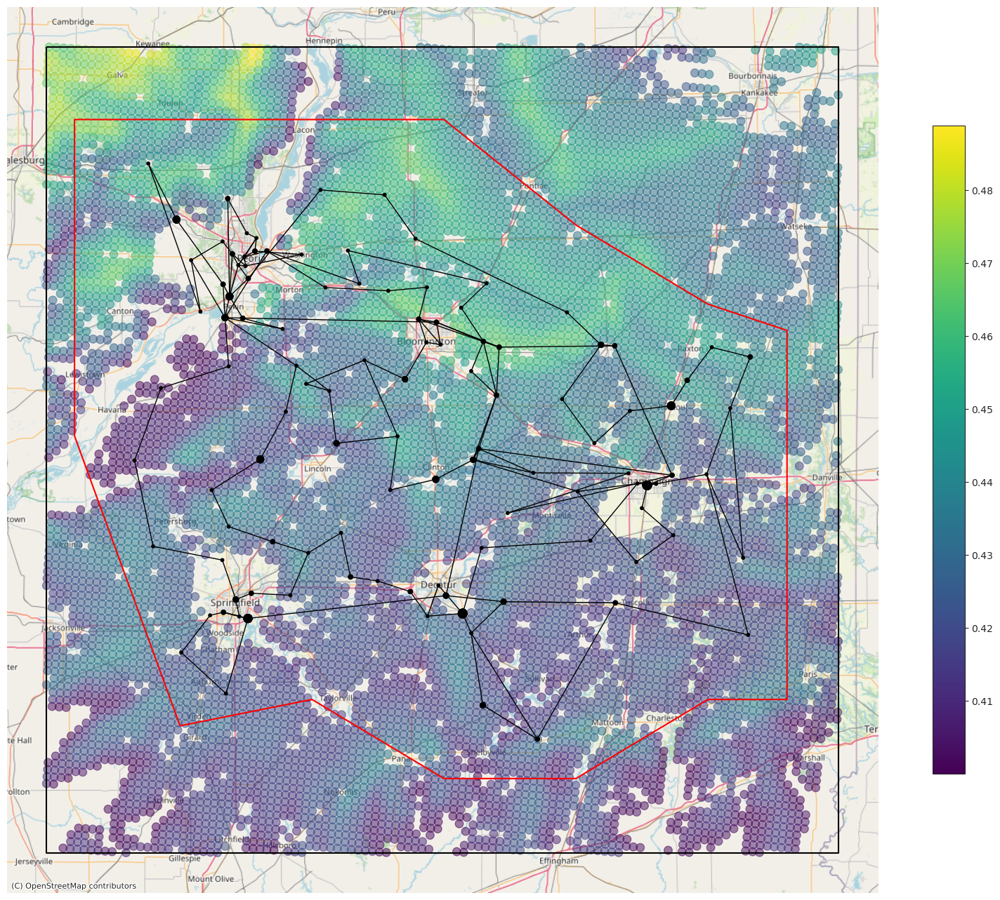

In [37]:
####################################################
#### plot with tighter Voronoi polygon boundary

high_gdf = high_gdf.to_crs("epsg:3857")
# plt.figure(figsize=(20, 20))
ax = high_gdf.plot(
    figsize=(20, 20),
    markersize=70,
    column="cf_mean",
    legend=True,
    legend_kwds={
        "shrink": 0.6,
    },
    alpha=0.5,
    cmap="viridis",
)


# Web Mercator
# rts_box_gdf = rts_box_gdf.to_crs(epsg=3857)
bus_gdf = bus_gdf.to_crs(epsg=3857)
br_gdf = br_gdf.to_crs(epsg=3857)
# bus_gdf.plot(ax=ax, color="black",  markersize = 5)
bus_gdf.plot(ax=ax, color="black", markersize="size")

br_gdf.plot(ax=ax, color="black", linewidth=1)


# ####### based on project points, draw a box (OPTIONAL)
# top = pps_df["latitude"].max()
# bottom = pps_df["latitude"].min()
# left = pps_df["longitude"].min()
# right = pps_df["longitude"].max()

# lat_point_list = [top, top, bottom, bottom]
# lon_point_list = [left, right, right, left]

# polygon_geom = Polygon(zip(lon_point_list, lat_point_list))
# polygon_geom = Polygon([(left, top), (right, top), (right, bottom), (left, bottom)])

# # “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
# tamu_box_gdf = gpd.GeoDataFrame(index=[0], crs="epsg:4326", geometry=[polygon_geom])
# # print(polygon.geometry)

tamu_box_gdf = tamu_box_gdf.to_crs("epsg:3857")
tamu_box_gdf.boundary.plot(ax=ax, alpha=1, edgecolor="k")

tamu_polygon_gdf.boundary.plot(ax=ax, alpha=1, edgecolor="r")

####### add map tile
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

### save figure in work dir (since this is the same for all buildout options)
ax.set_axis_off()
filename = os.path.join(work_dir, "voronoi_boundary.png")
plt.savefig(filename, bbox_inches="tight", pad_inches=0)

In [38]:
############################################
#### create voronoi polygons
#### based on boundary (tamu_polygon_gdf) and points (points_gdf)

### old way
# boundary = tamu_box_gdf
### new way
boundary = tamu_polygon_gdf

# Web Mercator# this works with ctx background
boundary = boundary.to_crs(epsg=3857)


### index 0..111 will then correspond to poly_to_pt_assignments
### i.e., inxex 0 will be pt 0

# Geovoronoi needs certain format
# boundary into a usion of polygons
# boundary_shape = cascaded_union(boundary.geometry)
boundary_shape = unary_union(boundary.geometry)

# geopandas GeoSeries of Point objects to NumPy array of coordinates
# I could do it straight from bus_df, but oh well

coords = points_to_coords(points_gdf.geometry)

# # Calculate Voronoi Regions when geovoronoi.__version__ = 0.2.0
# poly_shapes, pts, poly_to_pt_assignments = voronoi_regions_from_coords(
#     coords, boundary_shape
# )

# Calculate Voronoi Regions when geovoronoi.__version__ = 0.4.0
poly_shapes, pts = voronoi_regions_from_coords(coords, boundary_shape)

In [39]:
# #### use only with geovoronoi version 0.4.0 ####
#####################################################################################
#### create vor_gdf that will contain polygon geometries corresponding to points_gdf
#### gdf is easier to use/plot

# turn voronoi polygons into gdf
vor_gdf = gpd.GeoDataFrame(
    crs="epsg:3857",
    geometry=list(poly_shapes.values()),
)

### polygons in poly_shapes are shuffled
### their corresponding points are in "pts" variable when using version 0.4.0
vor_gdf["vor_idx"] = pd.Series(pts).apply(lambda x: x[0])
vor_gdf.set_index("vor_idx", inplace=True)

vor_gdf["first_bus"] = points_gdf["first_bus"]

vor_gdf["Latitude"] = points_gdf["Latitude"]
vor_gdf["Longitude"] = points_gdf["Longitude"]

vor_gdf.sort_index(inplace=True)


# #### save vor_gdf
# filename = "vor_gdf.csv"
# vor_gdf.to_csv(os.path.join(buildout_dir, filename))

print("\n vor_idx corresponts to pt_idx in points_gdf \n vor_gdf:")

vor_gdf


 vor_idx corresponts to pt_idx in points_gdf 
 vor_gdf:


,geometry,first_bus,Latitude,Longitude
vor_idx,,,,
0,"POLYGON ((-9968402.192 4963402.038, -9961604.3...",1,40.642116,-89.599560
1,"POLYGON ((-9928617.310 4856698.678, -9941824.7...",3,39.866030,-89.251291
2,"POLYGON ((-9816850.173 4937506.501, -9795753.0...",5,40.378337,-88.105151
3,"POLYGON ((-9969296.246 4964677.761, -9969383.7...",7,40.712882,-89.576722
...,...,...,...,...
107,"POLYGON ((-9836619.139 4951507.862, -9856670.9...",189,40.470500,-88.398700
108,"POLYGON ((-9987946.507 4952281.846, -9993611.0...",192,40.556403,-89.762073
109,"POLYGON ((-9795753.077 4921834.887, -9793568.9...",193,40.306027,-87.958606
110,"POLYGON ((-9997300.799 4898942.853, -10006110....",194,40.169931,-89.986537


In [40]:
# #### use only with geovoronoi version 0.2.0 ####
# #####################################################################################
# #### create vor_gdf that will contain polygon geometries corresponding to points_gdf
# #### gdf is easier to use/plot geovoronoi version 0.2.0

# # turn voronoi polygons into gdf
# vor_gdf = gpd.GeoDataFrame(
#     crs="epsg:3857",
#     geometry=poly_shapes,
# )


# ### polygons in poly_shapes are shuffled
# ### their corresponding points are in poly_to_pt_assignments version 0.2.0
# vor_gdf["vor_idx"] = [pt[0] for pt in poly_to_pt_assignments]


# vor_gdf.set_index("vor_idx", inplace=True)

# vor_gdf["first_bus"] = points_gdf["first_bus"]

# vor_gdf["Latitude"] = points_gdf["Latitude"]
# vor_gdf["Longitude"] = points_gdf["Longitude"]

# vor_gdf.sort_index(inplace=True)


# # #### save vor_gdf
# # filename = "vor_gdf.csv"
# # vor_gdf.to_csv(os.path.join(buildout_dir, filename))

# print("\n vor_idx corresponts to pt_idx in points_gdf \n vor_gdf:")

# vor_gdf

In [41]:
######################################################
#### add all bus numbers that belong to same polygon
#### will be used when picking the connection bus

### we need this to insert lists (objects) into dataframe's cells
vor_gdf["bus_num_list"] = np.nan
vor_gdf["bus_num_list"] = vor_gdf["bus_num_list"].astype("object")

### add all bus numbers that belong to same polygon
for vor_idx in vor_gdf.index[:]:
    lat = vor_gdf.loc[vor_idx, "Latitude"]
    lon = vor_gdf.loc[vor_idx, "Longitude"]
    # bus_df.loc[(bus_df["Latitude"] == lat) & (bus_df["Longitude"] == lon)]
    bus_num_list = bus_df.loc[
        (bus_df["Latitude"] == lat) & (bus_df["Longitude"] == lon)
    ]["BusNum"].values.tolist()
    # bus_num_list
    vor_gdf.at[vor_idx, "bus_num_list"] = bus_num_list

vor_gdf


# ##### another way of doing above using fancier groupby + aggregate
# df = bus_df[["BusNum", "Latitude", "Longitude"]]
# # df.set_index("BusNum", inplace=True)

# # df.groupby(["Latitude", "Longitude"]).set()
# vor_df = df.groupby(["Latitude", "Longitude"], as_index=False)["BusNum"].agg(
#     {"BusNumList": (lambda x: list(x))}
# )

,geometry,first_bus,Latitude,Longitude,bus_num_list
vor_idx,,,,,
0,"POLYGON ((-9968402.192 4963402.038, -9961604.3...",1,40.642116,-89.599560,"[1, 2]"
1,"POLYGON ((-9928617.310 4856698.678, -9941824.7...",3,39.866030,-89.251291,"[3, 4]"
2,"POLYGON ((-9816850.173 4937506.501, -9795753.0...",5,40.378337,-88.105151,"[5, 6]"
3,"POLYGON ((-9969296.246 4964677.761, -9969383.7...",7,40.712882,-89.576722,"[7, 8]"
...,...,...,...,...,...
107,"POLYGON ((-9836619.139 4951507.862, -9856670.9...",189,40.470500,-88.398700,"[189, 190, 191]"
108,"POLYGON ((-9987946.507 4952281.846, -9993611.0...",192,40.556403,-89.762073,[192]
109,"POLYGON ((-9795753.077 4921834.887, -9793568.9...",193,40.306027,-87.958606,[193]
110,"POLYGON ((-9997300.799 4898942.853, -10006110....",194,40.169931,-89.986537,[194]


<Figure size 640x480 with 0 Axes>

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<Figure size 640x480 with 0 Axes>

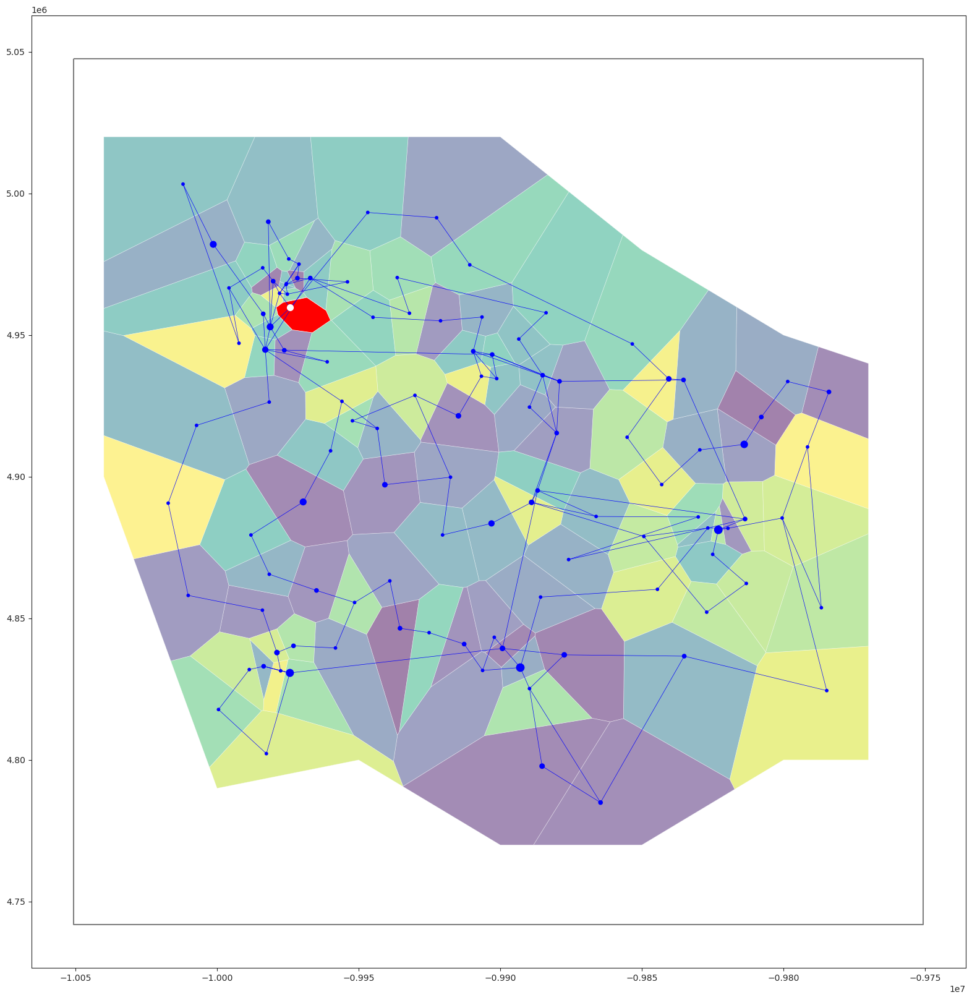

In [42]:
################################
##### plot vor_gdf (new way)
plt.figure()

ax = tamu_box_gdf.boundary.plot(figsize=(20, 20), alpha=0.5, edgecolor="k")

# ##########Voronoi polygons from vor_gdf
vor_gdf.plot(ax=ax, cmap="viridis", linewidth=0.5, alpha=0.5)

# bus_unique_gdf.plot(ax=ax, color="blue", markersize = 1)
bus_unique_gdf.plot(ax=ax, color="blue", markersize="size")
# bus_wind_unique_gdf.plot(ax=ax, color="red", markersize = 5)
br_gdf.plot(ax=ax, color="blue", linewidth=0.5)


################ verify vor_idx coresponds to pt_idx and
################ we match num_bus_list numbrs (also use bokeh plot for that)
### plot one specific polygon
vor_idx = 0
vor_gdf.loc[vor_idx:vor_idx].plot(
    ax=ax,
    color="red",
    linewidth=0.5,
)
### plot one specific point location
points_gdf.loc[vor_idx:vor_idx].plot(ax=ax, color="white", markersize=50, zorder=5)

# ##########Voronoi polygons plotting (old way)
# colors_n = 20
# color_array = plt.get_cmap("tab20")(range(colors_n))
# # crs = {"init": "epsg:3395"}
# # plot Vorponoi shapes
# for k, polygon in enumerate(poly_shapes[:]):

#     piece_gdf = gpd.GeoDataFrame(index=[0], crs="epsg:3857", geometry=[poly_shapes[k]],)
#     color = color_array[k % colors_n]
#     _ = piece_gdf.plot(ax=ax, alpha=0.4, color=color)

# ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)


# ax.set_axis_off()
# #plt.savefig('./pics/grid_and_vor.png',  bbox_inches='tight', pad_inches=0  )

In [43]:
s = high_gdf.within(vor_gdf.loc[vor_idx, "geometry"])

s = high_gdf.within(tamu_polygon_gdf.loc[0, "geometry"])
# tamu_polygon_gdf.boundary.plot(ax=ax, alpha=1, edgecolor="r")
s
s[s].index

gid
1616335     True
1616336     True
1616337     True
1616338     True
           ...  
1690944    False
1690945    False
1690946    False
1690947    False
Length: 10170, dtype: bool

Index([1616335, 1616336, 1616337, 1616338, 1616339, 1617489, 1617490, 1617491,
       1617492, 1617493,
       ...
       1690924, 1690925, 1690926, 1690927, 1690928, 1690931, 1690932, 1690935,
       1690936, 1690937],
      dtype='int64', name='gid', length=6092)

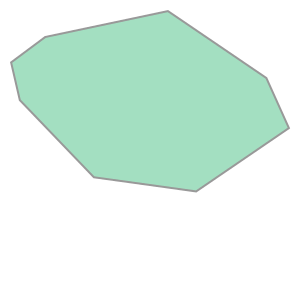

In [44]:
vor_gdf.loc[vor_idx, "geometry"]

<Figure size 640x480 with 0 Axes>

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<Figure size 640x480 with 0 Axes>

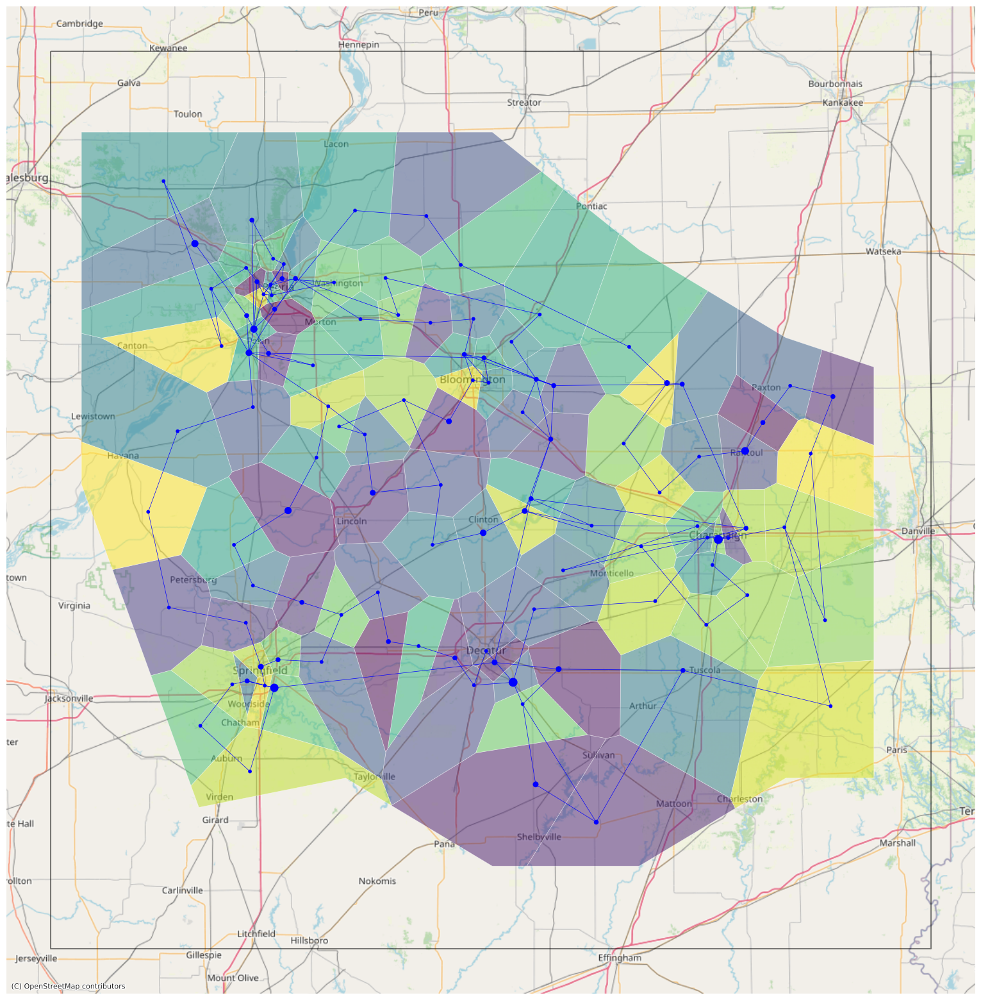

In [45]:
################################
##### plot vor_gdf (new way)
plt.figure()

ax = tamu_box_gdf.boundary.plot(figsize=(20, 20), alpha=0.5, edgecolor="k")

# ##########Voronoi polygons from vor_gdf
vor_gdf.plot(ax=ax, cmap="viridis", linewidth=0.5, alpha=0.5)

# bus_unique_gdf.plot(ax=ax, color="blue", markersize = 1)
bus_unique_gdf.plot(ax=ax, color="blue", markersize="size")
# bus_wind_unique_gdf.plot(ax=ax, color="red", markersize = 5)
br_gdf.plot(ax=ax, color="blue", linewidth=0.5)


# ################ verify vor_idx coresponds to pt_idx and
# ################ we match num_bus_list numbrs (also use bokeh plot for that)
# ### plot one specific polygon
# vor_idx=0
# vor_gdf.loc[vor_idx:vor_idx].plot(ax=ax, color="red", linewidth = 0.5, )
# ### plot one specific point location
# points_gdf.loc[vor_idx:vor_idx].plot(ax=ax, color="white", markersize = 50, zorder=5)


# ### just the sites inside voronoi boundary polygon
# s =high_gdf.within(tamu_polygon_gdf.loc[0,"geometry"])

# high_gdf.loc[s[s].index].plot(ax=ax,
#     #figsize=(20, 20),
#     markersize=10,
#     color="white",
# #     column="cf_mean",
# #     legend=True,
# #     legend_kwds={
# #         "shrink": 0.6,
# #     },
#     alpha=0.5,
# #    cmap="viridis",
# )


# tamu_box_gdf = tamu_box_gdf.to_crs("epsg:3857")
# tamu_box_gdf.boundary.plot(ax=ax, alpha=1, edgecolor="k")

# tamu_polygon_gdf.boundary.plot(ax=ax, alpha=1, edgecolor="r")

####### add map tile
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

### save figure in work dir (since this is the same for all buildout options)
ax.set_axis_off()
# filename = os.path.join(work_dir,"voronoi_polygons_with_sites.png")
filename = os.path.join(work_dir, "voronoi_polygons.png")
plt.savefig(filename, bbox_inches="tight", pad_inches=0)

[Exclusions](#exclusions)

* Voronoi
<a id='voronoi'></a>

[build](#build)

# buildout 
* all possible unique locations
* what is possible max wind buildout in all unique locations? 

## one polygon
* for testing purposes

In [46]:
## take one location
vor_idx = 0
print("\n voronoi polygon: vor_idx = 0")

buses_in_polygon = vor_gdf.loc[vor_idx, "bus_num_list"]
print(f"\n buses in this polygon: bus_num_list = {buses_in_polygon}")

### are there buses in the polygon with a true line connected to it (not trafo)


## sites within the polygon
# high_gdf.within(vor_gdf.loc[bus_num, "geometry"])
# s = high_gdf.within(vor_gdf.loc[vor_gdf["FirstBus"] == first_bus, "geometry"].values[0])
s = high_gdf.within(vor_gdf.loc[vor_idx, "geometry"])

#### check if there are any sites in the polygon at all
if not s.any():
    print("\n!!!!!!!! empty polygon: no sites within it!!!!!!!!!")
    ## in the loop we will simply "continue" onto the next polygon

gids_in_polygon = s[s].index
# print("\ngids of sites that are within the polygon:")
# gids_in_polygon

print(f"\nhigh_df sites within the vor_idx = {vor_idx} polygon:")
sites_in_polygon_df = high_gdf.loc[gids_in_polygon].copy()
sites_in_polygon_df


cap = sites_in_polygon_df["incl_capacity_mw"].sum()
gen = sites_in_polygon_df["incl_generation_mwh"].sum()

print(f"\ntotal included capacity in the polygon: {round(cap,2):,} MW")
print(f"\ntotal included generation in the polygon: {round(gen,2):,} MWh")


 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [1, 2]

high_df sites within the vor_idx = 0 polygon:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1617549,0.448055,40.619118,-89.550630,43174.530,POINT (-9968730.532 4956322.946),0.295455,12756.111136,3.250000
1618781,0.459942,40.599130,-89.528230,44320.023,POINT (-9966236.975 4953392.034),0.246570,10927.999060,2.712273
1618782,0.453301,40.617626,-89.526245,43680.050,POINT (-9966016.006 4956104.139),0.604743,26415.208103,6.652174
1620014,0.452637,40.597622,-89.503876,43616.120,POINT (-9963525.900 4953170.946),0.365613,15946.605138,4.021739
1620015,0.449459,40.616123,-89.501890,43309.883,POINT (-9963304.820 4955883.723),0.526860,22818.223481,5.795455
1616315,0.431813,40.602104,-89.576965,41609.457,POINT (-9971662.131 4953828.067),0.266529,11090.123870,2.931818



total included capacity in the polygon: 25.36 MW

total included generation in the polygon: 99,954.27 MWh


In [47]:
###############################################
##### sites in a set of polygons

vor_idxs = [6, 32, 51, 58, 64, 69, 81, 101]
all_df = pd.DataFrame()
for vor_idx in vor_idxs:
    # s = high_gdf.within(vor_gdf.loc[vor_idx, "geometry"])
    s = high_gdf.within(vor_gdf.loc[vor_idx, "geometry"])

    #     #### check if there are any sites in the polygon at all
    #     if not s.any():
    #         print("\n!!!!!!!! empty polygon: no sites within it!!!!!!!!!")
    #         ## in the loop we will simply "continue" onto the next polygon

    gids_in_polygon = s[s].index
    # print("\ngids of sites that are within the polygon:")
    # gids_in_polygon

    # print(f"\nhigh_df sites within the vor_idx = {vor_idx} polygon:")
    sites_in_polygon_df = high_gdf.loc[gids_in_polygon].copy()
    # sites_in_polygon_df
    all_df = pd.concat([all_df, sites_in_polygon_df])

print(f"\n high sites in polygons {vor_idxs}")
all_df


 high sites in polygons [6, 32, 51, 58, 64, 69, 81, 101]


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1658080,0.419505,39.846400,-88.832275,40423.457,POINT (-9888763.619 4843646.587),0.452479,18290.779097,4.977273
1651961,0.418593,39.799225,-88.958860,40335.633,POINT (-9902854.997 4836808.954),0.260331,10500.598674,2.863636
1653184,0.421945,39.779133,-88.936950,40658.620,POINT (-9900415.987 4833898.207),0.361570,14700.947314,3.977273
1656858,0.416320,39.848057,-88.856320,40116.617,POINT (-9891440.296 4843886.841),0.272727,10940.895545,3.000000
...,...,...,...,...,...,...,...,...
1656873,0.429121,40.125042,-88.823910,41350.090,POINT (-9887832.431 4884129.715),0.485826,20088.967278,5.344091
1656874,0.427004,40.143520,-88.821720,41146.066,POINT (-9887588.642 4886820.186),0.231405,9521.403702,2.545455
1656875,0.428194,40.161983,-88.819550,41260.766,POINT (-9887347.078 4889509.203),0.270751,11171.393166,2.978261
1656876,0.432484,40.180454,-88.817380,41674.145,POINT (-9887105.515 4892200.118),0.334711,13948.784070,3.681818


<AxesSubplot: >

<AxesSubplot: >

/projects/hpcapps/isatkaus/conda-envs/buildouts/lib/python3.11/site-packages/geopandas/plotting.py:730: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead



<AxesSubplot: >

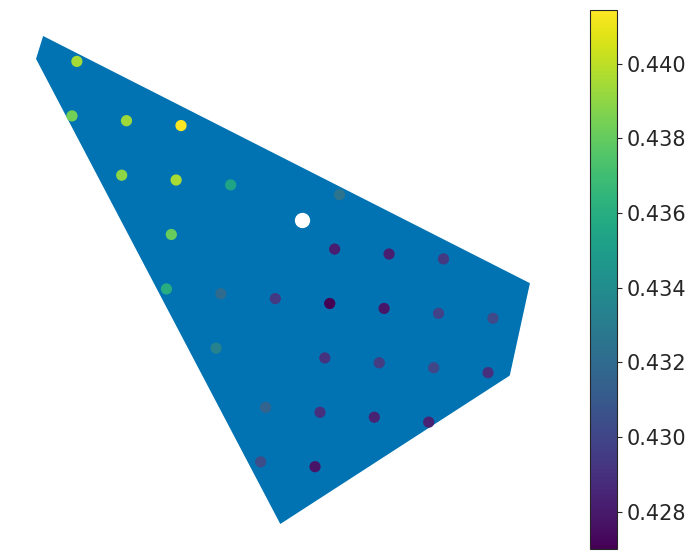

In [48]:
############################################
################# plot one polygon with sites and corresponding bus

fig = plt.figure(figsize=(9, 7))
ax = fig.add_subplot(111)

## polygon
vor_gdf.loc[vor_idx:vor_idx].plot(
    ax=ax,
)

## first_bus or polygon point
# bus_gdf.loc[first_bus:first_bus].plot(ax=ax, color="red", markersize=100, zorder=3)
# wind_gen_location_gdf.loc[wind_gen_location_gdf["FirstBus"]==first_bus].plot(ax=ax, color="red", markersize=100, zorder=3)
points_gdf.loc[vor_idx:vor_idx].plot(ax=ax, markersize=100, color="white")

## sites whithin the polygon
high_gdf.loc[gids_in_polygon].plot(
    ax=ax,
    column="cf_mean",
    cmap="viridis",
    legend=True,
    markersize=50,
    # color="black",
)


ax.set_axis_off()
# change color bar
fig = ax.figure
# # 0'th is for the map, 1st is for colorbar
cb_ax = fig.axes[1]
cb_ax.tick_params(labelsize=15)
# cb_ax.set_ylim((350.0, 500))
# cb_ax.set_ybound((350.0, 500))

# ###
# save_dir = os.path.join(run_dir,"figures")
# filename = "one_polygon_all_sites.png"
# plt.savefig(os.path.join(save_dir,filename),  bbox_inches='tight',   )

In [49]:
#####################################################
### info
### what type of branches bus (e.g., in polygon) has?

bus_num = 163
bus_branch_idxs = branch_df.loc[
    (branch_df["FromBus"] == bus_num) | (branch_df["ToBus"] == bus_num)
].index
bus_branch_idxs
### any of them not a trafo?
print("\n any branches to/from this bus are lines (not trafos)?")
(~branch_df.loc[bus_branch_idxs, "trafo"]).any()
print("\n lines (not trafos) on this bus:")
s = ~branch_df.loc[bus_branch_idxs, "trafo"]
s[s].index

Index([219], dtype='int64', name='UID')


 any branches to/from this bus are lines (not trafos)?


False


 lines (not trafos) on this bus:


Index([], dtype='int64', name='UID')

In [50]:
######################################################################
#### connection dictionary: vor_bus_dict
#### record "connectable" buses in polygons, i.e. buses with lines (not trafos)
#### {vor_idx:[(bus_num, # of lines), (bus_num, # of lines), ..], vor_idx:[(),(),..], ...}
#### based on this dict we will connect wind buses in polygon
#### check if all polygons have connectable bus

vor_bus_dict = {}
for vor_idx in vor_gdf.index[:]:
    #     print("##########################################")
    #     print(f"\n polygon vor_idx = {vor_idx} has buses:")
    #     vor_gdf.loc[vor_idx,"bus_num_list"]

    bus_line_list = []
    for bus_num in vor_gdf.loc[vor_idx, "bus_num_list"]:
        bus_branch_idxs = branch_df.loc[
            (branch_df["FromBus"] == bus_num) | (branch_df["ToBus"] == bus_num)
        ].index
        # bus_branch_idxs
        ### any of them not a trafo?
        # print("\n any branches to/from this bus are lines (not trafos)?")
        s = ~branch_df.loc[bus_branch_idxs, "trafo"]
        if s.any():
            lines_on_bus = s[s].index
            bus_line_list.append((bus_num, len(lines_on_bus)))

    vor_bus_dict[vor_idx] = bus_line_list


print("\n vor_bus_dict:")
print(
    "\n {vor_idx:[(bus_num inside polygon (first), number of lines(not trafos) at that bus),..], ..}"
)
vor_bus_dict


print("\n all polygons have connectable bus?")
len(list(vor_bus_dict.keys())) == len(vor_gdf)


 vor_bus_dict:

 {vor_idx:[(bus_num inside polygon (first), number of lines(not trafos) at that bus),..], ..}


{0: [(1, 3)],
 1: [(3, 2)],
 2: [(5, 2)],
 3: [(7, 3)],
 4: [(9, 4)],
 5: [(11, 3)],
 6: [(14, 2), (15, 1)],
 7: [(17, 2)],
 8: [(22, 2)],
 9: [(25, 2)],
 10: [(27, 3)],
 11: [(29, 2)],
 12: [(31, 2)],
 13: [(34, 2)],
 14: [(36, 2)],
 15: [(39, 2)],
 16: [(41, 3)],
 17: [(42, 2)],
 18: [(43, 2)],
 19: [(44, 2)],
 20: [(45, 3), (46, 2)],
 21: [(47, 2)],
 22: [(48, 2)],
 23: [(54, 3)],
 24: [(55, 5), (56, 1)],
 25: [(57, 2)],
 26: [(58, 3)],
 27: [(59, 2)],
 28: [(60, 2)],
 29: [(61, 2)],
 30: [(62, 2)],
 31: [(63, 2)],
 32: [(64, 2)],
 33: [(65, 4)],
 34: [(73, 2)],
 35: [(74, 2)],
 36: [(79, 2)],
 37: [(80, 2), (81, 1)],
 38: [(82, 3)],
 39: [(83, 2)],
 40: [(84, 2)],
 41: [(85, 4)],
 42: [(86, 1), (87, 3)],
 43: [(88, 2)],
 44: [(92, 3)],
 45: [(94, 2)],
 46: [(95, 3)],
 47: [(96, 2)],
 48: [(97, 1), (98, 1)],
 49: [(99, 5)],
 50: [(100, 5)],
 51: [(101, 3), (102, 3)],
 52: [(103, 2)],
 53: [(104, 3)],
 54: [(105, 2)],
 55: [(106, 2)],
 56: [(107, 2)],
 57: [(108, 2)],
 58: [(109, 2),


 all polygons have connectable bus?


True

In [51]:
####################################################
##### record included capacity and generation of vor polygons
##### how much can we build?

for vor_idx in vor_gdf.index[:]:
    ## take one location
    print("\n voronoi polygon: vor_idx = 0")

    buses_in_polygon = vor_gdf.loc[vor_idx, "bus_num_list"]
    print(f"\n buses in this polygon: bus_num_list = {buses_in_polygon}")

    ### are there buses in the polygon with a true line connected to it (not trafo)

    ## sites within the polygon
    # high_gdf.within(vor_gdf.loc[bus_num, "geometry"])
    # s = high_gdf.within(vor_gdf.loc[vor_gdf["FirstBus"] == first_bus, "geometry"].values[0])
    s = high_gdf.within(vor_gdf.loc[vor_idx, "geometry"])

    #### check if there are any sites in the polygon at all
    if not s.any():
        print("\n !!!!!!!! empty polygon: no sites within it!!!!!!!!!")
        ## in the loop we will simply "continue" onto the next polygon

    gids_in_polygon = s[s].index
    # print("\ngids of sites that are within the polygon:")
    # gids_in_polygon

    print("\n high_df sites within the polygon:")
    sites_in_polygon_df = high_gdf.loc[gids_in_polygon].copy()
    # sites_in_polygon_df

    cap = sites_in_polygon_df["incl_capacity_mw"].sum()
    gen = sites_in_polygon_df["incl_generation_mwh"].sum()

    print(f"\n total included capacity in the polygon: {round(cap,2):,} MW")
    print(f"\n total included generation in the polygon: {round(gen,2):,} MWh")

    ### record polygon capacity and generation
    vor_gdf.loc[vor_idx, "incl_capacity_mw"] = cap
    vor_gdf.loc[vor_idx, "incl_generation_mwh"] = gen


print("\n vor polygons with capacity and generation:")
vor_gdf


 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [1, 2]

 high_df sites within the polygon:

 total included capacity in the polygon: 25.36 MW

 total included generation in the polygon: 99,954.27 MWh

 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [3, 4]

 high_df sites within the polygon:

 total included capacity in the polygon: 273.35 MW

 total included generation in the polygon: 1,010,642.16 MWh

 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [5, 6]

 high_df sites within the polygon:

 total included capacity in the polygon: 189.71 MW

 total included generation in the polygon: 733,644.6 MWh

 voronoi polygon: vor_idx = 0

 buses in this polygon: bus_num_list = [7, 8]

 !!!!!!!! empty polygon: no sites within it!!!!!!!!!

 high_df sites within the polygon:

 total included capacity in the polygon: 0.0 MW

 total included generation in the polygon: 0.0 MWh

 voronoi polygon: vor_idx = 0

 buses in this polygon: b

,geometry,first_bus,Latitude,Longitude,bus_num_list,incl_capacity_mw,incl_generation_mwh
vor_idx,,,,,,,
0,"POLYGON ((-9968402.192 4963402.038, -9961604.3...",1,40.642116,-89.599560,"[1, 2]",25.363458,9.995427e+04
1,"POLYGON ((-9928617.310 4856698.678, -9941824.7...",3,39.866030,-89.251291,"[3, 4]",273.345169,1.010642e+06
2,"POLYGON ((-9816850.173 4937506.501, -9795753.0...",5,40.378337,-88.105151,"[5, 6]",189.714763,7.336446e+05
3,"POLYGON ((-9969296.246 4964677.761, -9969383.7...",7,40.712882,-89.576722,"[7, 8]",0.000000,0.000000e+00
...,...,...,...,...,...,...,...
107,"POLYGON ((-9836619.139 4951507.862, -9856670.9...",189,40.470500,-88.398700,"[189, 190, 191]",180.146889,7.066337e+05
108,"POLYGON ((-9987946.507 4952281.846, -9993611.0...",192,40.556403,-89.762073,[192],114.995059,4.170064e+05
109,"POLYGON ((-9795753.077 4921834.887, -9793568.9...",193,40.306027,-87.958606,[193],454.489589,1.731706e+06
110,"POLYGON ((-9997300.799 4898942.853, -10006110....",194,40.169931,-89.986537,[194],500.058172,1.803667e+06


In [52]:
####################################################
#### info
#### how many polygons meet min build capacity
#### what is total available generation

min_build_cap = 25

df = vor_gdf.loc[vor_gdf["incl_capacity_mw"] > min_build_cap]
print(
    f"\n number of polygons meeting min build capacity of {min_build_cap} MW: {len(df)} out of {len(vor_gdf)} "
)


orig_cap_mw = gen_df["GenMWMax"].sum()
print(f"\n original generation capacity: {round(orig_cap_mw):,} MW")
avail_cap_mw = df["incl_capacity_mw"].sum()
print(
    f"\n available generation capacity: {round(avail_cap_mw):,} MW (~{round(avail_cap_mw/orig_cap_mw)} times total original cap)"
)

print(f"\n total {grid_name} loadP: {round(total_load_mwh):,} MWh")
avail_gen_mwh = df["incl_generation_mwh"].sum()
print(f"\n available generation: {round(avail_gen_mwh):,} MWh")


 number of polygons meeting min build capacity of 25 MW: 88 out of 111 

 original generation capacity: 2,903 MW

 available generation capacity: 28,551 MW (~10 times total original cap)

 total ACTIVSg200 loadP: 8,949,170 MWh

 available generation: 107,860,810 MWh


In [53]:
###########################################
#### decide on connection buses
#### {vor_idx:[(bus_num, # of lines), (bus_num, # of lines), ..], vor_idx:[(),(),..], ...}
#### vor_bus_dict contains all buses inside each polygon and
#### the number of lines (not trafos) connected to them
#### first option: select the connection bus as the bus with most lines connected to it
from operator import itemgetter

vor_gdf["connect_bus"] = 0
# vor_gdf["connect_bus"] = vor_gdf["connect_bus"].astype("int")
for vor_idx in vor_gdf.index[:]:
    print(f"\n vor_idx = {vor_idx}")
    bus_list = vor_bus_dict.get(vor_idx)
    ### gen the bus with max lines
    bus_num, max_n_lines = max(bus_list, key=itemgetter(1))
    print(
        f"\n bus {bus_num} has {max_n_lines} lines(not trafos) connected to it, making it connection bus"
    )
    vor_gdf.loc[vor_idx, "connect_bus"] = bus_num

print(f"\n vor_gdf with connect_bus column:")
vor_gdf


 vor_idx = 0

 bus 1 has 3 lines(not trafos) connected to it, making it connection bus

 vor_idx = 1

 bus 3 has 2 lines(not trafos) connected to it, making it connection bus

 vor_idx = 2

 bus 5 has 2 lines(not trafos) connected to it, making it connection bus

 vor_idx = 3

 bus 7 has 3 lines(not trafos) connected to it, making it connection bus

 vor_idx = 4

 bus 9 has 4 lines(not trafos) connected to it, making it connection bus

 vor_idx = 5

 bus 11 has 3 lines(not trafos) connected to it, making it connection bus

 vor_idx = 6

 bus 14 has 2 lines(not trafos) connected to it, making it connection bus

 vor_idx = 7

 bus 17 has 2 lines(not trafos) connected to it, making it connection bus

 vor_idx = 8

 bus 22 has 2 lines(not trafos) connected to it, making it connection bus

 vor_idx = 9

 bus 25 has 2 lines(not trafos) connected to it, making it connection bus

 vor_idx = 10

 bus 27 has 3 lines(not trafos) connected to it, making it connection bus

 vor_idx = 11

 bus 29 h

,geometry,first_bus,Latitude,Longitude,bus_num_list,incl_capacity_mw,incl_generation_mwh,connect_bus
vor_idx,,,,,,,,
0,"POLYGON ((-9968402.192 4963402.038, -9961604.3...",1,40.642116,-89.599560,"[1, 2]",25.363458,9.995427e+04,1
1,"POLYGON ((-9928617.310 4856698.678, -9941824.7...",3,39.866030,-89.251291,"[3, 4]",273.345169,1.010642e+06,3
2,"POLYGON ((-9816850.173 4937506.501, -9795753.0...",5,40.378337,-88.105151,"[5, 6]",189.714763,7.336446e+05,5
3,"POLYGON ((-9969296.246 4964677.761, -9969383.7...",7,40.712882,-89.576722,"[7, 8]",0.000000,0.000000e+00,7
...,...,...,...,...,...,...,...,...
107,"POLYGON ((-9836619.139 4951507.862, -9856670.9...",189,40.470500,-88.398700,"[189, 190, 191]",180.146889,7.066337e+05,189
108,"POLYGON ((-9987946.507 4952281.846, -9993611.0...",192,40.556403,-89.762073,[192],114.995059,4.170064e+05,192
109,"POLYGON ((-9795753.077 4921834.887, -9793568.9...",193,40.306027,-87.958606,[193],454.489589,1.731706e+06,193
110,"POLYGON ((-9997300.799 4898942.853, -10006110....",194,40.169931,-89.986537,[194],500.058172,1.803667e+06,194


## make new wind_gen_df
* using max available capacity
* later we will limit it depending on wanted total capacity
* will add new buses and trafos so these df's will change:
* bus_df, gen_df, wind_gen_df, branch_df

In [54]:
# ####################################
# #### how much wind can we build where original wind gens were

# s = old_wind_gen_df["BusNum"].values
# s
# wanted_vor_idxs = []
# for wind_bus in s:
#     for vor_idx in vor_gdf.index[:]:
#         bus_num_list = vor_gdf.loc[vor_idx, "bus_num_list"]
#         if wind_bus in bus_num_list:
#             wanted_vor_idxs.append(vor_idx)

# df = vor_gdf.loc[wanted_vor_idxs, ["bus_num_list", "incl_capacity_mw"]].copy()
# df["wind_bus"] = s
# df["GenMWMax"] = old_wind_gen_df["GenMWMax"].values
# df

In [55]:
######################################################
#### first filter
#### filter wind gens by min/max available generation cap
#### max number does not really make sense here, since
#### we can cap it when selecting the sites
####
### BusNum, GenUID, BusName columns will be set later
### once we have have final wind_gen_df (after e.g., after random sample)

########################
##### buildout params
##### min/max capacity for one gen
min_build_cap = 20
max_build_cap = 600

#### polygons with less that 25MW will not get a generator
#### later the actual cap in MW can might be smaller
#### because of required penetration is covered by large number of gens

# min_build_cap = 25

df = vor_gdf.loc[
    (vor_gdf["incl_capacity_mw"] > min_build_cap)
    & (vor_gdf["incl_capacity_mw"] < max_build_cap)
]
print(
    f"\n number of polygons meeting min build capacity of {min_build_cap} MW: {len(df)} out of {len(vor_gdf)} "
)

min_cap_vor_idxs = df.index
print("\n voronoi polygons meeting min/max cap:")
min_cap_vor_idxs

### preallocate new wind_gen_df
df = pd.DataFrame(index=min_cap_vor_idxs, columns=old_wind_gen_df.columns)

###
# ### new gen will get a new bus, start with len(bus_df)
# new_bus_num = len(bus_df)
# ### preallocate
# vor_gdf["new_bus_num"]=0

#### building new wind gens
print("\n building new wind gens:")
for vor_idx in min_cap_vor_idxs[:]:
    print(f"\n vor_idx = {vor_idx}")
    #     ###
    #     new_bus_num+=1
    #     ### new bus with wind gen on it
    #     df.loc[vor_idx,"BusNum"]=new_bus_num
    #     ### record to vor_gdf too
    #     vor_gdf.loc[vor_idx,"new_bus_num"]=new_bus_num

    ### not really needed
    df.loc[vor_idx, "GenID"] = 1
    df.loc[vor_idx, "GenMWMax"] = vor_gdf.loc[vor_idx, "incl_capacity_mw"]
    df.loc[vor_idx, "GenMWMin"] = 0
    ### include also annual generation (later we will drop it)
    df.loc[vor_idx, "incl_generation_mwh"] = vor_gdf.loc[vor_idx, "incl_generation_mwh"]
    df.loc[vor_idx, "GenWindPowerFactor"] = 1
    df.loc[vor_idx, "GenFuelType"] = "Wind"
    ###
    # df.loc[vor_idx,"GenUID"]=f"{new_bus_num}_Wind_1"
    # df.loc[vor_idx,"BusName"]=f"NEWWIND{new_bus_num}"

    first_bus = vor_gdf.loc[vor_idx, "first_bus"]
    print(f"\n first_bus = {first_bus}")
    lat, lon, zone = bus_df.loc[
        bus_df["BusNum"] == first_bus, ["Latitude", "Longitude", "Zone"]
    ].values[0]
    df.loc[vor_idx, "Latitude"] = lat
    df.loc[vor_idx, "Longitude"] = lon
    df.loc[vor_idx, "Zone"] = int(zone)


wind_gen_df = df
### reset index
wind_gen_df.reset_index(inplace=True)

# ### set correct types
# int_columns = ["BusNum","GenID","Zone"]
# float_columns = ["GenMWMax","GenMWMin","GenWindPowerFactor","Latitude","Longitude","incl_generation_mwh"]
# wind_gen_df[int_columns]=wind_gen_df[int_columns].astype("int")
# wind_gen_df[float_columns]=wind_gen_df[float_columns].astype("float")


 number of polygons meeting min build capacity of 20 MW: 78 out of 111 

 voronoi polygons meeting min/max cap:


Index([  0,   1,   2,   7,   9,  11,  12,  13,  14,  15,  17,  18,  20,  21,
        22,  23,  24,  25,  26,  28,  29,  30,  31,  32,  33,  34,  35,  36,
        37,  38,  39,  40,  43,  45,  46,  47,  48,  51,  52,  53,  55,  58,
        60,  61,  62,  63,  65,  68,  70,  72,  73,  76,  77,  78,  79,  80,
        81,  83,  84,  86,  88,  90,  91,  92,  93,  94,  95,  96,  98,  99,
       100, 101, 102, 104, 107, 108, 109, 110],
      dtype='int64', name='vor_idx')


 building new wind gens:

 vor_idx = 0

 first_bus = 1

 vor_idx = 1

 first_bus = 3

 vor_idx = 2

 first_bus = 5

 vor_idx = 7

 first_bus = 17

 vor_idx = 9

 first_bus = 25

 vor_idx = 11

 first_bus = 29

 vor_idx = 12

 first_bus = 31

 vor_idx = 13

 first_bus = 34

 vor_idx = 14

 first_bus = 36

 vor_idx = 15

 first_bus = 39

 vor_idx = 17

 first_bus = 42

 vor_idx = 18

 first_bus = 43

 vor_idx = 20

 first_bus = 45

 vor_idx = 21

 first_bus = 47

 vor_idx = 22

 first_bus = 48

 vor_idx = 23

 first_bus = 54

 vor_idx = 24

 first_bus = 55

 vor_idx = 25

 first_bus = 57

 vor_idx = 26

 first_bus = 58

 vor_idx = 28

 first_bus = 60

 vor_idx = 29

 first_bus = 61

 vor_idx = 30

 first_bus = 62

 vor_idx = 31

 first_bus = 63

 vor_idx = 32

 first_bus = 64

 vor_idx = 33

 first_bus = 65

 vor_idx = 34

 first_bus = 73

 vor_idx = 35

 first_bus = 74

 vor_idx = 36

 first_bus = 79

 vor_idx = 37

 first_bus = 80

 vor_idx = 38

 first_bus = 82

 vor_idx = 39

 first

In [56]:
print("\n possible new wind_gen_df:")
wind_gen_df

#### show possible wind gens
plot_title = "possible new wind gen capacities"
wind_gen_df["GenMWMax"].iplot(kind="bar", yTitle="MW", title=plot_title)


 possible new wind_gen_df:


,vor_idx,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone,incl_generation_mwh
0,0,NaN,1,25.363458,0,1,Wind,NaN,NaN,40.642116,-89.59956,2,9.995427e+04
1,1,NaN,1,273.345169,0,1,Wind,NaN,NaN,39.86603,-89.251291,4,1.010642e+06
2,2,NaN,1,189.714763,0,1,Wind,NaN,NaN,40.378337,-88.105151,6,7.336446e+05
3,7,NaN,1,396.668698,0,1,Wind,NaN,NaN,40.17288,-89.558457,4,1.471180e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...
74,107,NaN,1,180.146889,0,1,Wind,NaN,NaN,40.4705,-88.3987,6,7.066337e+05
75,108,NaN,1,114.995059,0,1,Wind,NaN,NaN,40.556403,-89.762073,2,4.170064e+05
76,109,NaN,1,454.489589,0,1,Wind,NaN,NaN,40.306027,-87.958606,6,1.731706e+06
77,110,NaN,1,500.058172,0,1,Wind,NaN,NaN,40.169931,-89.986537,4,1.803667e+06


In [57]:
######################################################################
#### filter wind_gen_df by location (might need this in the future)
#### e.g., wind gens only above lat=4.90e6 (in Mercantor crs)

In [58]:
######################################################################
#### filter wind_gen_df by some other factor (might need this in the future)
#### e.g., no wind gens where loads are located (in the same polygon)

# buildout options
* adjust buildout parameters as needed

In [59]:
######################################################################
#### Option 2
#### filter wind_gen_df by selecting random number (in selected range) of generators
#### that meet some total wind capacity (in selected range)
buildout_option = 2
### random seed for n_gens (for reproducibility)
random_seed = 2
random.seed(random_seed)

### posible generator number range
n_gens_max = 20
n_gens_min = 10

### possible total capacity range
target_wind_cap = 2000
delta_wind_cap = 100

### sanity check?
### n_gens can be (after filtering by min/max capacity)
print(f"n_gens < max avail wind generators: {n_gens_max<len(wind_gen_df)}")

### randomly select n_gens in (n_gens_min, n_gens_max) until
### selected wind cap is around target wind cap (within delta)


################################################################
################################################################
max_iterations = 10e3
k = 0
while True:
    k += 1
    if k > max_iterations:
        print("\n max number of iterations reached without success!")
        break
    # random.seed(10)
    n_gens = random.randint(n_gens_min, n_gens_max)
    # print(f"\n sample n_gens: {n_gens}")
    sample_df = wind_gen_df.sample(n_gens, random_state=k)
    sample_cap = sample_df["GenMWMax"].sum()
    if (target_wind_cap - delta_wind_cap < sample_cap) and (
        sample_cap < target_wind_cap + delta_wind_cap
    ):
        print("\n Got it!")
        print(f"\n sample_cap = {round(sample_cap,2)} MW")
        break
print(f"\n wind_gen_df:")
wind_gen_df = sample_df.reset_index(drop=True)
wind_gen_df

#######################################################
################################################
#### check what penetration we got (if we select all sites)

total_load_mwh = loadP_df.sum().sum() / 12
print(f"\n total {grid_name} loadP (year 2017): {round(total_load_mwh):,} MWh")
# total_needed_cap_mw = total_load_mwh

max_avail_gen_mwh = wind_gen_df["incl_generation_mwh"].sum()
print(f"\n max available wind annual generation: {round(max_avail_gen_mwh):,} MWh")

resulting_penetration_level = max_avail_gen_mwh / total_load_mwh
print(f"\n resulting penetration level: {round(resulting_penetration_level,4)}")

n_gens < max avail wind generators: True

 Got it!

 sample_cap = 2091.34 MW

 wind_gen_df:


,vor_idx,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone,incl_generation_mwh
0,9,NaN,1,346.548122,0,1,Wind,NaN,NaN,40.438957,-87.890723,6,1.330968e+06
1,88,NaN,1,403.602513,0,1,Wind,NaN,NaN,40.329508,-88.530877,6,1.543654e+06
2,100,NaN,1,164.590336,0,1,Wind,NaN,NaN,40.416219,-89.43548,2,6.234729e+05
3,101,NaN,1,137.268369,0,1,Wind,NaN,NaN,40.1719,-88.8339,7,5.207443e+05
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6,40,NaN,1,215.29756,0,1,Wind,NaN,NaN,39.997432,-89.665941,4,8.159487e+05
7,29,NaN,1,150.906166,0,1,Wind,NaN,NaN,40.40231,-88.840561,7,5.889871e+05
8,45,NaN,1,392.338866,0,1,Wind,NaN,NaN,40.092849,-89.116222,7,1.460188e+06
9,58,NaN,1,64.095711,0,1,Wind,NaN,NaN,40.537,-89.019,7,2.562263e+05



 total ACTIVSg200 loadP (year 2017): 8,949,170 MWh

 max available wind annual generation: 7,978,306 MWh

 resulting penetration level: 0.8915


In [60]:
# random.seed(1)
# for k in range(10):
#     df = wind_gen_df.sample(3, random_state=1)
#     df
#     random.randint(n_gens_min,n_gens_max)

In [61]:
# ####################################################################
# #### limit wind_gen_df capacities to meet penetration level
# #### e.g., set 60% renewable penetration, that is 60% of load (mwh) a year is covered by
# #### wind if all of it is dispatched.


# #####################################################################################
# #### Option 1: use all wind gens (after min cap selection)
# #### let all wind gens produce the same amound of mwh's that sum to target_generation
# #### gen capacities will be sligtly different because of cap factors

# random_seed = None
# # ### choose penetration level
# penetration_level = 0.6

# total_load_mwh = loadP_df.sum().sum() / 12
# print(f"\n total {grid_name} loadP (year 2017): {round(total_load_mwh):,} MWh")
# #total_needed_cap_mw = total_load_mwh

# max_avail_gen_mwh = wind_gen_df["incl_generation_mwh"].sum()
# print(f"\n max available wind annual generation: {round(max_avail_gen_mwh):,} MWh")

# print(f"\n penetration level: {round(penetration_level,4)}")
# target_generation = total_load_mwh*penetration_level
# print(f"\n target generation: {round(target_generation):,} MWh")


# ### make all generators of equal size
# n_gens = len(wind_gen_df)
# print(f"\n total number of new gens: {n_gens}")

# ### n_gens have to all produce the same amount of energy
# mwh_per_gen = target_generation / n_gens
# print(f"\n each wind gen will produce {round(mwh_per_gen):,} MWh")

# ### factor to multiply capacities by
# x = mwh_per_gen / wind_gen_df["incl_generation_mwh"]

# ### new capacities
# new_cap = wind_gen_df["GenMWMax"] * x

# #### adjust wind_gen_df
# wind_gen_df["GenMWMax"]=new_cap
# wind_gen_df["incl_generation_mwh"]=mwh_per_gen


# ### final wind_gen_df
# print("\n final wind_gen_df:")
# wind_gen_df

In [62]:
wind_gen_df

,vor_idx,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone,incl_generation_mwh
0,9,NaN,1,346.548122,0,1,Wind,NaN,NaN,40.438957,-87.890723,6,1.330968e+06
1,88,NaN,1,403.602513,0,1,Wind,NaN,NaN,40.329508,-88.530877,6,1.543654e+06
2,100,NaN,1,164.590336,0,1,Wind,NaN,NaN,40.416219,-89.43548,2,6.234729e+05
3,101,NaN,1,137.268369,0,1,Wind,NaN,NaN,40.1719,-88.8339,7,5.207443e+05
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6,40,NaN,1,215.29756,0,1,Wind,NaN,NaN,39.997432,-89.665941,4,8.159487e+05
7,29,NaN,1,150.906166,0,1,Wind,NaN,NaN,40.40231,-88.840561,7,5.889871e+05
8,45,NaN,1,392.338866,0,1,Wind,NaN,NaN,40.092849,-89.116222,7,1.460188e+06
9,58,NaN,1,64.095711,0,1,Wind,NaN,NaN,40.537,-89.019,7,2.562263e+05


In [63]:
####################################################
#### once wind_gen_df is final, finish filling out:
#### BusNum, GenUID, BusName columns


# ### new gen will get a new bus, start with len(bus_df)
new_bus_num = len(bus_df)
# ### preallocate
# vor_gdf["new_bus_num"]=0

#### building new wind gens
print("\n building new wind gens:")
for gen_idx in wind_gen_df.index[:]:
    ###
    new_bus_num += 1
    ### new bus with wind gen on it
    wind_gen_df.loc[gen_idx, "BusNum"] = new_bus_num

    wind_gen_df.loc[gen_idx, "GenUID"] = f"{new_bus_num}_Wind_1"
    wind_gen_df.loc[gen_idx, "BusName"] = f"NEWWIND{new_bus_num}"

### set correct types
int_columns = ["BusNum", "GenID", "Zone"]
float_columns = [
    "GenMWMax",
    "GenMWMin",
    "GenWindPowerFactor",
    "Latitude",
    "Longitude",
    "incl_generation_mwh",
]
wind_gen_df[int_columns] = wind_gen_df[int_columns].astype("int")
wind_gen_df[float_columns] = wind_gen_df[float_columns].astype("float")

print("\n new wind_gen_df:")
wind_gen_df


 building new wind gens:

 new wind_gen_df:


,vor_idx,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone,incl_generation_mwh
0,9,195,1,346.548122,0.0,1.0,Wind,195_Wind_1,NEWWIND195,40.438957,-87.890723,6,1.330968e+06
1,88,196,1,403.602513,0.0,1.0,Wind,196_Wind_1,NEWWIND196,40.329508,-88.530877,6,1.543654e+06
2,100,197,1,164.590336,0.0,1.0,Wind,197_Wind_1,NEWWIND197,40.416219,-89.435480,2,6.234729e+05
3,101,198,1,137.268369,0.0,1.0,Wind,198_Wind_1,NEWWIND198,40.171900,-88.833900,7,5.207443e+05
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6,40,201,1,215.297560,0.0,1.0,Wind,201_Wind_1,NEWWIND201,39.997432,-89.665941,4,8.159487e+05
7,29,202,1,150.906166,0.0,1.0,Wind,202_Wind_1,NEWWIND202,40.402310,-88.840561,7,5.889871e+05
8,45,203,1,392.338866,0.0,1.0,Wind,203_Wind_1,NEWWIND203,40.092849,-89.116222,7,1.460188e+06
9,58,204,1,64.095711,0.0,1.0,Wind,204_Wind_1,NEWWIND204,40.537000,-89.019000,7,2.562263e+05


## buildout one gen
* for testing purposes
* select sites
* plot available and selected sites in the polygon


 building out gen_idx=2 in polygon vor_idx=100 to 164.59033596837943 MW capacity

 connect_bus = 180

high_df sites within the polygon, vor_idx=100, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1618770,0.435060,40.395687,-89.549866,41922.406,POINT (-9968645.484 4923610.145),0.612476,25676.483070,6.737240
1618771,0.437360,40.414180,-89.547910,42144.040,POINT (-9968427.743 4926313.597),0.490119,20655.576917,5.391304
1618772,0.427460,40.432670,-89.545960,41190.070,POINT (-9968210.670 4929017.354),0.367589,15141.013874,4.043478
1620002,0.431435,40.375700,-89.527560,41573.086,POINT (-9966162.391 4920689.124),0.318202,13228.659039,3.500227
...,...,...,...,...,...,...,...,...
1628644,0.424922,40.476010,-89.345550,40945.496,POINT (-9945901.131 4935357.792),0.469008,19203.776017,5.159091
1628645,0.427367,40.494503,-89.343540,41181.086,POINT (-9945677.378 4938064.476),0.643905,26516.705479,7.082955
1629877,0.428353,40.437490,-89.325320,41276.074,POINT (-9943649.137 4929722.295),0.498988,20596.249239,5.488864
1629878,0.427316,40.455975,-89.323270,41176.203,POINT (-9943420.932 4932426.257),0.482530,19868.738586,5.307826



total incl capacity in the polygon:


164.59033596837943


 dist_s:


gid
1624938     1.309771
1624939     1.359255
1623704     1.575449
1623705     1.617305
             ...    
1618770     9.953829
1628644    10.108308
1629878    10.478528
1628645    11.677827
Name: dist_to_connect_bus, Length: 36, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx
gid,,,,,,,,,,
1624938,0.438816,40.406643,-89.426480,42284.310,POINT (-9954910.217 4925211.690),0.391818,16567.761464,4.310000,1.309771,2
1624939,0.431524,40.425133,-89.424500,41581.625,POINT (-9954689.804 4927915.143),0.388430,16151.540289,4.272727,1.359255,2
1623704,0.437555,40.408157,-89.450775,42162.805,POINT (-9957614.724 4925433.026),0.393099,16574.163800,4.324091,1.575449,2
1623705,0.425385,40.426647,-89.448790,40990.140,POINT (-9957393.755 4928136.541),0.266529,10925.057975,2.931818,1.617305,2
...,...,...,...,...,...,...,...,...,...,...
1618770,0.435060,40.395687,-89.549866,41922.406,POINT (-9968645.484 4923610.145),0.612476,25676.483070,6.737240,9.953829,2
1628644,0.424922,40.476010,-89.345550,40945.496,POINT (-9945901.131 4935357.792),0.469008,19203.776017,5.159091,10.108308,2
1629878,0.427316,40.455975,-89.323270,41176.203,POINT (-9943420.932 4932426.257),0.482530,19868.738586,5.307826,10.478528,2
1628645,0.427367,40.494503,-89.343540,41181.086,POINT (-9945677.378 4938064.476),0.643905,26516.705479,7.082955,11.677827,2


<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

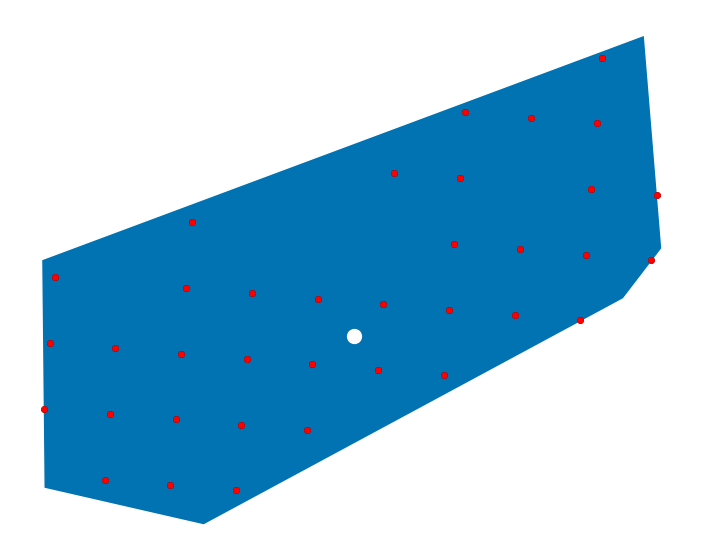

In [64]:
###############################################
#### buildout one new wind gen
####

## take one gen
gen_idx = 2

gen_cap = wind_gen_df.loc[gen_idx, "GenMWMax"]

vor_idx = wind_gen_df.loc[gen_idx, "vor_idx"]
connect_bus = vor_gdf.loc[vor_idx, "connect_bus"]
bus_lat = bus_gdf.loc[connect_bus, "Latitude"]
bus_lon = bus_gdf.loc[connect_bus, "Longitude"]

print(
    f"\n building out gen_idx={gen_idx} in polygon vor_idx={vor_idx} to {gen_cap} MW capacity"
)
print(f"\n connect_bus = {connect_bus}")

## sites within the polygon
# high_gdf.within(vor_gdf.loc[bus_num, "geometry"])
s = high_gdf.within(vor_gdf.loc[vor_idx:vor_idx, "geometry"].values[0])

gids_in_polygon = s[s].index
# print("\ngids of sites that are within the polygon:")
# gids_in_polygon

print(f"\nhigh_df sites within the polygon, vor_idx={vor_idx}, sites_in_polygon_df:")
sites_in_polygon_df = high_gdf.loc[gids_in_polygon].copy()
sites_in_polygon_df

print("\ntotal incl capacity in the polygon:")
sites_in_polygon_df["incl_capacity_mw"].sum()


#### compute site distances to connect bus
for gid in sites_in_polygon_df.index[:]:
    site_lat = sites_in_polygon_df.loc[gid, "latitude"]
    site_lon = sites_in_polygon_df.loc[gid, "longitude"]
    # print("\nsite lat/lon: {}, {}".format(site_lat, site_lon))
    d = distance(bus_lat, bus_lon, site_lat, site_lon)
    # print("\ndistance: {}".format(d))
    sites_in_polygon_df.loc[gid, "dist_to_connect_bus"] = d


dist_s = sites_in_polygon_df["dist_to_connect_bus"]
dist_s = dist_s.sort_values()
print("\n dist_s:")
dist_s

#### select neareast sites up to gen cap
selected_sites_gids = []
selected_cap = 0
for gid in dist_s.index:
    selected_sites_gids.append(gid)
    cap = sites_in_polygon_df.loc[gid, "incl_capacity_mw"]
    selected_cap += cap
    if selected_cap > gen_cap:
        break

selected_sites_gdf = sites_in_polygon_df.loc[selected_sites_gids].copy()
selected_sites_gdf["gen_idx"] = gen_idx
print(f"\n selected_sites_gdf")
selected_sites_gdf


############################################
################# quick plot
fig = plt.figure(figsize=(9, 7))
ax = fig.add_subplot(111)

## polygon
vor_gdf.loc[vor_idx:vor_idx].plot(ax=ax)

## first_bus
# points_gdf.loc[vor_idx:vor_idx].plot(ax=ax, color="white", markersize=100, zorder=3)
bus_gdf.loc[connect_bus:connect_bus].plot(
    ax=ax, color="white", markersize=100, zorder=3
)
# wind_gen_location_gdf.loc[wind_gen_location_gdf["FirstBus"]==first_bus].plot(ax=ax, color="red", markersize=100, zorder=3)

# ## sites whithin the polygon
high_gdf.loc[gids_in_polygon].plot(ax=ax, markersize=15, color="black")
# high_gdf.loc[gids_in_polygon].plot(
#     ax=ax,
#     column="cf_mean",
#     cmap="viridis",
#     legend=True,
#     markersize=15,
#     # color="black",
# )

### selected sites
selected_sites_gdf.plot(ax=ax, markersize=15, color="red")


ax.set_axis_off()
# change color bar
fig = ax.figure
# # 0'th is for the map, 1st is for colorbar
# cb_ax = fig.axes[1]
# cb_ax.tick_params(labelsize=15)

# cb_ax.set_ylim((350.0, 500))
# cb_ax.set_ybound((350.0, 500))

## buildout all gens
* should work for options all options of wind_gen_df creation above
* all gens in new_wind_gen_df
* capture magic tag suppresses the printing statement

In [65]:
# %%capture

all_selected_sites_gdf = gpd.GeoDataFrame()

for gen_idx in wind_gen_df.index[:]:
    gen_uid = wind_gen_df.loc[gen_idx, "GenUID"]
    gen_cap = wind_gen_df.loc[gen_idx, "GenMWMax"]
    vor_idx = wind_gen_df.loc[gen_idx, "vor_idx"]
    connect_bus = vor_gdf.loc[vor_idx, "connect_bus"]
    bus_lat = bus_gdf.loc[connect_bus, "Latitude"]
    bus_lon = bus_gdf.loc[connect_bus, "Longitude"]

    print(
        f"\n building out gen_idx={gen_idx} in polygon vor_idx={vor_idx} to {gen_cap} MW capacity"
    )
    print(f"\n connect_bus = {connect_bus}")

    ## sites within the polygon
    # high_gdf.within(vor_gdf.loc[bus_num, "geometry"])
    s = high_gdf.within(vor_gdf.loc[vor_idx:vor_idx, "geometry"].values[0])

    gids_in_polygon = s[s].index
    # print("\ngids of sites that are within the polygon:")
    # gids_in_polygon

    print(
        f"\nhigh_df sites within the polygon, vor_idx={vor_idx}, sites_in_polygon_df:"
    )
    sites_in_polygon_df = high_gdf.loc[gids_in_polygon].copy()
    sites_in_polygon_df

    print("\ntotal incl capacity in the polygon:")
    sites_in_polygon_df["incl_capacity_mw"].sum()

    #### compute site distances to connect bus
    for gid in sites_in_polygon_df.index[:]:
        site_lat = sites_in_polygon_df.loc[gid, "latitude"]
        site_lon = sites_in_polygon_df.loc[gid, "longitude"]
        # print("\nsite lat/lon: {}, {}".format(site_lat, site_lon))
        d = distance(bus_lat, bus_lon, site_lat, site_lon)
        # print("\ndistance: {}".format(d))
        sites_in_polygon_df.loc[gid, "dist_to_connect_bus"] = d

    dist_s = sites_in_polygon_df["dist_to_connect_bus"]
    dist_s = dist_s.sort_values()
    print("\n dist_s:")
    dist_s

    #### select neareast sites up to gen cap
    selected_sites_gids = []
    selected_cap = 0
    for gid in dist_s.index:
        selected_sites_gids.append(gid)
        cap = sites_in_polygon_df.loc[gid, "incl_capacity_mw"]
        selected_cap += cap
        if selected_cap >= gen_cap:
            break

    selected_sites_gdf = sites_in_polygon_df.loc[selected_sites_gids].copy()
    selected_sites_gdf["gen_idx"] = gen_idx
    selected_sites_gdf["gen_uid"] = gen_uid
    print(f"\n selected_sites_gdf")
    selected_sites_gdf

    #### concat to all_gdf
    all_selected_sites_gdf = pd.concat([all_selected_sites_gdf, selected_sites_gdf])

selected_gdf = all_selected_sites_gdf
print(f"\n selected_gdf:")
selected_gdf


 building out gen_idx=0 in polygon vor_idx=9 to 346.54812167039006 MW capacity

 connect_bus = 25

high_df sites within the polygon, vor_idx=9, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1705395,0.433044,40.349403,-87.819275,41728.117,POINT (-9775996.975 4916847.239),0.438735,18307.592834,4.826087
1705396,0.435655,40.367867,-87.816770,41979.680,POINT (-9775718.120 4919544.598),0.683884,28709.243967,7.522727
1705397,0.440160,40.386314,-87.814300,42413.820,POINT (-9775443.160 4922240.210),0.563241,23889.206917,6.195652
1705398,0.444043,40.404770,-87.811830,42787.940,POINT (-9775168.201 4924937.877),0.610672,26129.394190,6.717391
...,...,...,...,...,...,...,...,...
1704196,0.442089,40.425114,-87.833560,42599.688,POINT (-9777587.174 4927912.365),0.392562,16723.018017,4.318182
1704197,0.438483,40.443577,-87.831085,42252.258,POINT (-9777311.658 4930612.611),0.393281,16616.994747,4.326087
1704200,0.433113,40.498947,-87.823640,41734.773,POINT (-9776482.884 4938715.023),0.480151,20039.002537,5.281664
1704201,0.431641,40.517418,-87.821140,41592.934,POINT (-9776204.586 4941419.412),0.432806,18001.684874,4.760870



total incl capacity in the polygon:


346.54812167039006


 dist_s:


gid
1701790     1.325015
1701789     1.337643
1700586     1.594265
1700585     1.603521
             ...    
1707801    12.299539
1706597    13.006385
1707800    13.298960
1707799    14.524092
Name: dist_to_connect_bus, Length: 69, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1701790,0.439294,40.447346,-87.879610,42330.350,POINT (-9782713.436 4931163.926),0.504132,21340.093802,5.545455,1.325015,0,195_Wind_1
1701789,0.440809,40.428890,-87.882080,42476.340,POINT (-9782988.395 4928464.551),0.492095,20902.388656,5.413043,1.337643,0,195_Wind_1
1700586,0.441145,40.449220,-87.903870,42508.720,POINT (-9785414.047 4931438.058),0.270751,11509.277945,2.978261,1.594265,0,195_Wind_1
1700585,0.441905,40.430767,-87.906310,42581.945,POINT (-9785685.667 4928739.047),0.427686,18211.699618,4.704545,1.603521,0,195_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1707801,0.444803,40.382515,-87.765840,42861.200,POINT (-9770048.618 4921685.012),0.392562,16825.677686,4.318182,12.299539,0,195_Wind_1
1706597,0.434990,40.347507,-87.795044,41915.617,POINT (-9773299.592 4916570.300),0.425620,17840.117979,4.681818,13.006385,0,195_Wind_1
1707800,0.440832,40.364060,-87.768340,42478.570,POINT (-9770326.917 4918988.382),0.413989,17585.646181,4.553875,13.298960,0,195_Wind_1
1707799,0.435125,40.345610,-87.770840,41928.670,POINT (-9770605.215 4916293.221),0.438735,18395.582490,4.826087,14.524092,0,195_Wind_1



 building out gen_idx=1 in polygon vor_idx=88 to 403.60251288881244 MW capacity

 connect_bus = 165

high_df sites within the polygon, vor_idx=88, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1671514,0.437444,40.252445,-88.516050,42152.094,POINT (-9853561.613 4902694.999),0.373967,15763.489698,4.113636
1671515,0.441938,40.270912,-88.513760,42585.105,POINT (-9853306.691 4905388.925),0.430830,18346.942470,4.739130
1671516,0.442649,40.289383,-88.511505,42653.617,POINT (-9853055.666 4908084.170),0.308300,13150.126980,3.391304
1671517,0.439603,40.307842,-88.509220,42360.113,POINT (-9852801.301 4910778.401),0.525692,22268.359798,5.782609
...,...,...,...,...,...,...,...,...
1670303,0.442092,40.364983,-88.526640,42600.010,POINT (-9854740.486 4919123.233),0.543388,23148.352541,5.977273
1670304,0.442449,40.383453,-88.524380,42634.350,POINT (-9854488.904 4921822.091),0.606719,25867.085870,6.673913
1670305,0.442137,40.401924,-88.522095,42604.280,POINT (-9854234.539 4924521.836),0.576560,24563.904348,6.342155
1670306,0.447631,40.420403,-88.519840,43133.740,POINT (-9853983.514 4927223.491),0.245868,10605.196405,2.704545



total incl capacity in the polygon:


403.60251288881244


 dist_s:


gid
1670301     0.164879
1670302     1.899208
1671518     2.058843
1669084     2.081325
             ...    
1665435    11.564829
1666654    11.897532
1669090    12.391969
1667873    12.899118
Name: dist_to_connect_bus, Length: 81, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1670301,0.438271,40.328045,-88.53119,42231.830,POINT (-9855246.990 4913728.025),0.471715,19921.382453,5.188864,0.164879,1,196_Wind_1
1670302,0.440439,40.346516,-88.52890,42440.690,POINT (-9854992.068 4916425.552),0.216942,9207.174483,2.386364,1.899208,1,196_Wind_1
1671518,0.436536,40.326320,-88.50696,42064.566,POINT (-9852549.719 4913476.142),0.625455,26309.474007,6.880000,2.058843,1,196_Wind_1
1669084,0.435743,40.329780,-88.55542,41988.215,POINT (-9857944.261 4913981.375),0.511265,21467.097274,5.623913,2.081325,1,196_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1665435,0.452428,40.408806,-88.61914,43595.996,POINT (-9865037.539 4925527.907),0.316116,13781.378901,3.477273,11.564829,1,196_Wind_1
1666654,0.456286,40.425575,-88.59262,43967.676,POINT (-9862085.346 4927979.778),0.527668,23200.334964,5.804348,11.897532,1,196_Wind_1
1669090,0.452676,40.440605,-88.54181,43619.844,POINT (-9856429.203 4930177.901),0.287190,12527.186603,3.159091,12.391969,1,196_Wind_1
1667873,0.454933,40.442330,-88.56610,43837.363,POINT (-9859133.154 4930430.212),0.298419,13081.900816,3.282609,12.899118,1,196_Wind_1



 building out gen_idx=2 in polygon vor_idx=100 to 164.59033596837943 MW capacity

 connect_bus = 180

high_df sites within the polygon, vor_idx=100, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1618770,0.435060,40.395687,-89.549866,41922.406,POINT (-9968645.484 4923610.145),0.612476,25676.483070,6.737240
1618771,0.437360,40.414180,-89.547910,42144.040,POINT (-9968427.743 4926313.597),0.490119,20655.576917,5.391304
1618772,0.427460,40.432670,-89.545960,41190.070,POINT (-9968210.670 4929017.354),0.367589,15141.013874,4.043478
1620002,0.431435,40.375700,-89.527560,41573.086,POINT (-9966162.391 4920689.124),0.318202,13228.659039,3.500227
...,...,...,...,...,...,...,...,...
1628644,0.424922,40.476010,-89.345550,40945.496,POINT (-9945901.131 4935357.792),0.469008,19203.776017,5.159091
1628645,0.427367,40.494503,-89.343540,41181.086,POINT (-9945677.378 4938064.476),0.643905,26516.705479,7.082955
1629877,0.428353,40.437490,-89.325320,41276.074,POINT (-9943649.137 4929722.295),0.498988,20596.249239,5.488864
1629878,0.427316,40.455975,-89.323270,41176.203,POINT (-9943420.932 4932426.257),0.482530,19868.738586,5.307826



total incl capacity in the polygon:


164.59033596837943


 dist_s:


gid
1624938     1.309771
1624939     1.359255
1623704     1.575449
1623705     1.617305
             ...    
1618770     9.953829
1628644    10.108308
1629878    10.478528
1628645    11.677827
Name: dist_to_connect_bus, Length: 36, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1624938,0.438816,40.406643,-89.426480,42284.310,POINT (-9954910.217 4925211.690),0.391818,16567.761464,4.310000,1.309771,2,197_Wind_1
1624939,0.431524,40.425133,-89.424500,41581.625,POINT (-9954689.804 4927915.143),0.388430,16151.540289,4.272727,1.359255,2,197_Wind_1
1623704,0.437555,40.408157,-89.450775,42162.805,POINT (-9957614.724 4925433.026),0.393099,16574.163800,4.324091,1.575449,2,197_Wind_1
1623705,0.425385,40.426647,-89.448790,40990.140,POINT (-9957393.755 4928136.541),0.266529,10925.057975,2.931818,1.617305,2,197_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1618770,0.435060,40.395687,-89.549866,41922.406,POINT (-9968645.484 4923610.145),0.612476,25676.483070,6.737240,9.953829,2,197_Wind_1
1628644,0.424922,40.476010,-89.345550,40945.496,POINT (-9945901.131 4935357.792),0.469008,19203.776017,5.159091,10.108308,2,197_Wind_1
1629878,0.427316,40.455975,-89.323270,41176.203,POINT (-9943420.932 4932426.257),0.482530,19868.738586,5.307826,10.478528,2,197_Wind_1
1628645,0.427367,40.494503,-89.343540,41181.086,POINT (-9945677.378 4938064.476),0.643905,26516.705479,7.082955,11.677827,2,197_Wind_1



 building out gen_idx=3 in polygon vor_idx=101 to 137.2683691355903 MW capacity

 connect_bus = 182

high_df sites within the polygon, vor_idx=101, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1658094,0.428401,40.104920,-88.80194,41280.670,POINT (-9885386.742 4881200.702),0.482213,19906.093834,5.304348
1658095,0.429548,40.123383,-88.79974,41391.234,POINT (-9885141.839 4883888.193),0.686446,28412.852178,7.550907
1658096,0.427839,40.141846,-88.79758,41226.566,POINT (-9884901.389 4886576.414),0.351240,14480.405413,3.863636
1658097,0.428212,40.160316,-88.79538,41262.492,POINT (-9884656.486 4889266.385),0.216942,8951.573678,2.386364
...,...,...,...,...,...,...,...,...
1656873,0.429121,40.125042,-88.82391,41350.090,POINT (-9887832.431 4884129.715),0.485826,20088.967278,5.344091
1656874,0.427004,40.143520,-88.82172,41146.066,POINT (-9887588.642 4886820.186),0.231405,9521.403702,2.545455
1656875,0.428194,40.161983,-88.81955,41260.766,POINT (-9887347.078 4889509.203),0.270751,11171.393166,2.978261
1656876,0.432484,40.180454,-88.81738,41674.145,POINT (-9887105.515 4892200.118),0.334711,13948.784070,3.681818



total incl capacity in the polygon:


137.2683691355903


 dist_s:


gid
1656875     1.644532
1656876     1.696007
1654430     3.008823
1655651     3.142400
             ...    
1655648     9.270747
1656871     9.332548
1650758     9.533387
1650759    10.394408
Name: dist_to_connect_bus, Length: 30, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1656875,0.428194,40.161983,-88.81955,41260.766,POINT (-9887347.078 4889509.203),0.270751,11171.393166,2.978261,1.644532,3,198_Wind_1
1656876,0.432484,40.180454,-88.81738,41674.145,POINT (-9887105.515 4892200.118),0.334711,13948.784070,3.681818,1.696007,3,198_Wind_1
1654430,0.435441,40.183760,-88.86572,41959.113,POINT (-9892486.699 4892681.824),0.516529,21673.095558,5.681818,3.008823,3,198_Wind_1
1655651,0.429465,40.145176,-88.84589,41383.273,POINT (-9890279.234 4887061.341),0.292490,12104.198427,3.217391,3.142400,3,198_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1655648,0.430348,40.089760,-88.85239,41468.324,POINT (-9891002.811 4878994.544),0.221074,9167.584025,2.431818,9.270747,3,198_Wind_1
1656871,0.427786,40.088108,-88.82825,41221.496,POINT (-9888315.558 4878754.167),0.475207,19588.727438,5.227273,9.332548,3,198_Wind_1
1650758,0.438368,40.207165,-88.93616,42241.117,POINT (-9900328.044 4896092.759),0.580579,24524.284870,6.386364,9.533387,3,198_Wind_1
1650759,0.439505,40.225643,-88.93399,42350.684,POINT (-9900086.481 4898786.488),0.632231,26775.432446,6.954545,10.394408,3,198_Wind_1



 building out gen_idx=4 in polygon vor_idx=104 to 26.975138339920946 MW capacity

 connect_bus = 186

high_df sites within the polygon, vor_idx=104, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1645867,0.443132,40.435410,-89.007510,42700.227,POINT (-9908270.690 4929418.082),0.296443,12658.170059,3.260870
1647092,0.445306,40.415314,-88.985350,42909.715,POINT (-9905803.850 4926479.399),0.262397,11259.367366,2.886364
1640959,0.439255,40.478813,-89.100430,42326.637,POINT (-9918614.497 4935767.998),0.207510,8783.195425,2.282609
1642186,0.438390,40.458717,-89.078250,42243.215,POINT (-9916145.431 4932827.417),0.557312,23542.661324,6.130435
1642187,0.445172,40.477220,-89.076140,42896.746,POINT (-9915910.547 4935534.868),0.297521,12762.668231,3.272727
1643414,0.440470,40.457120,-89.053955,42443.645,POINT (-9913440.924 4932593.771),0.362095,15368.625765,3.983043
1643415,0.444704,40.475605,-89.051820,42851.690,POINT (-9913203.257 4935298.523),0.469008,20097.796756,5.159091



total incl capacity in the polygon:


26.975138339920946


 dist_s:


gid
1645867    4.761772
1643415    4.978863
1643414    5.602500
1647092    6.866415
1642187    7.034978
1642186    7.488594
1640959    9.092678
Name: dist_to_connect_bus, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1645867,0.443132,40.435410,-89.007510,42700.227,POINT (-9908270.690 4929418.082),0.296443,12658.170059,3.260870,4.761772,4,199_Wind_1
1643415,0.444704,40.475605,-89.051820,42851.690,POINT (-9913203.257 4935298.523),0.469008,20097.796756,5.159091,4.978863,4,199_Wind_1
1643414,0.440470,40.457120,-89.053955,42443.645,POINT (-9913440.924 4932593.771),0.362095,15368.625765,3.983043,5.602500,4,199_Wind_1
1647092,0.445306,40.415314,-88.985350,42909.715,POINT (-9905803.850 4926479.399),0.262397,11259.367366,2.886364,6.866415,4,199_Wind_1
1642187,0.445172,40.477220,-89.076140,42896.746,POINT (-9915910.547 4935534.868),0.297521,12762.668231,3.272727,7.034978,4,199_Wind_1
1642186,0.438390,40.458717,-89.078250,42243.215,POINT (-9916145.431 4932827.417),0.557312,23542.661324,6.130435,7.488594,4,199_Wind_1
1640959,0.439255,40.478813,-89.100430,42326.637,POINT (-9918614.497 4935767.998),0.207510,8783.195425,2.282609,9.092678,4,199_Wind_1



 building out gen_idx=5 in polygon vor_idx=2 to 189.7147628458498 MW capacity

 connect_bus = 5

high_df sites within the polygon, vor_idx=2, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1692132,0.438411,40.332960,-88.090515,42245.270,POINT (-9806191.274 4914445.746),0.310277,13107.722115,3.413043
1692133,0.444448,40.351418,-88.088135,42827.050,POINT (-9805926.333 4917141.570),0.361570,15484.987087,3.977273
1692134,0.444430,40.369877,-88.085724,42825.316,POINT (-9805657.942 4919838.278),0.469008,20085.427132,5.159091
1692135,0.439849,40.388336,-88.083310,42383.810,POINT (-9805389.217 4922535.725),0.496047,21024.380059,5.456522
...,...,...,...,...,...,...,...,...
1690925,0.443559,40.371716,-88.109955,42741.355,POINT (-9808355.324 4920106.981),0.456522,19512.357717,5.021739
1690926,0.440568,40.390167,-88.107544,42453.145,POINT (-9808086.933 4922803.332),0.310277,13172.220879,3.413043
1690927,0.435188,40.408638,-88.105160,41934.734,POINT (-9807821.547 4925503.346),0.252066,10570.325512,2.772727
1690928,0.433778,40.427100,-88.102750,41798.887,POINT (-9807553.267 4928202.785),0.208678,8722.495014,2.295455



total incl capacity in the polygon:


189.7147628458498


 dist_s:


gid
1690925     0.841472
1690926     1.331377
1692134     1.896181
1692135     2.159021
             ...    
1684875    10.726898
1684876    11.165599
1686089    11.388647
1686090    12.838343
Name: dist_to_connect_bus, Length: 43, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1690925,0.443559,40.371716,-88.109955,42741.355,POINT (-9808355.324 4920106.981),0.456522,19512.357717,5.021739,0.841472,5,200_Wind_1
1690926,0.440568,40.390167,-88.107544,42453.145,POINT (-9808086.933 4922803.332),0.310277,13172.220879,3.413043,1.331377,5,200_Wind_1
1692134,0.444430,40.369877,-88.085724,42825.316,POINT (-9805657.942 4919838.278),0.469008,20085.427132,5.159091,1.896181,5,200_Wind_1
1692135,0.439849,40.388336,-88.083310,42383.810,POINT (-9805389.217 4922535.725),0.496047,21024.380059,5.456522,2.159021,5,200_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1684875,0.442756,40.399230,-88.228760,42663.920,POINT (-9821580.637 4924128.031),0.561983,23976.417851,6.181818,10.726898,5,200_Wind_1
1684876,0.448849,40.417694,-88.226410,43251.074,POINT (-9821319.036 4926827.385),0.474308,20514.343399,5.217391,11.165599,5,200_Wind_1
1686089,0.440879,40.452824,-88.197420,42483.120,POINT (-9818091.884 4931965.280),0.330579,14044.006612,3.636364,11.388647,5,200_Wind_1
1686090,0.439326,40.471287,-88.195040,42333.465,POINT (-9817826.943 4934666.641),0.540945,22900.083827,5.950397,12.838343,5,200_Wind_1



 building out gen_idx=6 in polygon vor_idx=40 to 215.29755971816465 MW capacity

 connect_bus = 84

high_df sites within the polygon, vor_idx=40, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1617513,0.421143,39.953503,-89.620670,40581.360,POINT (-9976527.349 4859187.761),0.214876,8719.961653,2.363636
1617514,0.425215,39.971985,-89.618744,40973.695,POINT (-9976312.948 4861872.051),0.442149,18116.468450,4.863636
1617515,0.429153,39.990467,-89.616820,41353.207,POINT (-9976098.769 4864557.067),0.328063,13566.467119,3.608696
1617516,0.432504,40.008940,-89.614900,41676.100,POINT (-9975885.035 4867241.501),0.458678,19115.897107,5.045455
...,...,...,...,...,...,...,...,...
1616283,0.432859,40.010420,-89.639040,41710.280,POINT (-9978572.288 4867456.601),0.324380,13529.987521,3.568182
1616284,0.436712,40.028896,-89.637115,42081.610,POINT (-9978357.998 4870142.256),0.500000,21040.805000,5.500000
1616285,0.440269,40.047386,-89.635190,42424.348,POINT (-9978143.708 4872830.675),0.304348,12911.758087,3.347826
1616286,0.440193,40.065865,-89.633270,42416.984,POINT (-9977929.975 4875518.223),0.310277,13161.000964,3.413043



total incl capacity in the polygon:


215.29755971816465


 dist_s:


gid
1615050     0.454140
1615051     1.624877
1613818     2.003167
1616282     2.214761
             ...    
1618752    10.030794
1619984    10.143842
1608895    10.211272
1619985    11.437780
Name: dist_to_connect_bus, Length: 43, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1615050,0.431969,39.993404,-89.665070,41624.560,POINT (-9981469.934 4864983.813),0.493384,20536.881210,5.427221,0.454140,6,201_Wind_1
1615051,0.434352,40.011883,-89.663150,41854.160,POINT (-9981256.201 4867669.235),0.479339,20062.324628,5.272727,1.624877,6,201_Wind_1
1613818,0.432207,39.994870,-89.689210,41647.470,POINT (-9984157.187 4865196.830),0.373967,15574.777004,4.113636,2.003167,6,201_Wind_1
1616282,0.430075,39.991936,-89.640960,41442.008,POINT (-9978786.021 4864770.510),0.586777,24317.211306,6.454545,2.214761,6,201_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1618752,0.435051,40.062912,-89.584960,41921.504,POINT (-9972552.130 4875088.696),0.692149,29015.917025,7.613636,10.030794,6,201_Wind_1
1619984,0.435673,40.042942,-89.562744,41981.406,POINT (-9970079.056 4872184.458),0.607438,25501.101992,6.681818,10.143842,6,201_Wind_1
1608895,0.430756,40.000660,-89.785706,41507.637,POINT (-9994899.072 4866038.189),0.345850,14355.408053,3.804348,10.211272,6,201_Wind_1
1619985,0.435086,40.061424,-89.560820,41924.902,POINT (-9969864.877 4874872.267),0.729679,30591.705429,8.026465,11.437780,6,201_Wind_1



 building out gen_idx=7 in polygon vor_idx=29 to 150.9061660079051 MW capacity

 connect_bus = 61

high_df sites within the polygon, vor_idx=29, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1658110,0.448614,40.400475,-88.766940,43228.438,POINT (-9881490.560 4924310.022),0.452479,19559.975045,4.977273
1649541,0.438260,40.356606,-88.943240,42230.785,POINT (-9901116.186 4917899.419),0.314050,13262.560579,3.454545
1649542,0.436872,40.375095,-88.941100,42097.010,POINT (-9900877.963 4920600.719),0.527668,22213.244407,5.804348
1649543,0.437721,40.393570,-88.938934,42178.780,POINT (-9900636.845 4923300.713),0.270751,11419.946364,2.978261
...,...,...,...,...,...,...,...,...
1655666,0.460201,40.422283,-88.813260,44344.953,POINT (-9886646.879 4927498.392),0.250000,11086.238250,2.750000
1656887,0.443378,40.383660,-88.793396,42723.900,POINT (-9884435.629 4921852.343),0.359504,15359.418595,3.954545
1656888,0.452316,40.402140,-88.791200,43585.125,POINT (-9884191.171 4924553.411),0.369565,16107.546196,4.065217
1656889,0.460923,40.420624,-88.789000,44414.580,POINT (-9883946.268 4927255.806),0.683794,30370.444032,7.521739



total incl capacity in the polygon:


150.9061660079051


 dist_s:


gid
1654441     1.707756
1655664     2.709060
1653219     3.155275
1655666     3.206466
             ...    
1651989    10.767486
1650764    11.707013
1651988    12.698669
1650763    13.505343
Name: dist_to_connect_bus, Length: 33, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1654441,0.442938,40.386990,-88.841890,42681.490,POINT (-9889833.956 4922339.006),0.418202,17849.504940,4.600227,1.707756,7,202_Wind_1
1655664,0.444001,40.385334,-88.817630,42783.902,POINT (-9887133.345 4922096.987),0.561983,24043.845752,6.181818,2.709060,7,202_Wind_1
1653219,0.448971,40.425606,-88.861820,43262.860,POINT (-9892052.553 4927984.311),0.262397,11352.031446,2.886364,3.155275,7,202_Wind_1
1655666,0.460201,40.422283,-88.813260,44344.953,POINT (-9886646.879 4927498.392),0.250000,11086.238250,2.750000,3.206466,7,202_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1651989,0.448476,40.316376,-88.899050,43215.176,POINT (-9896196.978 4912024.251),0.541502,23401.103209,5.956522,10.767486,7,202_Wind_1
1650764,0.449489,40.318020,-88.923280,43312.723,POINT (-9898894.249 4912264.272),0.318182,13781.320955,3.500000,11.707013,7,202_Wind_1
1651988,0.447262,40.297910,-88.901184,43098.168,POINT (-9896434.534 4909328.659),0.578512,24932.824463,6.363636,12.698669,7,202_Wind_1
1650763,0.446855,40.299545,-88.925415,43058.926,POINT (-9899131.916 4909567.300),0.500000,21529.463000,5.500000,13.505343,7,202_Wind_1



 building out gen_idx=8 in polygon vor_idx=45 to 392.33886578449903 MW capacity

 connect_bus = 94

high_df sites within the polygon, vor_idx=45, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1634789,0.430157,40.098587,-89.265015,41449.910,POINT (-9936936.015 4880279.033),0.496047,20561.121364,5.456522
1636019,0.427196,40.078545,-89.242890,41164.637,POINT (-9934473.072 4877362.798),0.572314,23559.100101,6.295455
1636020,0.430407,40.097020,-89.240845,41473.984,POINT (-9934245.423 4880050.994),0.427686,17737.840264,4.704545
1636021,0.430162,40.115500,-89.238800,41450.380,POINT (-9934017.775 4882740.647),0.514463,21324.678967,5.659091
...,...,...,...,...,...,...,...,...
1643393,0.421119,40.069060,-89.098020,40579.010,POINT (-9918346.217 4875982.971),0.448347,18193.481756,4.931818
1643394,0.421300,40.087543,-89.095950,40596.434,POINT (-9918115.786 4878671.957),0.303719,12329.908674,3.340909
1643396,0.424278,40.124480,-89.091770,40883.434,POINT (-9917650.470 4884047.897),0.272727,11150.027455,3.000000
1643397,0.433923,40.142960,-89.089660,41812.820,POINT (-9917415.586 4886738.637),0.288202,12050.558392,3.170227



total incl capacity in the polygon:


392.33886578449903


 dist_s:


gid
1642166     0.527936
1642167     1.649561
1643394     1.823199
1640938     2.394730
             ...    
1644615    13.374973
1645842    14.104636
1648295    14.695511
1647068    15.083901
Name: dist_to_connect_bus, Length: 80, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1642166,0.421315,40.089138,-89.120090,40597.900,POINT (-9920803.038 4878904.038),0.484190,19657.085968,5.326087,0.527936,8,203_Wind_1
1642167,0.420081,40.107616,-89.118010,40478.996,POINT (-9920571.494 4881593.089),0.264008,10686.789481,2.904091,1.649561,8,203_Wind_1
1643394,0.421300,40.087543,-89.095950,40596.434,POINT (-9918115.786 4878671.957),0.303719,12329.908674,3.340909,1.823199,8,203_Wind_1
1640938,0.421830,40.090714,-89.144226,40647.510,POINT (-9923489.845 4879133.360),0.509881,20725.410237,5.608696,2.394730,8,203_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1644615,0.415515,39.975105,-89.084350,40038.996,POINT (-9916824.480 4862325.265),0.566116,22666.704347,6.227273,13.374973,8,203_Wind_1
1645842,0.420039,39.973507,-89.060240,40474.970,POINT (-9914140.567 4862093.135),0.541502,21917.276245,5.956522,14.104636,8,203_Wind_1
1648295,0.433711,39.988754,-89.009950,41792.426,POINT (-9908542.310 4864308.176),0.581028,24282.555818,6.391304,14.695511,8,203_Wind_1
1647068,0.427635,39.971897,-89.036130,41206.930,POINT (-9911456.654 4861859.268),0.518595,21369.709566,5.704545,15.083901,8,203_Wind_1



 building out gen_idx=9 in polygon vor_idx=58 to 64.0957114624506 MW capacity

 connect_bus = 110

high_df sites within the polygon, vor_idx=58, sites_in_polygon_df:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw
gid,,,,,,,,
1644646,0.464540,40.547930,-89.019040,44763.117,POINT (-9909554.204 4945888.388),0.537190,24046.302521,5.909091
1644647,0.466172,40.566420,-89.016910,44920.375,POINT (-9909317.093 4948597.538),0.497934,22367.376808,5.477273
1645874,0.461965,40.564800,-88.992584,44514.926,POINT (-9906609.135 4948360.146),0.257174,11448.077708,2.828913
1639731,0.445143,40.498900,-89.122650,42893.953,POINT (-9921088.016 4938708.143),0.423554,18167.893316,4.659091
...,...,...,...,...,...,...,...,...
1642191,0.457226,40.551150,-89.067690,44058.336,POINT (-9914969.897 4946360.128),0.296443,13060.771542,3.260870
1642192,0.464414,40.569645,-89.065580,44750.953,POINT (-9914735.013 4949070.141),0.444664,19899.139180,4.891304
1643419,0.458646,40.549540,-89.043365,44195.105,POINT (-9912262.050 4946124.255),0.420949,18603.868310,4.630435
1643420,0.464571,40.568030,-89.041260,44766.080,POINT (-9912027.723 4948833.471),0.373967,16741.034050,4.113636



total incl capacity in the polygon:


64.0957114624506


 dist_s:


gid
1644646    1.215747
1643419    2.487347
1644647    3.277145
1645874    3.813919
             ...   
1642188    6.538782
1640961    6.944438
1639732    8.858124
1639731    9.735158
Name: dist_to_connect_bus, Length: 15, dtype: float64


 selected_sites_gdf


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1644646,0.464540,40.547930,-89.019040,44763.117,POINT (-9909554.204 4945888.388),0.537190,24046.302521,5.909091,1.215747,9,204_Wind_1
1643419,0.458646,40.549540,-89.043365,44195.105,POINT (-9912262.050 4946124.255),0.420949,18603.868310,4.630435,2.487347,9,204_Wind_1
1644647,0.466172,40.566420,-89.016910,44920.375,POINT (-9909317.093 4948597.538),0.497934,22367.376808,5.477273,3.277145,9,204_Wind_1
1645874,0.461965,40.564800,-88.992584,44514.926,POINT (-9906609.135 4948360.146),0.257174,11448.077708,2.828913,3.813919,9,204_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1642188,0.448906,40.495705,-89.074036,43256.550,POINT (-9915676.330 4938240.430),0.278926,12065.360021,3.068182,6.538782,9,204_Wind_1
1640961,0.448952,40.515785,-89.096250,43261.000,POINT (-9918149.182 4941180.290),0.535573,23169.428854,5.891304,6.944438,9,204_Wind_1
1639732,0.454288,40.517380,-89.120544,43775.223,POINT (-9920853.577 4941413.847),0.266798,11679.160287,2.934783,8.858124,9,204_Wind_1
1639731,0.445143,40.498900,-89.122650,42893.953,POINT (-9921088.016 4938708.143),0.423554,18167.893316,4.659091,9.735158,9,204_Wind_1



 selected_gdf:


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1701790,0.439294,40.447346,-87.879610,42330.350,POINT (-9782713.436 4931163.926),0.504132,21340.093802,5.545455,1.325015,0,195_Wind_1
1701789,0.440809,40.428890,-87.882080,42476.340,POINT (-9782988.395 4928464.551),0.492095,20902.388656,5.413043,1.337643,0,195_Wind_1
1700586,0.441145,40.449220,-87.903870,42508.720,POINT (-9785414.047 4931438.058),0.270751,11509.277945,2.978261,1.594265,0,195_Wind_1
1700585,0.441905,40.430767,-87.906310,42581.945,POINT (-9785685.667 4928739.047),0.427686,18211.699618,4.704545,1.603521,0,195_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1642188,0.448906,40.495705,-89.074036,43256.550,POINT (-9915676.330 4938240.430),0.278926,12065.360021,3.068182,6.538782,9,204_Wind_1
1640961,0.448952,40.515785,-89.096250,43261.000,POINT (-9918149.182 4941180.290),0.535573,23169.428854,5.891304,6.944438,9,204_Wind_1
1639732,0.454288,40.517380,-89.120544,43775.223,POINT (-9920853.577 4941413.847),0.266798,11679.160287,2.934783,8.858124,9,204_Wind_1
1639731,0.445143,40.498900,-89.122650,42893.953,POINT (-9921088.016 4938708.143),0.423554,18167.893316,4.659091,9.735158,9,204_Wind_1


In [66]:
##############################################################################
#### selected capacities/generation
#### target and resulting penetration
#### because sites are discrete, we can go overboard for each gen by upto 11MW
#### so resulting penetration goes over target penetration
#### overshoot will be smaller the smaler the number of wind gens

# print(f"\n selected_gdf:")
# selected_gdf
#### save selected_gdf
filename = "selected_gdf.csv"
selected_gdf.to_csv(os.path.join(work_dir, filename))

df = selected_gdf[["gen_uid", "incl_capacity_mw"]].groupby("gen_uid").sum()
df.rename(columns={"incl_capacity_mw": "selected_capacity_mw"}, inplace=True)
df2 = wind_gen_df[["GenMWMax", "GenUID"]].set_index("GenUID")
df["desired_capacity_mw"] = df2["GenMWMax"]
df
df.sum()

total_load_mwh = loadP_df.sum().sum() / 12
print(f"\n total {grid_name} loadP (year 2017): {round(total_load_mwh):,} MWh")

### for option 1 only
# print(f"\n target penetration level: {round(penetration_level,4)}")
# target_generation = total_load_mwh * penetration_level
# print(f"\n target generation: {round(target_generation):,} MWh")


selected_generation = selected_gdf["incl_generation_mwh"].sum()
print(f"\n selected generation: {round(selected_generation):,} MWh")
resulting_penetration_level = selected_generation / total_load_mwh
print(f"\n resulting penetration level: {round(resulting_penetration_level,4)}")

,selected_capacity_mw,desired_capacity_mw
gen_uid,,
195_Wind_1,346.548122,346.548122
196_Wind_1,403.602513,403.602513
197_Wind_1,164.590336,164.590336
198_Wind_1,137.268369,137.268369
...,...,...
201_Wind_1,215.297560,215.297560
202_Wind_1,150.906166,150.906166
203_Wind_1,392.338866,392.338866
204_Wind_1,64.095711,64.095711


selected_capacity_mw    2091.337544
desired_capacity_mw     2091.337544
dtype: float64


 total ACTIVSg200 loadP (year 2017): 8,949,170 MWh

 selected generation: 7,978,306 MWh

 resulting penetration level: 0.8915


## save_dir

In [67]:
level_int = int(round(resulting_penetration_level, 2) * 100)

if buildout_option == 2:
    save_dir = f"option{buildout_option}_seed{random_seed}-ngens{len(wind_gen_df)}-pen{level_int}"
else:
    save_dir = f"ngens{len(wind_gen_df)}-pen{level_int}"

save_dir = os.path.join(work_dir, save_dir)

if not os.path.exists(save_dir):
    os.makedirs(save_dir)
print(f"\n saving to:\n {save_dir}/")


 saving to:
 /home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/buildouts/work_dir/option2_seed2-ngens10-pen89/


## save buildout params
* for reproducability

In [68]:
params_dict = {
    "min_build_cap": min_build_cap,
    "max_build_cap": max_build_cap,
    "buildout_option": buildout_option,
    "random_seed": random_seed,
    "n_gens_max": n_gens_max,
    "n_gens_min": n_gens_min,
    "target_wind_cap": target_wind_cap,
    "delta_wind_cap": delta_wind_cap,
}

print("\n parameters dict:")
params_dict

import yaml

filename = os.path.join(save_dir, "parameters.yaml")
print("\n dumping parameters to:")
filename
with open(filename, "w+") as file:
    yaml.dump(params_dict, file, allow_unicode=True)


 parameters dict:


{'min_build_cap': 20,
 'max_build_cap': 600,
 'buildout_option': 2,
 'random_seed': 2,
 'n_gens_max': 20,
 'n_gens_min': 10,
 'target_wind_cap': 2000,
 'delta_wind_cap': 100}


 dumping parameters to:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/buildouts/work_dir/option2_seed2-ngens10-pen89/parameters.yaml'

In [69]:
import datetime

### also can write readme describing the configuration
now = datetime.datetime.now().strftime("%Y-%m-%d %H:%M:%S")

### string for buildout_option = 2
msg = f"""
experiment date: {now}
{grid_name} grid

first, fiter possible buildout polygons by:
min_build_cap={min_build_cap} MW and max_build_cap={max_build_cap} MW

buildout_option=2:
random number of generators between n_gens_min={n_gens_min} and n_gens_max={n_gens_max}
achieving total wind capacity of target_wind_cap={target_wind_cap} MW +/- delta_wind_cap={delta_wind_cap} MW
NOTE: all available sites in randomly chosen polygons are selected, i.e.,
when randomly selecting gens, taking into account generation of all sites in 
the corresponding polygon (see figures)
use random_seed={random_seed}

all parameters are recorded in parameters.yml

connection procedure:
when multiple buses are available in one voronoi polygon new wind generators are connected
to a bus with most transmission lines comming/leaving to/from it

"""
print("\n readme.txt message:")
print(msg)

# quick readme to know what experiment we're running

filename = os.path.join(save_dir, "readme.txt")
with open(filename, "w") as f:
    f.write(msg)


 readme.txt message:

experiment date: 2023-11-03 14:54:46
ACTIVSg200 grid

first, fiter possible buildout polygons by:
min_build_cap=20 MW and max_build_cap=600 MW

buildout_option=2:
random number of generators between n_gens_min=10 and n_gens_max=20
achieving total wind capacity of target_wind_cap=2000 MW +/- delta_wind_cap=100 MW
NOTE: all available sites in randomly chosen polygons are selected, i.e.,
when randomly selecting gens, taking into account generation of all sites in 
the corresponding polygon (see figures)
use random_seed=2

all parameters are recorded in parameters.yml

connection procedure:
when multiple buses are available in one voronoi polygon new wind generators are connected
to a bus with most transmission lines comming/leaving to/from it




752

# modify grid files
* add new buses to bus_df
* add new wind generators to gen_df
* add new branches (trafos) branch_df
* helpfull notebook for gens and their original connections:
* /user/isatkaus/notebooks/projects/ecp/powerscenarios/notebooks/eagle_dev/tamu200_generator_connections.ipynb

In [70]:
df = wind_gen_df[["BusNum", "BusName", "Latitude", "Longitude", "Zone"]]
final_bus_df = pd.concat([bus_df, df]).reset_index(drop=True)
###
print("\n final_bus_df:")
final_bus_df


 final_bus_df:


,BusNum,BusName,Latitude,Longitude,Zone
0,1,CREVECOEUR0,40.642116,-89.599560,2
1,2,CREVECOEUR1,40.642116,-89.599560,2
2,3,ILLIOPOLIS0,39.866030,-89.251291,4
3,4,ILLIOPOLIS1,39.866030,-89.251291,4
...,...,...,...,...,...
200,201,NEWWIND201,39.997432,-89.665941,4
201,202,NEWWIND202,40.402310,-88.840561,7
202,203,NEWWIND203,40.092849,-89.116222,7
203,204,NEWWIND204,40.537000,-89.019000,7


In [71]:
df = wind_gen_df.drop(["vor_idx", "incl_generation_mwh"], axis=1)
final_gen_df = pd.concat([gen_df, df]).reset_index(drop=True)
print("\n final_gen_df:")
final_gen_df


 final_gen_df:


,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone
0,49,1,4.530000,1.36,1.0,Coal,49_Coal_1,RANTOUL21,40.312222,-88.159444,6
1,50,1,4.530000,1.36,1.0,Coal,50_Coal_1,RANTOUL22,40.312222,-88.159444,6
2,51,1,4.530000,1.36,1.0,Coal,51_Coal_1,RANTOUL23,40.312222,-88.159444,6
3,52,1,4.530000,1.36,1.0,Coal,52_Coal_1,RANTOUL24,40.312222,-88.159444,6
...,...,...,...,...,...,...,...,...,...,...,...
49,201,1,215.297560,0.00,1.0,Wind,201_Wind_1,NEWWIND201,39.997432,-89.665941,4
50,202,1,150.906166,0.00,1.0,Wind,202_Wind_1,NEWWIND202,40.402310,-88.840561,7
51,203,1,392.338866,0.00,1.0,Wind,203_Wind_1,NEWWIND203,40.092849,-89.116222,7
52,204,1,64.095711,0.00,1.0,Wind,204_Wind_1,NEWWIND204,40.537000,-89.019000,7


In [72]:
#####################################################
#### modify branch_df connect new generators
#### see below for gen connecting branch rateA analysis
#### all gen buses are "FromBuses" (not that it matters)

uid = len(branch_df)
df = branch_df.copy()
rateA_min = 20
### rateA = rateA_factor * GenMWMax (we'll draw U random from possible range, see below)
rateA_factor = 1.3
for gen_idx in wind_gen_df.index[:]:
    uid += 1
    ### corresponding vor polygon
    vor_idx = wind_gen_df.loc[gen_idx, "vor_idx"]
    ### new_bus will be FromBus (where wind gen is located)
    new_bus = wind_gen_df.loc[gen_idx, "BusNum"]
    ### connect_bus will be ToBus
    connect_bus = vor_gdf.loc[vor_idx, "connect_bus"]
    df.loc[uid, "FromBus"] = new_bus
    df.loc[uid, "ToBus"] = connect_bus
    ########################################################
    ##### for these params see generator_connection notebook
    ### wind gen ratio=rateA/GenMWMax interval: [1.2995,1.3333]
    rateA_factor = np.random.uniform(low=1.2995, high=1.3333, size=1)[0]
    df.loc[uid, "rateA"] = max(
        rateA_min, rateA_factor * wind_gen_df.loc[gen_idx, "GenMWMax"]
    )

    ### wind gen ratio r/GenMWMax interval: [4.9e-06,2.488e-05]
    r_factor = np.random.uniform(low=4.9e-06, high=2.488e-05, size=1)[0]
    df.loc[uid, "r"] = r_factor * wind_gen_df.loc[gen_idx, "GenMWMax"]

    ### wind gen ratio x/GenMWMax interval: [0.0003001,0.00101303]
    x_factor = np.random.uniform(low=0.0003001, high=0.00101303, size=1)[0]
    df.loc[uid, "r"] = x_factor * wind_gen_df.loc[gen_idx, "GenMWMax"]

    ### all parameters "b" are equal to 0 for all gen branches (not only wind gens)

    ### ratio=1 for all original wind generator lines (generator_connection ipynb)
    df.loc[uid, "ratio"] = 1
    df.loc[uid, "status"] = 1

    ### below are not really needed
    lat = wind_gen_df.loc[gen_idx, "Latitude"]
    lon = wind_gen_df.loc[gen_idx, "Longitude"]
    df.loc[uid, "distance"] = 0.0
    df.loc[uid, ["from_latitude", "to_latitude"]] = lat
    df.loc[uid, ["from_longitude", "to_longitude"]] = lon
    df.loc[uid, "trafo"] = True
    ### fill the rest (nan's) with 0
    df.loc[uid] = df.loc[uid].fillna(0)


df["FromBus"] = df["FromBus"].astype("int")
df["ToBus"] = df["ToBus"].astype("int")
df["status"] = df["status"].astype("int")
df["ratio"] = df["ratio"].astype("int")


final_branch_df = df
print("\n final_branch_df:")
final_branch_df


 final_branch_df:


,FromBus,ToBus,r,x,b,rateA,rateB,rateC,ratio,angle,status,angmin,angmax,Pf,Qf,Pt,Qt,mu_Sf,mu_St,mu_angmin,mu_angmax,distance,from_latitude,from_longitude,to_latitude,to_longitude,trafo
UID,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,2,1,0.000673,0.003339,0.00000,100.000000,0.0,0.0,0,0.0,1,0.0,0.0,-7.39,-2.10,7.39,2.11,0.0,0.0,0.0,0.0,0.000000,40.642116,-89.599560,40.642116,-89.599560,True
1,1,114,0.018542,0.119758,0.02285,221.100000,0.0,0.0,0,0.0,1,0.0,0.0,12.25,-0.57,-12.22,-1.63,0.0,0.0,0.0,0.0,32.807597,40.642116,-89.599560,40.870710,-89.353494,False
2,119,1,0.005615,0.036268,0.00692,221.100000,0.0,0.0,0,0.0,1,0.0,0.0,40.13,7.94,-40.04,-8.08,0.0,0.0,0.0,0.0,7.437729,40.595800,-89.663100,40.642116,-89.599560,False
3,187,1,0.004258,0.027501,0.00525,221.100000,0.0,0.0,0,0.0,1,0.0,0.0,-20.39,-6.96,20.41,6.54,0.0,0.0,0.0,0.0,4.773789,40.676541,-89.633346,40.642116,-89.599560,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
246,201,84,0.073687,0.000000,0.00000,283.037317,0.0,0.0,1,0.0,1,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.000000,39.997432,-89.665941,39.997432,-89.665941,True
247,202,61,0.152291,0.000000,0.00000,199.529328,0.0,0.0,1,0.0,1,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.000000,40.402310,-88.840561,40.402310,-88.840561,True
248,203,94,0.390044,0.000000,0.00000,513.260519,0.0,0.0,1,0.0,1,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.000000,40.092849,-89.116222,40.092849,-89.116222,True
249,204,110,0.020499,0.000000,0.00000,84.816922,0.0,0.0,1,0.0,1,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.000000,40.537000,-89.019000,40.537000,-89.019000,True


## save final bus, gen, branch dfs to save_dir

In [73]:
filename = "bus_df.csv"
print(f"\n {filename}")
final_bus_df.to_csv(os.path.join(save_dir, filename))
final_bus_df

filename = "gen_df.csv"
print(f"\n {filename}")
final_gen_df.to_csv(os.path.join(save_dir, filename))
final_gen_df

filename = "branch_df.csv"
print(f"\n {filename}")
final_branch_df.to_csv(os.path.join(save_dir, filename))
final_branch_df


 bus_df.csv


,BusNum,BusName,Latitude,Longitude,Zone
0,1,CREVECOEUR0,40.642116,-89.599560,2
1,2,CREVECOEUR1,40.642116,-89.599560,2
2,3,ILLIOPOLIS0,39.866030,-89.251291,4
3,4,ILLIOPOLIS1,39.866030,-89.251291,4
...,...,...,...,...,...
200,201,NEWWIND201,39.997432,-89.665941,4
201,202,NEWWIND202,40.402310,-88.840561,7
202,203,NEWWIND203,40.092849,-89.116222,7
203,204,NEWWIND204,40.537000,-89.019000,7



 gen_df.csv


,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone
0,49,1,4.530000,1.36,1.0,Coal,49_Coal_1,RANTOUL21,40.312222,-88.159444,6
1,50,1,4.530000,1.36,1.0,Coal,50_Coal_1,RANTOUL22,40.312222,-88.159444,6
2,51,1,4.530000,1.36,1.0,Coal,51_Coal_1,RANTOUL23,40.312222,-88.159444,6
3,52,1,4.530000,1.36,1.0,Coal,52_Coal_1,RANTOUL24,40.312222,-88.159444,6
...,...,...,...,...,...,...,...,...,...,...,...
49,201,1,215.297560,0.00,1.0,Wind,201_Wind_1,NEWWIND201,39.997432,-89.665941,4
50,202,1,150.906166,0.00,1.0,Wind,202_Wind_1,NEWWIND202,40.402310,-88.840561,7
51,203,1,392.338866,0.00,1.0,Wind,203_Wind_1,NEWWIND203,40.092849,-89.116222,7
52,204,1,64.095711,0.00,1.0,Wind,204_Wind_1,NEWWIND204,40.537000,-89.019000,7



 branch_df.csv


,FromBus,ToBus,r,x,b,rateA,rateB,rateC,ratio,angle,status,angmin,angmax,Pf,Qf,Pt,Qt,mu_Sf,mu_St,mu_angmin,mu_angmax,distance,from_latitude,from_longitude,to_latitude,to_longitude,trafo
UID,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,2,1,0.000673,0.003339,0.00000,100.000000,0.0,0.0,0,0.0,1,0.0,0.0,-7.39,-2.10,7.39,2.11,0.0,0.0,0.0,0.0,0.000000,40.642116,-89.599560,40.642116,-89.599560,True
1,1,114,0.018542,0.119758,0.02285,221.100000,0.0,0.0,0,0.0,1,0.0,0.0,12.25,-0.57,-12.22,-1.63,0.0,0.0,0.0,0.0,32.807597,40.642116,-89.599560,40.870710,-89.353494,False
2,119,1,0.005615,0.036268,0.00692,221.100000,0.0,0.0,0,0.0,1,0.0,0.0,40.13,7.94,-40.04,-8.08,0.0,0.0,0.0,0.0,7.437729,40.595800,-89.663100,40.642116,-89.599560,False
3,187,1,0.004258,0.027501,0.00525,221.100000,0.0,0.0,0,0.0,1,0.0,0.0,-20.39,-6.96,20.41,6.54,0.0,0.0,0.0,0.0,4.773789,40.676541,-89.633346,40.642116,-89.599560,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
246,201,84,0.073687,0.000000,0.00000,283.037317,0.0,0.0,1,0.0,1,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.000000,39.997432,-89.665941,39.997432,-89.665941,True
247,202,61,0.152291,0.000000,0.00000,199.529328,0.0,0.0,1,0.0,1,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.000000,40.402310,-88.840561,40.402310,-88.840561,True
248,203,94,0.390044,0.000000,0.00000,513.260519,0.0,0.0,1,0.0,1,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.000000,40.092849,-89.116222,40.092849,-89.116222,True
249,204,110,0.020499,0.000000,0.00000,84.816922,0.0,0.0,1,0.0,1,0.0,0.0,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.000000,40.537000,-89.019000,40.537000,-89.019000,True


## also save:
* wind_gen_df
* points_gdf
* vor_gdf
* selected_gdf

In [74]:
filename = "wind_gen_df.csv"
print(f"\n {filename}")
wind_gen_df.to_csv(os.path.join(save_dir, filename))
wind_gen_df

filename = "points_gdf.csv"
print(f"\n {filename}")
points_gdf.to_csv(os.path.join(save_dir, filename))
points_gdf

filename = "vor_gdf.csv"
print(f"\n {filename}")
vor_gdf.to_csv(os.path.join(save_dir, filename))
vor_gdf

filename = "selected_gdf.csv"
print(f"\n {filename}")
selected_gdf.to_csv(os.path.join(save_dir, filename))
selected_gdf

#### and other stuff (for plotting)
filename = "cf_df.csv"
high_df.to_csv(os.path.join(save_dir, filename))
filename = "high_cf_df.csv"
high_df.to_csv(os.path.join(save_dir, filename))
filename = "low_cf_df.csv"
low_df.to_csv(os.path.join(save_dir, filename))
filename = "high_cf_incl_df.csv"
high_gdf.to_csv(os.path.join(save_dir, filename))


 wind_gen_df.csv


,vor_idx,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone,incl_generation_mwh
0,9,195,1,346.548122,0.0,1.0,Wind,195_Wind_1,NEWWIND195,40.438957,-87.890723,6,1.330968e+06
1,88,196,1,403.602513,0.0,1.0,Wind,196_Wind_1,NEWWIND196,40.329508,-88.530877,6,1.543654e+06
2,100,197,1,164.590336,0.0,1.0,Wind,197_Wind_1,NEWWIND197,40.416219,-89.435480,2,6.234729e+05
3,101,198,1,137.268369,0.0,1.0,Wind,198_Wind_1,NEWWIND198,40.171900,-88.833900,7,5.207443e+05
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6,40,201,1,215.297560,0.0,1.0,Wind,201_Wind_1,NEWWIND201,39.997432,-89.665941,4,8.159487e+05
7,29,202,1,150.906166,0.0,1.0,Wind,202_Wind_1,NEWWIND202,40.402310,-88.840561,7,5.889871e+05
8,45,203,1,392.338866,0.0,1.0,Wind,203_Wind_1,NEWWIND203,40.092849,-89.116222,7,1.460188e+06
9,58,204,1,64.095711,0.0,1.0,Wind,204_Wind_1,NEWWIND204,40.537000,-89.019000,7,2.562263e+05



 points_gdf.csv


,first_bus,Latitude,Longitude,geometry,size
pt_idx,,,,,
0,1,40.642116,-89.599560,POINT (-9974177.395 4959696.311),20
1,3,39.866030,-89.251291,POINT (-9935408.267 4846493.180),20
2,5,40.378337,-88.105151,POINT (-9807820.546 4921074.461),20
3,7,40.712882,-89.576722,POINT (-9971635.080 4970083.622),20
...,...,...,...,...,...
107,189,40.470500,-88.398700,POINT (-9840498.271 4934551.478),30
108,192,40.556403,-89.762073,POINT (-9992268.259 4947129.757),10
109,193,40.306027,-87.958606,POINT (-9791507.231 4910513.455),10
110,194,40.169931,-89.986537,POINT (-10017255.477 4890667.004),10



 vor_gdf.csv


,geometry,first_bus,Latitude,Longitude,bus_num_list,incl_capacity_mw,incl_generation_mwh,connect_bus
vor_idx,,,,,,,,
0,"POLYGON ((-9968402.192 4963402.038, -9961604.3...",1,40.642116,-89.599560,"[1, 2]",25.363458,9.995427e+04,1
1,"POLYGON ((-9928617.310 4856698.678, -9941824.7...",3,39.866030,-89.251291,"[3, 4]",273.345169,1.010642e+06,3
2,"POLYGON ((-9816850.173 4937506.501, -9795753.0...",5,40.378337,-88.105151,"[5, 6]",189.714763,7.336446e+05,5
3,"POLYGON ((-9969296.246 4964677.761, -9969383.7...",7,40.712882,-89.576722,"[7, 8]",0.000000,0.000000e+00,7
...,...,...,...,...,...,...,...,...
107,"POLYGON ((-9836619.139 4951507.862, -9856670.9...",189,40.470500,-88.398700,"[189, 190, 191]",180.146889,7.066337e+05,189
108,"POLYGON ((-9987946.507 4952281.846, -9993611.0...",192,40.556403,-89.762073,[192],114.995059,4.170064e+05,192
109,"POLYGON ((-9795753.077 4921834.887, -9793568.9...",193,40.306027,-87.958606,[193],454.489589,1.731706e+06,193
110,"POLYGON ((-9997300.799 4898942.853, -10006110....",194,40.169931,-89.986537,[194],500.058172,1.803667e+06,194



 selected_gdf.csv


,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1701790,0.439294,40.447346,-87.879610,42330.350,POINT (-9782713.436 4931163.926),0.504132,21340.093802,5.545455,1.325015,0,195_Wind_1
1701789,0.440809,40.428890,-87.882080,42476.340,POINT (-9782988.395 4928464.551),0.492095,20902.388656,5.413043,1.337643,0,195_Wind_1
1700586,0.441145,40.449220,-87.903870,42508.720,POINT (-9785414.047 4931438.058),0.270751,11509.277945,2.978261,1.594265,0,195_Wind_1
1700585,0.441905,40.430767,-87.906310,42581.945,POINT (-9785685.667 4928739.047),0.427686,18211.699618,4.704545,1.603521,0,195_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1642188,0.448906,40.495705,-89.074036,43256.550,POINT (-9915676.330 4938240.430),0.278926,12065.360021,3.068182,6.538782,9,204_Wind_1
1640961,0.448952,40.515785,-89.096250,43261.000,POINT (-9918149.182 4941180.290),0.535573,23169.428854,5.891304,6.944438,9,204_Wind_1
1639732,0.454288,40.517380,-89.120544,43775.223,POINT (-9920853.577 4941413.847),0.266798,11679.160287,2.934783,8.858124,9,204_Wind_1
1639731,0.445143,40.498900,-89.122650,42893.953,POINT (-9921088.016 4938708.143),0.423554,18167.893316,4.659091,9.735158,9,204_Wind_1


## also save:
* for later comparisons
* old_bus_df
* old_gen_df
* old_wind_gen_df
* old_branch_df

In [75]:
# %%time
# #### first, need to add lat/lon info to old_old_branch_df
# # calculate line distances
# # add to/from lat/lon to the branch df
# # def distance(lat1, lon1, lat2, lon2):

# df = old_bus_df.set_index("BusNum")
# for line_uid in old_branch_df.index:
#     from_latitude = df.loc[old_branch_df.loc[line_uid, "FromBus"], "Latitude"]
#     from_longitude = df.loc[old_branch_df.loc[line_uid, "FromBus"], "Longitude"]
#     to_latitude = df.loc[old_branch_df.loc[line_uid, "ToBus"], "Latitude"]
#     to_longitude = df.loc[old_branch_df.loc[line_uid, "ToBus"], "Longitude"]

#     old_branch_df.loc[line_uid, "distance"] = distance(
#         from_latitude, from_longitude, to_latitude, to_longitude
#     )

#     old_branch_df.loc[line_uid, "from_latitude"] = from_latitude
#     old_branch_df.loc[line_uid, "from_longitude"] = from_longitude
#     old_branch_df.loc[line_uid, "to_latitude"] = to_latitude
#     old_branch_df.loc[line_uid, "to_longitude"] = to_longitude

# ### add columns denoting transformer or not (i.e. distance=0)
# old_branch_df["trafo"] = old_branch_df["distance"] == 0


# save_dir = "original-grid-buildout"
# save_dir = os.path.join(work_dir, save_dir)

# if not os.path.exists(save_dir):
#     os.makedirs(save_dir)
# print(f"\n saving to:\n {save_dir}/")

# filename = "bus_df.csv"
# print(f"\n {filename}")
# old_bus_df.to_csv(os.path.join(save_dir, filename))
# old_bus_df

# filename = "gen_df.csv"
# print(f"\n {filename}")
# old_gen_df.to_csv(os.path.join(save_dir, filename))
# old_gen_df

# filename = "wind_gen_df.csv"
# print(f"\n {filename}")
# old_wind_gen_df.to_csv(os.path.join(save_dir, filename))
# old_wind_gen_df

# filename = "branch_df.csv"
# print(f"\n {filename}")
# old_branch_df.to_csv(os.path.join(save_dir, filename))
# old_branch_df

# Plot buildout

In [76]:
###############################
##### make gdf from created wind_gen_df

g_df = (
    wind_gen_df[["BusNum", "Latitude", "Longitude", "GenMWMax"]]
    .set_index("BusNum")
    .copy()
)
# “EPSG:4326” WGS84 Latitude/Longitude, used in GPS
wind_gen_gdf = gpd.GeoDataFrame(
    g_df,
    geometry=gpd.points_from_xy(g_df["Longitude"], g_df["Latitude"]),
    crs="epsg:4326",
)

wind_gen_gdf = wind_gen_gdf.to_crs(epsg=3857)
wind_gen_gdf

,Latitude,Longitude,GenMWMax,geometry
BusNum,,,,
195,40.438957,-87.890723,346.548122,POINT (-9783950.530 4929936.859)
196,40.329508,-88.530877,403.602513,POINT (-9855212.147 4913941.657)
197,40.416219,-89.435480,164.590336,POINT (-9955912.092 4926611.720)
198,40.171900,-88.833900,137.268369,POINT (-9888944.513 4890953.853)
...,...,...,...,...
201,39.997432,-89.665941,215.297560,POINT (-9981566.894 4865569.112)
202,40.402310,-88.840561,150.906166,POINT (-9889686.012 4924578.262)
203,40.092849,-89.116222,392.338866,POINT (-9920372.454 4879444.031)
204,40.537000,-89.019000,64.095711,POINT (-9909549.751 4944287.279)


<Figure size 640x480 with 0 Axes>

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<AxesSubplot: >

<Figure size 640x480 with 0 Axes>

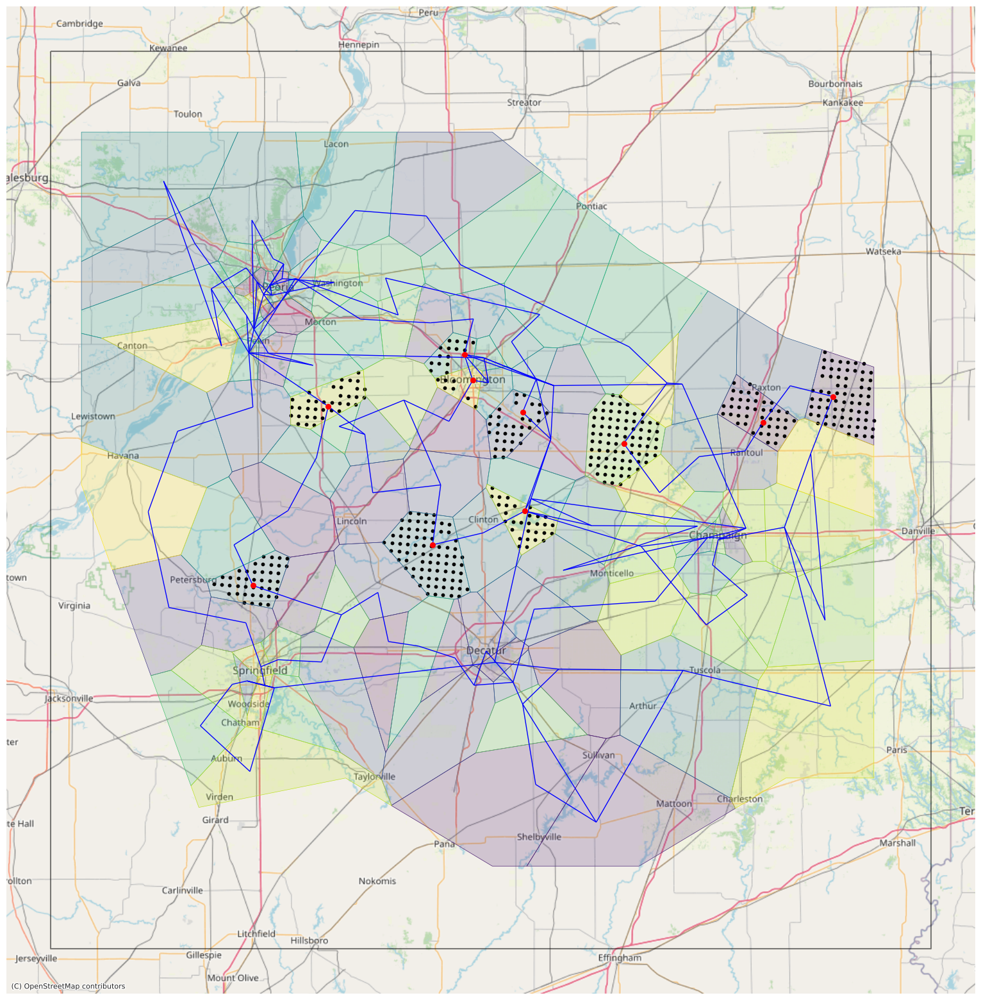

In [77]:
################################
##### plot vor_gdf (new way)
plt.figure()

ax = tamu_box_gdf.boundary.plot(figsize=(20, 20), alpha=0.5, edgecolor="k")

# ########## Voronoi polygons from vor_gdf
vor_gdf.plot(ax=ax, cmap="viridis", linewidth=0.5, alpha=0.2)
# ########## Voronoi polygons boundary only from vor_gdf
vor_gdf.boundary.plot(ax=ax, cmap="viridis", linewidth=0.5, alpha=1)

# # #bus_unique_gdf.plot(ax=ax, color="blue", markersize = 1)
# points_gdf.plot(ax=ax, color="blue", markersize = "size")

# bus_wind_unique_gdf.plot(ax=ax, color="red", markersize = 5)
br_gdf.plot(ax=ax, color="blue", linewidth=1)


############## selected sites
# selected_gdf.plot(ax=ax, color="white", markersize = 5)
selected_gdf.plot(ax=ax, color="black", markersize=10)

############## new wind gens
wind_gen_gdf.plot(ax=ax, color="red", markersize=30, zorder=4)

# ############# all wind gens (buses to which they are connected)
# s = vor_gdf["new_bus_num"] != 0
# connect_bus_nums = vor_gdf.loc[s[s].index,"connect_bus"].values
# bus_gdf.loc[connect_bus_nums].plot(ax=ax, color="red", markersize = 10)

# ################ verify vor_idx coresponds to pt_idx and
# ################ we match num_bus_list numbrs (also use bokeh plot for that)
# ### plot one specific polygon
# vor_idx=0
# vor_gdf.loc[vor_idx:vor_idx].plot(ax=ax, color="red", linewidth = 0.5, )
# ### plot one specific point location
# points_gdf.loc[vor_idx:vor_idx].plot(ax=ax, color="white", markersize = 50, zorder=5)


# ctx.add_basemap(ax, source=ctx.providers.Stamen.Terrain)
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

### save figure
ax.set_axis_off()
filename = os.path.join(save_dir, "buildout_sites.png")
plt.savefig(filename, bbox_inches="tight", pad_inches=0)

[Voronoi](#voronoi)

* build
<a id='build'></a>

[end](#end)

<Figure size 640x480 with 0 Axes>

<AxesSubplot: >

<AxesSubplot: >

<Figure size 640x480 with 0 Axes>

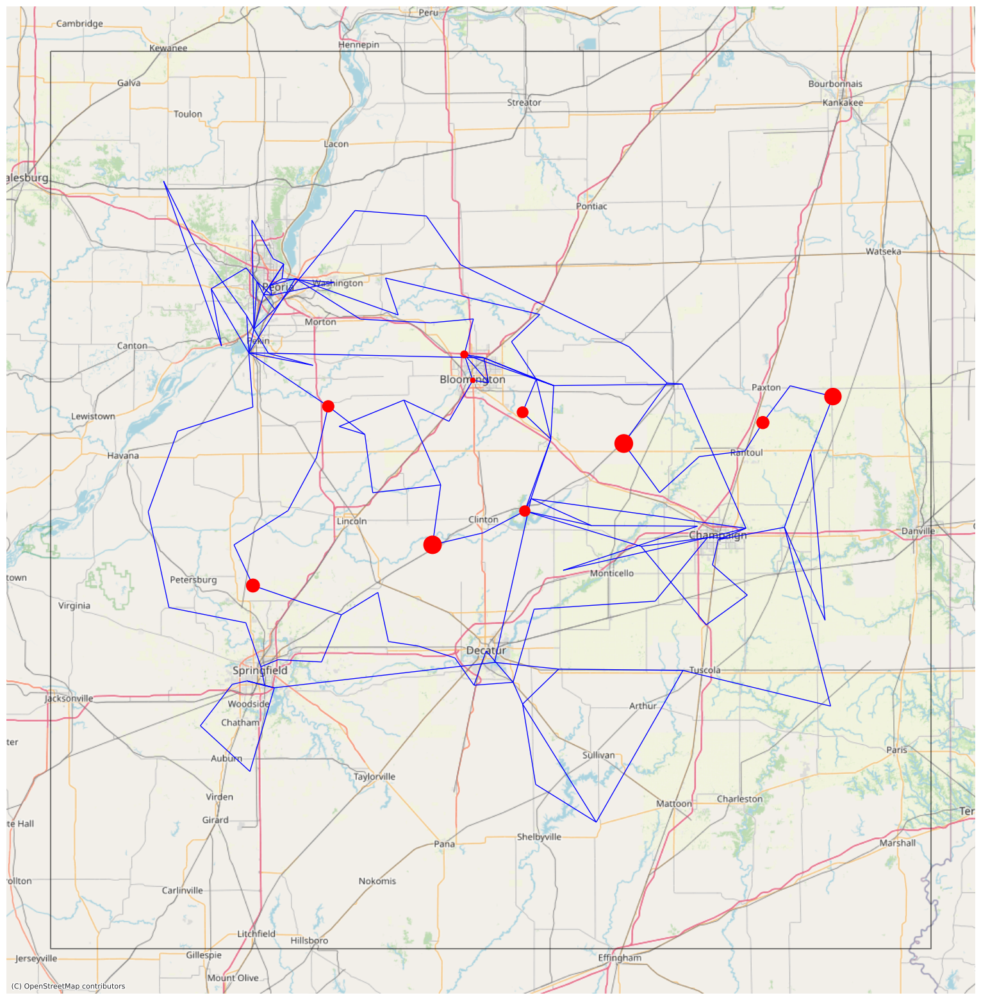

In [78]:
################################
##### plot vor_gdf (new way)
plt.figure()

ax = tamu_box_gdf.boundary.plot(figsize=(20, 20), alpha=0.5, edgecolor="k")

# # ########## Voronoi polygons from vor_gdf
# vor_gdf.plot(ax=ax, cmap="viridis", linewidth = 0.5, alpha = 0.2)
# # ########## Voronoi polygons boundary only from vor_gdf
# vor_gdf.boundary.plot(ax=ax, cmap="viridis", linewidth = 0.5, alpha = 1)

# # #bus_unique_gdf.plot(ax=ax, color="blue", markersize = 1)
# points_gdf.plot(ax=ax, color="blue", markersize = "size")

# bus_wind_unique_gdf.plot(ax=ax, color="red", markersize = 5)
br_gdf.plot(ax=ax, color="blue", linewidth=1)


# ############## selected sites
# selected_gdf.plot(ax=ax, color="white", markersize = 5)

############## new wind gens
wind_gen_gdf.plot(ax=ax, color="red", markersize="GenMWMax", zorder=4)


# ############# all wind gens (buses to which they are connected)
# s = vor_gdf["new_bus_num"] != 0
# connect_bus_nums = vor_gdf.loc[s[s].index,"connect_bus"].values
# bus_gdf.loc[connect_bus_nums].plot(ax=ax, color="red", markersize = 10)


# ################ verify vor_idx coresponds to pt_idx and
# ################ we match num_bus_list numbrs (also use bokeh plot for that)
# ### plot one specific polygon
# vor_idx=0
# vor_gdf.loc[vor_idx:vor_idx].plot(ax=ax, color="red", linewidth = 0.5, )
# ### plot one specific point location
# points_gdf.loc[vor_idx:vor_idx].plot(ax=ax, color="white", markersize = 50, zorder=5)


# ctx.add_basemap(ax, source=ctx.providers.Stamen.Terrain)
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

### save figure
ax.set_axis_off()
filename = os.path.join(save_dir, "buildout_gens.png")
plt.savefig(filename, bbox_inches="tight", pad_inches=0)

In [79]:
#################################################
#### small example on removing and remapping

# branch_df
# brdf = branch_df.head().copy()
# brdf["FromBus"] = [2, 1, 3, 4, 4]
# brdf["ToBus"] = [1, 2, 1, 1, 3]
# brdf.drop(0, inplace=True)
# brdf.drop(1, inplace=True)
# brdf

# bdf = bus_df.head().copy()
# bdf.set_index("BusNum", inplace=True, drop=True)
# bdf
# bdf.drop(2, inplace=True)
# bdf["NewBusNum"] = range(1, len(bdf) + 1)
# # bdf.reset_index(inplace=True)
# # bdf.index = bdf.index + 1
# bdf

# ### old to new
# bmap = bdf["NewBusNum"]
# bmap
# ### reindex to new

# bdf.set_index("NewBusNum",inplace = True)
# bdf

In [80]:
# ################################################
# ### what are the transformers that connect gens?
# ### original wind gens are connected through a transformer
# ### with ration rateA/GenMWMax ~ 1.3
# ### so when connecting new wind gens, set rateA as ~1.3 of GenMWMax
# ### but have a min of rateA=20


# print("\n old wind generators")
# old_gen_df.loc[old_gen_df["GenFuelType"] == "Wind"]
# old_wind_gen_buses = old_gen_df.loc[old_gen_df["GenFuelType"] == "Wind"]["BusNum"]
# # print("\n wind generator buses:")
# # wind_gen_buses

# g_df = old_gen_df.loc[old_gen_df["GenFuelType"] == "Wind"]

# b_df = old_branch_df.loc[
#     (old_branch_df["FromBus"].isin(old_wind_gen_buses))
#     | (old_branch_df["ToBus"].isin(old_wind_gen_buses))
# ]
# print("\n old branches (transformers) connecting old wind generators:")
# b_df

# trans_df = b_df[["FromBus", "ToBus", "r", "x", "b", "rateA"]]
# trans_df["UID"] = trans_df.index
# df = trans_df.set_index("FromBus")
# df["GenMWMax"] = g_df.set_index("BusNum")["GenMWMax"]
# df["GenMWMin"] = g_df.set_index("BusNum")["GenMWMin"]
# trans_df = df
# trans_df["FromBus"] = trans_df.index
# trans_df = trans_df.set_index("UID")

# print("\n transformers connecting wind gens with gen min/max capacities:")
# # a = trans_df.columns[:-1].tolist()
# # b = trans_df.columns[-1:].tolist()
# # trans_df = trans_df[b + a]
# trans_df

# (trans_df["rateA"] / trans_df["GenMWMax"]).iplot(kind="bar", title="rateA/GenMWMax")

# aggregate reV time series: make actuals and scenarios datasets
* for scanario sampling with powerscenarios
* with sites selected can aggregate time series
* for reading one year of reV see tamu200_buildout_part1 notebook


In [81]:
selected_gdf

,cf_mean,latitude,longitude,generation_mwh,geometry,inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,gen_uid
gid,,,,,,,,,,,
1701790,0.439294,40.447346,-87.879610,42330.350,POINT (-9782713.436 4931163.926),0.504132,21340.093802,5.545455,1.325015,0,195_Wind_1
1701789,0.440809,40.428890,-87.882080,42476.340,POINT (-9782988.395 4928464.551),0.492095,20902.388656,5.413043,1.337643,0,195_Wind_1
1700586,0.441145,40.449220,-87.903870,42508.720,POINT (-9785414.047 4931438.058),0.270751,11509.277945,2.978261,1.594265,0,195_Wind_1
1700585,0.441905,40.430767,-87.906310,42581.945,POINT (-9785685.667 4928739.047),0.427686,18211.699618,4.704545,1.603521,0,195_Wind_1
...,...,...,...,...,...,...,...,...,...,...,...
1642188,0.448906,40.495705,-89.074036,43256.550,POINT (-9915676.330 4938240.430),0.278926,12065.360021,3.068182,6.538782,9,204_Wind_1
1640961,0.448952,40.515785,-89.096250,43261.000,POINT (-9918149.182 4941180.290),0.535573,23169.428854,5.891304,6.944438,9,204_Wind_1
1639732,0.454288,40.517380,-89.120544,43775.223,POINT (-9920853.577 4941413.847),0.266798,11679.160287,2.934783,8.858124,9,204_Wind_1
1639731,0.445143,40.498900,-89.122650,42893.953,POINT (-9921088.016 4938708.143),0.423554,18167.893316,4.659091,9.735158,9,204_Wind_1


In [82]:
### rev=0.8.2

years = [2007, 2008, 2009, 2010, 2011, 2012, 2013]

base_dir = run_dir


field_name = "gen_profile"

all_years_df = pd.DataFrame()

for year in years:
    all_df = pd.DataFrame()
    # ## one year
    h5_file_list = glob.glob(os.path.join(base_dir, "*_generation_*" + str(year) + ".h5"))[:]

    for k, filename in enumerate(h5_file_list):
        print("\nk = {} of {} in year {}".format(k, len(h5_file_list), year))
        print("reading file:")
        filename
        #     if k==1:
        #         break
        with h5py.File(filename, "r") as f:
            meta = f.get("meta")
            meta_df = pd.DataFrame(meta[()])
            columns = meta_df["gid"]
            ### check if this file has any gids that are needed
            ### if not, continue onto next file
            if np.intersect1d(columns.values, selected_gdf.index.values).size == 0:
                print("\nno wanted gids in this file, continuing...")
                continue

            time_index = f.get("time_index")
            time_df = pd.DataFrame(time_index[()])
            time_index = pd.to_datetime(time_df[0].map(lambda x: str(x)[2:-1]))

            dataset = f.get(field_name)
            df = pd.DataFrame(dataset[()])

            df.columns = columns
            df.index = time_index

            # drop not used gids: gids that are not in selected_gdf
            drop_list = [x for x in columns if x not in selected_gdf.index]
            df.drop(drop_list, axis=1, inplace=True)

            ## concat on gids (columns)
            all_df = pd.concat([all_df, df], axis=1)

    ## concat on timestamp (index)
    all_years_df = pd.concat([all_years_df, all_df], axis=0)

all_years_df


k = 0 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j005_2007.h5'


k = 1 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j000_2007.h5'


no wanted gids in this file, continuing...

k = 2 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j011_2007.h5'


k = 3 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j018_2007.h5'


k = 4 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j001_2007.h5'


no wanted gids in this file, continuing...

k = 5 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j003_2007.h5'


k = 6 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j013_2007.h5'


k = 7 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j007_2007.h5'


k = 8 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j009_2007.h5'


k = 9 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j016_2007.h5'


k = 10 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j019_2007.h5'


no wanted gids in this file, continuing...

k = 11 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j017_2007.h5'


k = 12 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j012_2007.h5'


k = 13 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j010_2007.h5'


k = 14 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j002_2007.h5'


no wanted gids in this file, continuing...

k = 15 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j014_2007.h5'


no wanted gids in this file, continuing...

k = 16 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j004_2007.h5'


k = 17 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j008_2007.h5'


k = 18 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j006_2007.h5'


k = 19 of 20 in year 2007
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j015_2007.h5'


k = 0 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j030_2008.h5'


k = 1 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j038_2008.h5'


k = 2 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j022_2008.h5'


no wanted gids in this file, continuing...

k = 3 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j035_2008.h5'


k = 4 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j032_2008.h5'


k = 5 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j028_2008.h5'


k = 6 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j029_2008.h5'


k = 7 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j024_2008.h5'


k = 8 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j036_2008.h5'


k = 9 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j031_2008.h5'


k = 10 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j025_2008.h5'


k = 11 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j039_2008.h5'


no wanted gids in this file, continuing...

k = 12 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j026_2008.h5'


k = 13 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j033_2008.h5'


k = 14 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j023_2008.h5'


k = 15 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j037_2008.h5'


k = 16 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j020_2008.h5'


no wanted gids in this file, continuing...

k = 17 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j021_2008.h5'


no wanted gids in this file, continuing...

k = 18 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j027_2008.h5'


k = 19 of 20 in year 2008
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j034_2008.h5'


no wanted gids in this file, continuing...

k = 0 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j051_2009.h5'


k = 1 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j058_2009.h5'


k = 2 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j053_2009.h5'


k = 3 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j042_2009.h5'


no wanted gids in this file, continuing...

k = 4 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j050_2009.h5'


k = 5 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j057_2009.h5'


k = 6 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j047_2009.h5'


k = 7 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j056_2009.h5'


k = 8 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j048_2009.h5'


k = 9 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j054_2009.h5'


no wanted gids in this file, continuing...

k = 10 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j046_2009.h5'


k = 11 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j049_2009.h5'


k = 12 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j055_2009.h5'


k = 13 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j045_2009.h5'


k = 14 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j059_2009.h5'


no wanted gids in this file, continuing...

k = 15 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j041_2009.h5'


no wanted gids in this file, continuing...

k = 16 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j043_2009.h5'


k = 17 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j052_2009.h5'


k = 18 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j044_2009.h5'


k = 19 of 20 in year 2009
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j040_2009.h5'


no wanted gids in this file, continuing...

k = 0 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j066_2010.h5'


k = 1 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j075_2010.h5'


k = 2 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j061_2010.h5'


no wanted gids in this file, continuing...

k = 3 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j060_2010.h5'


no wanted gids in this file, continuing...

k = 4 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j071_2010.h5'


k = 5 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j067_2010.h5'


k = 6 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j063_2010.h5'


k = 7 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j078_2010.h5'


k = 8 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j072_2010.h5'


k = 9 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j068_2010.h5'


k = 10 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j074_2010.h5'


no wanted gids in this file, continuing...

k = 11 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j069_2010.h5'


k = 12 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j077_2010.h5'


k = 13 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j076_2010.h5'


k = 14 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j062_2010.h5'


no wanted gids in this file, continuing...

k = 15 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j073_2010.h5'


k = 16 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j079_2010.h5'


no wanted gids in this file, continuing...

k = 17 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j070_2010.h5'


k = 18 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j065_2010.h5'


k = 19 of 20 in year 2010
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j064_2010.h5'


k = 0 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j099_2011.h5'


no wanted gids in this file, continuing...

k = 1 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j090_2011.h5'


k = 2 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j080_2011.h5'


no wanted gids in this file, continuing...

k = 3 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j094_2011.h5'


no wanted gids in this file, continuing...

k = 4 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j092_2011.h5'


k = 5 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j082_2011.h5'


no wanted gids in this file, continuing...

k = 6 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j086_2011.h5'


k = 7 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j081_2011.h5'


no wanted gids in this file, continuing...

k = 8 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j097_2011.h5'


k = 9 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j088_2011.h5'


k = 10 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j083_2011.h5'


k = 11 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j096_2011.h5'


k = 12 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j091_2011.h5'


k = 13 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j093_2011.h5'


k = 14 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j098_2011.h5'


k = 15 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j095_2011.h5'


k = 16 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j084_2011.h5'


k = 17 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j089_2011.h5'


k = 18 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j087_2011.h5'


k = 19 of 20 in year 2011
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j085_2011.h5'


k = 0 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j118_2012.h5'


k = 1 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j105_2012.h5'


k = 2 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j102_2012.h5'


no wanted gids in this file, continuing...

k = 3 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j119_2012.h5'


no wanted gids in this file, continuing...

k = 4 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j107_2012.h5'


k = 5 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j111_2012.h5'


k = 6 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j101_2012.h5'


no wanted gids in this file, continuing...

k = 7 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j110_2012.h5'


k = 8 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j112_2012.h5'


k = 9 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j103_2012.h5'


k = 10 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j104_2012.h5'


k = 11 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j113_2012.h5'


k = 12 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j115_2012.h5'


k = 13 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j100_2012.h5'


no wanted gids in this file, continuing...

k = 14 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j117_2012.h5'


k = 15 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j108_2012.h5'


k = 16 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j109_2012.h5'


k = 17 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j116_2012.h5'


k = 18 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j106_2012.h5'


k = 19 of 20 in year 2012
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j114_2012.h5'


no wanted gids in this file, continuing...

k = 0 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j134_2013.h5'


no wanted gids in this file, continuing...

k = 1 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j130_2013.h5'


k = 2 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j124_2013.h5'


k = 3 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j131_2013.h5'


k = 4 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j125_2013.h5'


k = 5 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j132_2013.h5'


k = 6 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j127_2013.h5'


k = 7 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j139_2013.h5'


no wanted gids in this file, continuing...

k = 8 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j138_2013.h5'


k = 9 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j123_2013.h5'


k = 10 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j136_2013.h5'


k = 11 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j133_2013.h5'


k = 12 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j135_2013.h5'


k = 13 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j121_2013.h5'


no wanted gids in this file, continuing...

k = 14 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j129_2013.h5'


k = 15 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j120_2013.h5'


no wanted gids in this file, continuing...

k = 16 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j126_2013.h5'


k = 17 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j128_2013.h5'


k = 18 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j137_2013.h5'


k = 19 of 20 in year 2013
reading file:


'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/wind-gen-tamu200-v8_generation_j122_2013.h5'


no wanted gids in this file, continuing...


gid,1617513,1617514,1617515,1617516,1617517,1617518,1617519,1618747,1618748,1618749,1618750,1618751,1618752,1618770,1618771,...,1688506,1688507,1688508,1688509,1688510,1688511,1689715,1689718,1689719,1689720,1690924,1690925,1690926,1690927,1690928
0,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2007-01-01 00:00:00+00:00,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,...,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0
2007-01-01 00:05:00+00:00,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,...,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0
2007-01-01 00:10:00+00:00,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,...,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0
2007-01-01 00:15:00+00:00,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,...,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2013-12-31 23:40:00+00:00,1071.198975,1162.757446,1269.361572,1287.568970,1179.380737,1088.196655,989.572754,1131.478271,1244.140015,1269.630493,1171.456543,1081.072266,941.098145,429.601379,592.420166,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2013-12-31 23:45:00+00:00,1077.679077,1130.682129,1252.467896,1296.018188,1219.585449,1149.521851,1042.628418,1099.832275,1218.798584,1269.630493,1211.108032,1133.351807,975.486755,433.888580,619.075562,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2013-12-31 23:50:00+00:00,1100.658325,1084.731567,1218.680176,1269.457886,1244.931519,1195.076904,1071.929688,1084.516357,1193.457642,1218.945923,1228.005127,1187.343994,1010.517761,419.250671,619.075562,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2013-12-31 23:55:00+00:00,1161.935913,1061.756104,1210.233643,1227.222534,1236.482666,1228.878174,1094.920532,1099.832275,1218.798584,1218.945923,1228.005127,1238.054810,1056.498901,410.170380,624.531738,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [83]:
print("\n all_years_df:")
all_years_df


 all_years_df:


gid,1617513,1617514,1617515,1617516,1617517,1617518,1617519,1618747,1618748,1618749,1618750,1618751,1618752,1618770,1618771,...,1688506,1688507,1688508,1688509,1688510,1688511,1689715,1689718,1689719,1689720,1690924,1690925,1690926,1690927,1690928
0,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2007-01-01 00:00:00+00:00,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,...,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0
2007-01-01 00:05:00+00:00,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,...,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0
2007-01-01 00:10:00+00:00,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,...,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0
2007-01-01 00:15:00+00:00,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,9702.000000,...,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0,9702.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2013-12-31 23:40:00+00:00,1071.198975,1162.757446,1269.361572,1287.568970,1179.380737,1088.196655,989.572754,1131.478271,1244.140015,1269.630493,1171.456543,1081.072266,941.098145,429.601379,592.420166,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2013-12-31 23:45:00+00:00,1077.679077,1130.682129,1252.467896,1296.018188,1219.585449,1149.521851,1042.628418,1099.832275,1218.798584,1269.630493,1211.108032,1133.351807,975.486755,433.888580,619.075562,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2013-12-31 23:50:00+00:00,1100.658325,1084.731567,1218.680176,1269.457886,1244.931519,1195.076904,1071.929688,1084.516357,1193.457642,1218.945923,1228.005127,1187.343994,1010.517761,419.250671,619.075562,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2013-12-31 23:55:00+00:00,1161.935913,1061.756104,1210.233643,1227.222534,1236.482666,1228.878174,1094.920532,1099.832275,1218.798584,1218.945923,1228.005127,1238.054810,1056.498901,410.170380,624.531738,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [84]:
all_df = all_years_df
all_df = all_df.reindex(sorted(all_df.columns), axis=1)
# multiply each gen timeseries by inclusion factor
all_df = all_df * selected_gdf["inclusion"]

# aggregate by bus
all_df = all_df.groupby(by=selected_gdf["gen_uid"], axis=1).sum()
all_df.index.name = "timestamp"
# to magawatts
all_df = all_df * 1e-3
wind_df = all_df
wind_df

/tmp/ipykernel_3394412/2706431512.py:7: FutureWarning:

DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.



gen_uid,195_Wind_1,196_Wind_1,197_Wind_1,198_Wind_1,199_Wind_1,200_Wind_1,201_Wind_1,202_Wind_1,203_Wind_1,204_Wind_1
timestamp,,,,,,,,,,
2007-01-01 00:00:00+00:00,305.655443,355.977416,144.726089,121.070702,23.792072,167.328421,189.892448,133.099238,346.042880,56.532418
2007-01-01 00:05:00+00:00,305.655443,355.977416,145.008745,121.070702,23.792072,167.328421,189.892448,133.099238,346.042880,56.532418
2007-01-01 00:10:00+00:00,305.655443,355.977416,145.052240,121.070702,23.792072,167.328421,189.892448,133.099238,346.042880,56.532418
2007-01-01 00:15:00+00:00,305.655443,355.977416,145.132790,121.070702,23.792072,167.328421,189.892448,133.099238,346.042880,56.532418
...,...,...,...,...,...,...,...,...,...,...
2013-12-31 23:40:00+00:00,0.000000,0.000000,5.356107,4.497230,0.000000,0.000000,22.971192,0.000000,23.040868,0.000000
2013-12-31 23:45:00+00:00,0.000000,0.000000,5.586204,4.767644,0.000000,0.000000,23.606528,0.000000,25.491528,0.000000
2013-12-31 23:50:00+00:00,0.000000,0.000000,5.826298,5.007056,0.000000,0.000000,23.823932,0.000000,27.847416,0.000000
2013-12-31 23:55:00+00:00,0.000000,0.000000,6.269914,5.274732,0.000000,0.000000,23.970968,0.000000,30.288818,0.008112


In [85]:
print("\nany na's in wind_df?")
wind_df.isna().any().any()
print("\nmin value of wind_df:")
wind_df.min().min()
print("\nmax value of wind_df:")
wind_df.max().max()


any na's in wind_df?


False


min value of wind_df:


0.0


max value of wind_df:


355.9774163679326

## save/load
* aggregated wind timeseries
* just need to be split into actuals and scenarios df

In [86]:
#### save
filename = "wind_df.csv"
wind_df.to_csv(os.path.join(save_dir, filename))

#### remember to delete all_years_df as it is not needed and takes a lot of place

### continue ...
* only needed if want to use powerscenarios package for creating scenarios
* else, if only timeseries are need, can stop here
* start with wind_df, and create .h5 tables to use in powerscenarios

In [87]:
save_dir

'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/buildouts/work_dir/option2_seed2-ngens10-pen89'

In [88]:
buildout_dir = save_dir
buildout_dir

'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/buildouts/work_dir/option2_seed2-ngens10-pen89'

In [89]:
# ###################################################################
# #### uncomment if started with continue 4
# #### read saved files

# filename = "gen_df.csv"
# gen_df = pd.read_csv(os.path.join(buildout_dir, filename), index_col=0)
# print("\ngen_df:")
# gen_df

# filename = "wind_gen_df.csv"
# wind_gen_df = pd.read_csv(os.path.join(buildout_dir, filename), index_col=0)
# print("\nwind_gen_df:")
# wind_gen_df

# print("\n total wind capacity for buildout {}".format(nameplate_factor))
# wind_gen_df["GenMWMax"].sum()


# ###
# filename = "wind_df.csv"
# wind_df = pd.read_csv(os.path.join(buildout_dir, filename), index_col=0, parse_dates=True)

# print("\nwind_df:")
# wind_df

# #### load wind_gen_location_gdf (similar to vor_gdf, except geometry contains points)
# filename = "selected_gdf.csv"
# selected_df = pd.read_csv(os.path.join(buildout_dir, filename), index_col=0)
# # vor_df

# selected_gdf = gpd.GeoDataFrame(
#     selected_df,
#     crs="epsg:3857",
#     geometry=[
#         shapely.wkt.loads(selected_df.loc[location_idx, "geometry"])
#         for location_idx in selected_df.index
#     ],
# )

# print("\nselected_gdf:")
# selected_gdf

## sanity check

In [90]:
### wind_df
start = pd.Timestamp("2007-07-01 00:00:00+00:00")
end = pd.Timestamp("2007-07-03 00:00:00+00:00")
wind_df.loc[start:end].sum(axis=1).iplot(
    title="Total wind power on the grid", yTitle="MW"
)

In [91]:
# ###### print("\n\nEXACTLY MAX POWER:")
# ### exactly maxes
# for wind_farm in wind_df.max().index:
#     print(wind_farm)
#     maxes_s = wind_df.loc[wind_df[wind_farm] == wind_df.max().loc[wind_farm]]

#     print(
#         "wind farm {} run at its max power {} fraction of the time ".format(
#             wind_farm, round(len(maxes_s) / len(wind_df), 4)
#         )
#     )

# print("\n\nALMOST MAX POWER:")
# ### almost maxes

# ### tolerance in MW
# tol = 1
# ### tolerance in % of nameplate
# nameplate = wind_gen_df.loc[wind_gen_df["GenUID"] == wind_gen, "GenMWMax"].values[0]
# tol = nameplate * 0.05

# for wind_farm in wind_df.max().index:
#     print(wind_farm)
#     almost_maxes_s = wind_df[wind_farm].loc[
#         abs(wind_df[wind_farm] - wind_df.max().loc[wind_farm]) < tol
#     ]

#     print(
#         "wind farm {} run at its almost (within {}MW) max power {} fraction of the time ".format(
#             wind_farm, round(tol, 2), round(len(almost_maxes_s) / len(wind_df), 4)
#         )
#     )

# create .h5 tables for use in scenario sampling

* create tbales needed to instantiate Grid in powerscenarios:
* wind_sites_df, actuals_df, scenarios_df
* selected_gdf -> wind_sites_df
* wind_df -> actuals_df and scenarios_df
* NOTE: grid.wind_sites is not necessarily needed if we already have grid.actuals and grid.scenarios

In [92]:
save_dir

'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/buildouts/work_dir/option2_seed2-ngens10-pen89'

In [93]:
### save_tables_dir == buildout_dir

#### save tables
save_tables_dir = os.path.join(save_dir, "tables-data")

if not os.path.exists(save_tables_dir):
    os.makedirs(save_tables_dir)

In [94]:
# # ## save after retrieve_wind_sites and make_tables
# save_dir = "/Users/isatkaus/projects/ecp/public-github/powerscenarios/data/tables-data/m-file-Pmax/"

# filename = "{}_wind_sites_df.h5".format(grid_name)
# grid.wind_sites.to_hdf(os.path.join(save_dir,filename),'MW',  mode='w')
# filename = "{}_actuals_df.h5".format(grid_name)
# grid.actuals.to_hdf(os.path.join(save_dir,filename),'MW',  mode='w')
# filename = "{}_scenarios_df.h5".format(grid_name)
# grid.scenarios.to_hdf(os.path.join(save_dir,filename),'MW',  mode='w')

In [95]:
gen_df

,BusNum,GenID,GenMWMax,GenMWMin,GenWindPowerFactor,GenFuelType,GenUID,BusName,Latitude,Longitude,Zone
0,49,1,4.530000,1.360000,1.0,Coal,49_Coal_1,RANTOUL21,40.312222,-88.159444,6
1,50,1,4.530000,1.360000,1.0,Coal,50_Coal_1,RANTOUL22,40.312222,-88.159444,6
2,51,1,4.530000,1.360000,1.0,Coal,51_Coal_1,RANTOUL23,40.312222,-88.159444,6
3,52,1,4.530000,1.360000,1.0,Coal,52_Coal_1,RANTOUL24,40.312222,-88.159444,6
...,...,...,...,...,...,...,...,...,...,...,...
39,177,1,26.600000,7.980000,1.0,Coal,183_Coal_1,SPRINGFIELD22,39.806868,-89.641653,4
40,183,1,569.150019,170.749998,1.0,Nuclear,189_Nuclear_1,CLINTON12,40.171900,-88.833900,7
41,190,1,67.500001,20.250000,1.0,NaturalGas,196_NaturalGas_1,GIBSONCITY11,40.470500,-88.398700,6
42,191,1,67.500001,20.250000,1.0,NaturalGas,197_NaturalGas_1,GIBSONCITY12,40.470500,-88.398700,6


# ACTIVSg200_m_gen.csv (can skip next few cells)
* next 4 commented out cells are not needed
* for Julia use create: ACTIVSg200_m_gen.csv from original case_ACTIVSg200.m (parsed by Grid.Parser). i.e. modify existing gen capacities
* TODO: for buildouts with creation of new gens: this step should include adding gens
* TODO: for Exago use create: case_ACTIVSg200.m 

In [96]:
# ### first parse case_ACTIVSg200.m
# parser = Parser()

# filename = "/home/isatkaus/projects/ecp/powerscenarios/data/grid-data/ACTIVSg200/case_ACTIVSg200.m"

# # read gen table from case_m_file
# table_name = "mpc.gen"
# column_names = [
#     "bus",
#     "Pg",
#     "Qg",
#     "Qmax",
#     "Qmin",
#     "Vg",
#     "mBase",
#     "status",
#     "Pmax",
#     "Pmin",
#     "Pc1",
#     "Pc2",
#     "Qc1min",
#     "Qc1max",
#     "Qc2min",
#     "Qc2max",
#     "ramp_agc",
#     "ramp_10",
#     "ramp_30",
#     "ramp_q",
#     "apf",
#     "mu_Pmax",
#     "mu_Pmin",
#     "mu_Qmax",
#     "mu_Qmin",
# ]
# # this table is entirely numeric
# numeric_columns = column_names

# m_gen_df = parser.read_m_table(
#     filename,
#     table_name=table_name,
#     column_names=column_names,
#     numeric_columns=numeric_columns,
# )


# # read gentype and genfuel series and add it to m_gen_df
# gentype_s = parser.read_m_series(filename, series_name="mpc.gentype")
# genfuel_s = parser.read_m_series(filename, series_name="mpc.genfuel")
# m_gen_df["type"] = gentype_s
# m_gen_df["fuel"] = genfuel_s

# m_gen_df

# # read gencost table and add cost coeficients to gen table
# # contains only quadratic polynomial cost coefficients, and no startup or shutdown costs
# table_name = "mpc.gencost"
# column_names = [
#     "model",
#     "startup",
#     "shutdown",
#     "ncost",
#     "c2",
#     "c1",
#     "c0",
# ]

# # this table is entirely numeric
# numeric_columns = column_names

# gencost_df = parser.read_m_table(
#     filename,
#     table_name=table_name,
#     column_names=column_names,
#     numeric_columns=numeric_columns,
# )
# gencost_df

# # add cost coefficients to gen table
# m_gen_df["ncost"] = gencost_df["ncost"]  # degree of polynomial
# m_gen_df["cost_c0"] = gencost_df["c0"]
# m_gen_df["cost_c1"] = gencost_df["c1"]
# m_gen_df["cost_c2"] = gencost_df["c2"]

# m_gen_df

In [97]:
# ### modify for testing purposes (will need that in tamu2k)
# wind_gen_df.loc[6] = wind_gen_df.loc[5]
# wind_gen_df.loc[6, "GenID"] = 2
# wind_gen_df.loc[6, "GenMWMax"] = 500
# wind_gen_df

# m_gen_df.loc[m_gen_df["bus"] == 147]
# m_gen_df.loc[30]
# m_gen_df.loc[49] = m_gen_df.loc[30]
# m_gen_df

In [98]:
# ### modify m_gen_df according to gen_df (or wind_gen_df)

# for idx in wind_gen_df.index[:]:
#     bus_num = wind_gen_df.loc[idx,"BusNum"]
#     #bus_num = 147
#     print("\n bus_num = {}".format(bus_num))
#     #gen_id = wind_gen_df.loc[idx,"GenID"]
#     ### at one bus_num there might be more than one wind gen
#     modified_gens_at_bus_df = wind_gen_df.loc[wind_gen_df["BusNum"]==bus_num].copy()
#     existing_gens_at_bus_df = m_gen_df.loc[m_gen_df["bus"]==bus_num]
#     print("\n modified_gens_at_bus_df")
#     modified_gens_at_bus_df
#     print("\n existing_gens_at_bus_df")
#     existing_gens_at_bus_df
#     ### sanity check:
#     if len(modified_gens_at_bus_df) != len(existing_gens_at_bus_df):
#         raise ValueError("len(modified_gens_at_bus_df) != len(existing_gens_at_bus_df) at bus {}. Investigate!!".format(bus_num))

#     for i in range(len(modified_gens_at_bus_df)):
#         modified_cap = modified_gens_at_bus_df.iloc[i]["GenMWMax"]
#         modified_cap
#         print("\n  modified_cap = {}".format(modified_cap))
#         existing_gen_idx = existing_gens_at_bus_df.iloc[i].name
#         existing_gen_idx
#         print("\n  existing_gen_idx = {}".format(existing_gen_idx))
#         ## modify existing gen capacity
#         print("\n modifying gen cap at bus {} with new value {}".format(bus_num,modified_cap))
#         m_gen_df.loc[existing_gen_idx,"Pmax"] = modified_cap
#         m_gen_df.loc[existing_gen_idx:existing_gen_idx]

## check and save

In [99]:
# ################
# ### sanity check
# ################
# m_gen_df.loc[m_gen_df["fuel"] == "wind"]
# wind_gen_df
# m_gen_df.set_index("bus").loc[m_gen_df.set_index("bus")["fuel"] == "wind","Pmax"]
# wind_gen_df.set_index("BusNum")["GenMWMax"]
# print("\n all capacities modified correctly?")
# ((m_gen_df.set_index("bus").loc[m_gen_df.set_index("bus")["fuel"] == "wind","Pmax"] - wind_gen_df.set_index("BusNum")["GenMWMax"])
# ==0).all()

# ################
# ### save as csv
# ################
# filename = "{}_m_gen.csv".format(grid_name)
# print("\nsaving m_gen_df to: {}".format(os.path.join(buildout_dir, filename)))
# m_gen_df.to_csv(os.path.join(buildout_dir, filename))

## wind_sites_df
* create and save in .csv and .h5 formats

In [100]:
grid.wind_sites

,SiteID,Capacity,Point,Latitude,Longitude,BusNum,GenUID
0,54007,16.0,POINT (-88.02514600000001 40.458515),40.458515,-88.025146,65,65_Wind_1
1,54196,16.0,POINT (-88.02273599999999 40.476978),40.476978,-88.022736,65,65_Wind_1
2,54008,16.0,POINT (-88.000885 40.456665),40.456665,-88.000885,65,65_Wind_1
3,53833,16.0,POINT (-88.02758799999999 40.440052),40.440052,-88.027588,65,65_Wind_1
...,...,...,...,...,...,...,...
46,51597,16.0,POINT (-89.412201 40.312679),40.312679,-89.412201,147,147_Wind_1
47,51598,16.0,POINT (-89.38797 40.311146),40.311146,-89.387970,147,147_Wind_1
48,51599,16.0,POINT (-89.363708 40.30962),40.309620,-89.363708,147,147_Wind_1
49,51429,16.0,POINT (-89.414215 40.294193),40.294193,-89.414215,147,147_Wind_1


In [101]:
gdf = selected_gdf.copy()

## turn to lat/lon crs
gdf = gdf.to_crs(epsg=4326)

## turn to pd.DataFrame first, GeoDataFrame causes problems with saving as .h5
## change geometry type to object type (i.e. string)
df = pd.DataFrame(gdf)
df["geometry"] = df["geometry"].astype("str")


df["BusNum"] = df["gen_uid"].str.split("_", expand=True)[0]

df.reset_index(inplace=True)

## rename columns to be similar to grid.wind_sites convention
## NOTE it will be different: SiteID only works for TE data set; and GID is for full toolkit only
df.rename(
    columns={
        "gid": "GID",
        "cf_mean": "CF",
        "latitude": "Latitude",
        "longitude": "Longitude",
        "generation_mwh": "GenerationMWh",
        "geometry": "Point",
        "inclusion": "Inclusion",
        "capacity_mw": "CapacityMW",
        "gen_uid": "GenUID",
    },
    inplace=True,
)


## save as csv
filename = "{}_wind_sites_df.csv".format(grid_name)
print("\nsaving wind_sites_df to: {}".format(os.path.join(save_tables_dir, filename)))
pd.DataFrame(df).to_csv(os.path.join(save_tables_dir, filename))

### save as .h5 (turn to pd.DataFrame first, GeoDataFrame causes problems)
filename = "{}_wind_sites_df.h5".format(grid_name)
print("\nsaving wind_sites_df to: {}".format(os.path.join(save_tables_dir, filename)))
pd.DataFrame(df).to_hdf(os.path.join(save_tables_dir, filename), "MW", mode="w")

df


saving wind_sites_df to: /home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/buildouts/work_dir/option2_seed2-ngens10-pen89/tables-data/ACTIVSg200_wind_sites_df.csv

saving wind_sites_df to: /home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/buildouts/work_dir/option2_seed2-ngens10-pen89/tables-data/ACTIVSg200_wind_sites_df.h5


,GID,CF,Latitude,Longitude,GenerationMWh,Point,Inclusion,incl_generation_mwh,incl_capacity_mw,dist_to_connect_bus,gen_idx,GenUID,BusNum
0,1701790,0.439294,40.447346,-87.879610,42330.350,POINT (-87.87961 40.447346),0.504132,21340.093802,5.545455,1.325015,0,195_Wind_1,195
1,1701789,0.440809,40.428890,-87.882080,42476.340,POINT (-87.88208 40.42889),0.492095,20902.388656,5.413043,1.337643,0,195_Wind_1,195
2,1700586,0.441145,40.449220,-87.903870,42508.720,POINT (-87.90387 40.44922),0.270751,11509.277945,2.978261,1.594265,0,195_Wind_1,195
3,1700585,0.441905,40.430767,-87.906310,42581.945,POINT (-87.90631 40.430767),0.427686,18211.699618,4.704545,1.603521,0,195_Wind_1,195
...,...,...,...,...,...,...,...,...,...,...,...,...,...
433,1642188,0.448906,40.495705,-89.074036,43256.550,POINT (-89.074036 40.495705),0.278926,12065.360021,3.068182,6.538782,9,204_Wind_1,204
434,1640961,0.448952,40.515785,-89.096250,43261.000,POINT (-89.09625 40.515785),0.535573,23169.428854,5.891304,6.944438,9,204_Wind_1,204
435,1639732,0.454288,40.517380,-89.120544,43775.223,POINT (-89.120544 40.51738),0.266798,11679.160287,2.934783,8.858124,9,204_Wind_1,204
436,1639731,0.445143,40.498900,-89.122650,42893.953,POINT (-89.12265 40.4989),0.423554,18167.893316,4.659091,9.735158,9,204_Wind_1,204


## actuals_df
* create and save in .csv and .h5 formats

In [102]:
### original actuals
grid.actuals

,65_Wind_1,104_Wind_1,105_Wind_1,114_Wind_1,115_Wind_1,147_Wind_1,TotalPower
IssueTime,,,,,,,
2020-01-01 00:00:00+00:00,142.094736,99.000001,198.000002,1.7,150.000000,100.500000,691.294739
2020-01-01 00:05:00+00:00,140.804726,99.000001,198.000002,1.7,150.000000,100.500000,690.004728
2020-01-01 00:10:00+00:00,142.361249,99.000001,198.000002,1.7,150.000000,100.500000,691.561251
2020-01-01 00:15:00+00:00,145.972502,99.000001,198.000002,1.7,150.000000,100.500000,695.172504
...,...,...,...,...,...,...,...
2020-12-31 23:40:00+00:00,0.060166,15.138214,24.662171,1.7,32.497064,21.473197,95.530814
2020-12-31 23:45:00+00:00,0.195194,15.827590,27.014071,1.7,32.212875,24.861496,101.811227
2020-12-31 23:50:00+00:00,0.397398,16.547275,29.256746,1.7,29.996480,27.771966,105.669866
2020-12-31 23:55:00+00:00,0.575895,17.458859,31.337020,1.7,25.093633,30.581562,106.746968


In [103]:
### create actuals df
df = wind_df.loc[wind_df.index.year == 2007].copy()

df.columns.name = None
df.index.name = "IssueTime"

max_gen_s = wind_gen_df[["GenMWMax", "GenUID"]].set_index("GenUID")["GenMWMax"]
print("\n max_gen_s:")
max_gen_s
## check for if actuals are always < GenMWMax, else replace with GenMWMax
print("\ncheck if actuals are always < GenMWMax, else replace with GenMWMax:")
df.where(df.lt(max_gen_s), other=max_gen_s, axis=1, inplace=True)

print("\nadding TotalPower column, since grid actuals require it")
df["TotalPower"] = df.sum(axis=1)


# ## save as .csv
filename = "{}_actuals_df.csv".format(grid_name)
print("\nsaving actuals_df to: {}".format(os.path.join(save_tables_dir, filename)))
df.to_csv(os.path.join(save_tables_dir, filename))


### save as .h5
filename = "{}_actuals_df.h5".format(grid_name)
df.to_hdf(os.path.join(save_tables_dir, filename), "MW", mode="w")

df


 max_gen_s:


GenUID
195_Wind_1    346.548122
196_Wind_1    403.602513
197_Wind_1    164.590336
198_Wind_1    137.268369
                 ...    
201_Wind_1    215.297560
202_Wind_1    150.906166
203_Wind_1    392.338866
204_Wind_1     64.095711
Name: GenMWMax, Length: 10, dtype: float64


check if actuals are always < GenMWMax, else replace with GenMWMax:

adding TotalPower column, since grid actuals require it

saving actuals_df to: /home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/buildouts/work_dir/option2_seed2-ngens10-pen89/tables-data/ACTIVSg200_actuals_df.csv


,195_Wind_1,196_Wind_1,197_Wind_1,198_Wind_1,199_Wind_1,200_Wind_1,201_Wind_1,202_Wind_1,203_Wind_1,204_Wind_1,TotalPower
IssueTime,,,,,,,,,,,
2007-01-01 00:00:00+00:00,305.655443,355.977416,144.726089,121.070702,23.792072,167.328421,189.892448,133.099238,346.042880,56.532418,1844.117126
2007-01-01 00:05:00+00:00,305.655443,355.977416,145.008745,121.070702,23.792072,167.328421,189.892448,133.099238,346.042880,56.532418,1844.399782
2007-01-01 00:10:00+00:00,305.655443,355.977416,145.052240,121.070702,23.792072,167.328421,189.892448,133.099238,346.042880,56.532418,1844.443277
2007-01-01 00:15:00+00:00,305.655443,355.977416,145.132790,121.070702,23.792072,167.328421,189.892448,133.099238,346.042880,56.532418,1844.523827
...,...,...,...,...,...,...,...,...,...,...,...
2007-12-31 23:40:00+00:00,0.000000,5.534621,33.271452,20.765166,7.390098,0.975631,89.609520,32.336251,166.161135,17.544066,373.587940
2007-12-31 23:45:00+00:00,0.000000,13.391008,36.943963,27.900638,7.529008,2.342859,91.925645,36.842875,174.559469,16.789519,408.224982
2007-12-31 23:50:00+00:00,0.232375,21.718472,40.465771,34.923500,7.347266,3.761926,98.838285,40.378571,179.833854,14.686814,442.186834
2007-12-31 23:55:00+00:00,2.421894,29.583868,44.274333,41.187043,6.788923,5.121735,108.725496,43.317514,187.830804,12.430322,481.681933


## scenarios_df
* create and save in .csv and .h5 formats
* NOTE: leap years are not right still 2008 and 2012 are missing entire day of Dec31


In [104]:
### check leap years missing timestamps
print("\n If Key errors - leap years are not fixed in reV runs:")
t1 = pd.Timestamp("2008-12-31 12:00:00+00:00")
try:
    all_df.loc[t1]
except KeyError as e:
    print(f"\n I got a KeyError - reason {str(e)}")


t2 = pd.Timestamp("2012-12-31 12:00:00+00:00")
try:
    all_df.loc[t2]
except KeyError as e:
    print(f"\n I got a KeyError - reason {str(e)}")


 If Key errors - leap years are not fixed in reV runs:

 I got a KeyError - reason Timestamp('2008-12-31 12:00:00+0000', tz='UTC')

 I got a KeyError - reason Timestamp('2012-12-31 12:00:00+0000', tz='UTC')


In [105]:
### create scenarios df
df = wind_df.loc[wind_df.index.year != 2007].copy()

df.columns.name = None
df.index.name = "IssueTime"


### don't think we need to
# print("\ncheck if scenarios are always < GenMWMax, else replace with GenMWMax:")
# df.where(df.lt(max_gen_s), other=max_gen_s, axis=1, inplace=True)


# add total power column (accross all generators)
df["TotalPower"] = df.sum(axis=1).values

# compute deviations
# i.e. make error calculations (instead of full power at each bus, have deviations from persistence)

# deviations from persistence at generators
gen_deviations_array = df.iloc[1:, :-1].values - df.iloc[:-1, :-1].values
# total power deviations
total_power_deviations_array = (
    df["TotalPower"].values[1:] - df["TotalPower"].values[:-1]
)
# drop last row
df.drop(df.tail(1).index, inplace=True)

# record deviations
df.iloc[:, :-1] = gen_deviations_array
df["Deviation"] = total_power_deviations_array


## drop 2 timestamps in grid.scenarios deviations:
## 2008-12-30 23:55:00 and 2012-12-30 23:55:00
df.drop(pd.Timestamp("2008-12-30 23:55:00+0000", tz="UTC"), inplace=True)
df.drop(pd.Timestamp("2012-12-30 23:55:00+0000", tz="UTC"), inplace=True)


# ## save as .csv
filename = "{}_scenarios_df.csv".format(grid_name)
print("\nsaving scenarios_df to: {}".format(os.path.join(save_tables_dir, filename)))
df.to_csv(os.path.join(save_tables_dir, filename))


### save as .h5
filename = "{}_scenarios_df.h5".format(grid_name)
print("\nsaving scenarios_df to: {}".format(os.path.join(save_tables_dir, filename)))
df.to_hdf(os.path.join(save_tables_dir, filename), "MW", mode="w")

df


saving scenarios_df to: /home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/buildouts/work_dir/option2_seed2-ngens10-pen89/tables-data/ACTIVSg200_scenarios_df.csv

saving scenarios_df to: /home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/buildouts/work_dir/option2_seed2-ngens10-pen89/tables-data/ACTIVSg200_scenarios_df.h5


,195_Wind_1,196_Wind_1,197_Wind_1,198_Wind_1,199_Wind_1,200_Wind_1,201_Wind_1,202_Wind_1,203_Wind_1,204_Wind_1,TotalPower,Deviation
IssueTime,,,,,,,,,,,,
2008-01-01 00:00:00+00:00,6.364356,11.565865,9.442538,10.579659,0.399807,2.351768,8.430256,-0.077277,-14.445088,0.876128,519.147263,35.488013
2008-01-01 00:05:00+00:00,7.526043,12.550691,11.202850,6.444780,0.338767,2.963323,8.767646,-1.383582,-0.088333,1.468472,554.635276,49.790656
2008-01-01 00:10:00+00:00,8.722866,13.661259,11.026462,2.998762,0.720789,3.318673,10.395368,0.053776,10.694045,2.479184,604.425932,64.071184
2008-01-01 00:15:00+00:00,9.162223,17.569367,8.215524,2.327025,0.837361,4.605056,10.582136,0.987735,18.266204,1.879643,668.497117,74.432275
...,...,...,...,...,...,...,...,...,...,...,...,...
2013-12-31 23:35:00+00:00,0.000000,0.000000,0.274867,0.466839,0.000000,0.000000,0.993667,0.000000,2.569946,0.000000,51.560078,4.305319
2013-12-31 23:40:00+00:00,0.000000,0.000000,0.230097,0.270414,0.000000,0.000000,0.635337,0.000000,2.450660,0.000000,55.865396,3.586507
2013-12-31 23:45:00+00:00,0.000000,0.000000,0.240095,0.239413,0.000000,0.000000,0.217404,0.000000,2.355889,0.000000,59.451903,3.052800
2013-12-31 23:50:00+00:00,0.000000,0.000000,0.443616,0.267676,0.000000,0.000000,0.147036,0.000000,2.441402,0.008112,62.504703,3.307842


In [106]:
#### large negative outlier -627 seems suspicious (prior to fixing for leap years)

print("\n sanity checks: look out for very large negative total deviations")

print("\n Total capacity:")
wind_gen_df["GenMWMax"].sum()

print("\n total wind capacity on the grid:")
wind_gen_df["GenMWMax"].sum()


print("\n 5 maximum total Deviation's")
df.nlargest(5, "Deviation")["Deviation"]

print("\n 5 minimum total Deviation's")
df.nsmallest(5, "Deviation")["Deviation"]


 sanity checks: look out for very large negative total deviations

 Total capacity:


2091.3375438219623


 total wind capacity on the grid:


2091.3375438219623


 5 maximum total Deviation's


IssueTime
2013-07-23 04:50:00+00:00    260.305603
2012-07-02 22:45:00+00:00    257.217146
2008-02-03 23:35:00+00:00    228.696214
2010-06-22 04:10:00+00:00    227.559074
2011-05-23 02:35:00+00:00    226.978763
Name: Deviation, dtype: float64


 5 minimum total Deviation's


IssueTime
2012-05-03 12:30:00+00:00   -373.199913
2008-03-09 12:45:00+00:00   -356.554320
2011-10-07 13:15:00+00:00   -351.874710
2010-10-17 13:15:00+00:00   -339.457644
2008-10-12 13:15:00+00:00   -333.109558
Name: Deviation, dtype: float64

# Proceed to generate scenarios using generated tables
* by tables we mean: wind_sited_df, actuals_df, and scenarios_df
* use buildout_scenarios_v2.ipynb

In [12]:
print("blet")

blet


<IPython.core.display.Javascript object>

In [107]:
work_dir

'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/buildouts/work_dir'

In [108]:
save_dir

'/home/isatkaus/projects/hpcapps/grid-buildouts-data/rev-runs/wind-gen-tamu200-v8/buildouts/work_dir/option2_seed2-ngens10-pen89'

# Or proceed to visualization
* viz_buildouts.ipynb